## Submitted By: SANTOSHI PATNAIK, (DS2306)

# Evaluation Project-1

# 1. Baseball Case Study

### Problem Statement:


The given dataset contains the data related to 2014 Major League Baseball seasons. 
it contains 16 input features like Runs(R), At Bats(AB), Hits(H), Doubles(2B), Triples(3B), Homeruns(HR), Walks or Base on Balls(BB), Strikeouts(SO),
Stolen Bases(SB), Runs Allowed(RA), Earned Runs(ER), Earned Run Average (ERA), Shutouts(SHO), Saves(SV), Complete Games(CG) and Errors(E)
and output variable Wins(W).
here the prblem statement is that we have to buiid an machine learning algorithm which can predict the number of wins of a perticular team for the 2015 season
based on the 2014 data..

Here the output variable 'Wins' is considered 

In [1]:
import pandas as pd                              # importing necessary libraries
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [40]:
df=pd.read_csv('baseball.csv')
df

,W,R,AB,H,2B,3B,HR,BB,SO,SB,RA,ER,ERA,CG,SHO,SV,E
0,95,724,5575,1497,300,42,139,383,973,104,641,601,3.73,2,8,56,88
1,83,696,5467,1349,277,44,156,439,1264,70,700,653,4.07,2,12,45,86
2,81,669,5439,1395,303,29,141,533,1157,86,640,584,3.67,11,10,38,79
3,76,622,5533,1381,260,27,136,404,1231,68,701,643,3.98,7,9,37,101
4,74,689,5605,1515,289,49,151,455,1259,83,803,746,4.64,7,12,35,86
5,93,891,5509,1480,308,17,232,570,1151,88,670,609,3.80,7,10,34,88
6,87,764,5567,1397,272,19,212,554,1227,63,698,652,4.03,3,4,48,93
7,81,713,5485,1370,246,20,217,418,1331,44,693,646,4.05,0,10,43,77
8,80,644,5485,1383,278,32,167,436,1310,87,642,604,3.74,1,12,60,95
9,78,748,5640,1495,294,33,161,478,1148,71,753,694,4.31,3,10,40,97


# EDA

In [41]:
df.shape

(30, 17)

In [42]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30 entries, 0 to 29
Data columns (total 17 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   W       30 non-null     int64  
 1   R       30 non-null     int64  
 2   AB      30 non-null     int64  
 3   H       30 non-null     int64  
 4   2B      30 non-null     int64  
 5   3B      30 non-null     int64  
 6   HR      30 non-null     int64  
 7   BB      30 non-null     int64  
 8   SO      30 non-null     int64  
 9   SB      30 non-null     int64  
 10  RA      30 non-null     int64  
 11  ER      30 non-null     int64  
 12  ERA     30 non-null     float64
 13  CG      30 non-null     int64  
 14  SHO     30 non-null     int64  
 15  SV      30 non-null     int64  
 16  E       30 non-null     int64  
dtypes: float64(1), int64(16)
memory usage: 4.1 KB


#from the info of the data set we can find tht the dataset contains 16 input features and one target variable 'w'. 
almost all the data ate of integer datatype. and the dataset contains 30 number of rows.. 
As the abbriviation naming provided in the dataset is a bit confusing to understand the parameter.. 
we can rename the column names as per their actual meaning so that it would be in a better understandable format.


In [43]:
df.rename(columns={'W' : 'Wins', 
                   'R' : 'Runs scored', 
                  'AB' : 'AtBat', 
                   'H' : 'Hits', 
                  '2B' : 'Doubles', 
                  '3B' : 'Triples',
                  'HR' : 'HomeRuns', 
                  'BB' : 'Base on Balls', 
                  'SO' : 'Strike Outs', 
                  'SB' : 'Stolen Base',
                  'RA' : 'Runs Average', 
                  'ER' : 'Earned Runs', 
                 'ERA' : 'Earned Run Average', 
                  'CG' : 'Complete Game',
                 'SHO' : 'Shut Outs', 
                  'SV' : 'Saves', 
                   'E' : 'Errors'}, 
          inplace=True)
df

,Wins,Runs scored,AtBat,Hits,Doubles,Triples,HomeRuns,Base on Balls,Strike Outs,Stolen Base,Runs Average,Earned Runs,Earned Run Average,Complete Game,Shut Outs,Saves,Errors
0,95,724,5575,1497,300,42,139,383,973,104,641,601,3.73,2,8,56,88
1,83,696,5467,1349,277,44,156,439,1264,70,700,653,4.07,2,12,45,86
2,81,669,5439,1395,303,29,141,533,1157,86,640,584,3.67,11,10,38,79
3,76,622,5533,1381,260,27,136,404,1231,68,701,643,3.98,7,9,37,101
4,74,689,5605,1515,289,49,151,455,1259,83,803,746,4.64,7,12,35,86
5,93,891,5509,1480,308,17,232,570,1151,88,670,609,3.80,7,10,34,88
6,87,764,5567,1397,272,19,212,554,1227,63,698,652,4.03,3,4,48,93
7,81,713,5485,1370,246,20,217,418,1331,44,693,646,4.05,0,10,43,77
8,80,644,5485,1383,278,32,167,436,1310,87,642,604,3.74,1,12,60,95
9,78,748,5640,1495,294,33,161,478,1148,71,753,694,4.31,3,10,40,97


In [44]:
df.isnull().sum()

Wins                  0
Runs scored           0
AtBat                 0
Hits                  0
Doubles               0
Triples               0
HomeRuns              0
Base on Balls         0
Strike Outs           0
Stolen Base           0
Runs Average          0
Earned Runs           0
Earned Run Average    0
Complete Game         0
Shut Outs             0
Saves                 0
Errors                0
dtype: int64

 from the above observation we can conclude that there are no null values present in the data set

<AxesSubplot:>

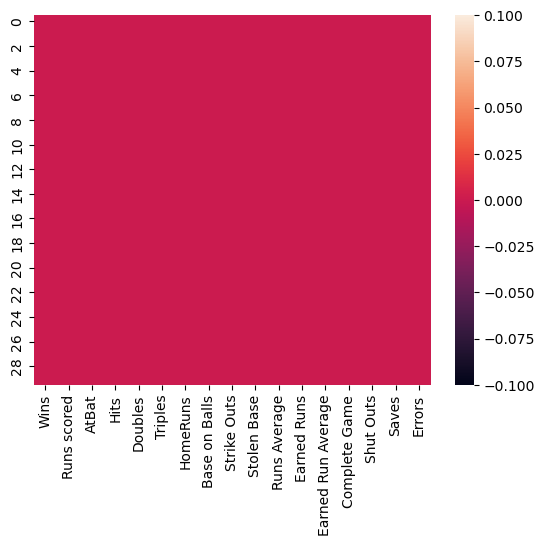

In [45]:
# checking for null values usinh heatmap
sns.heatmap(df.isnull())

from heatmap also we can confirm that there are no null values present in the dataset.

In [46]:
df.nunique()

Wins                  24
Runs scored           28
AtBat                 29
Hits                  29
Doubles               22
Triples               23
HomeRuns              27
Base on Balls         29
Strike Outs           29
Stolen Base           27
Runs Average          30
Earned Runs           30
Earned Run Average    30
Complete Game          9
Shut Outs             12
Saves                 20
Errors                21
dtype: int64

In [47]:
df.dtypes

Wins                    int64
Runs scored             int64
AtBat                   int64
Hits                    int64
Doubles                 int64
Triples                 int64
HomeRuns                int64
Base on Balls           int64
Strike Outs             int64
Stolen Base             int64
Runs Average            int64
Earned Runs             int64
Earned Run Average    float64
Complete Game           int64
Shut Outs               int64
Saves                   int64
Errors                  int64
dtype: object

we can see almost all the columns contains integer datatype only except 'ERA' column.. so we can convert them to float data type

In [48]:
df=df.astype(float)
df

,Wins,Runs scored,AtBat,Hits,Doubles,Triples,HomeRuns,Base on Balls,Strike Outs,Stolen Base,Runs Average,Earned Runs,Earned Run Average,Complete Game,Shut Outs,Saves,Errors
0,95.0,724.0,5575.0,1497.0,300.0,42.0,139.0,383.0,973.0,104.0,641.0,601.0,3.73,2.0,8.0,56.0,88.0
1,83.0,696.0,5467.0,1349.0,277.0,44.0,156.0,439.0,1264.0,70.0,700.0,653.0,4.07,2.0,12.0,45.0,86.0
2,81.0,669.0,5439.0,1395.0,303.0,29.0,141.0,533.0,1157.0,86.0,640.0,584.0,3.67,11.0,10.0,38.0,79.0
3,76.0,622.0,5533.0,1381.0,260.0,27.0,136.0,404.0,1231.0,68.0,701.0,643.0,3.98,7.0,9.0,37.0,101.0
4,74.0,689.0,5605.0,1515.0,289.0,49.0,151.0,455.0,1259.0,83.0,803.0,746.0,4.64,7.0,12.0,35.0,86.0
5,93.0,891.0,5509.0,1480.0,308.0,17.0,232.0,570.0,1151.0,88.0,670.0,609.0,3.80,7.0,10.0,34.0,88.0
6,87.0,764.0,5567.0,1397.0,272.0,19.0,212.0,554.0,1227.0,63.0,698.0,652.0,4.03,3.0,4.0,48.0,93.0
7,81.0,713.0,5485.0,1370.0,246.0,20.0,217.0,418.0,1331.0,44.0,693.0,646.0,4.05,0.0,10.0,43.0,77.0
8,80.0,644.0,5485.0,1383.0,278.0,32.0,167.0,436.0,1310.0,87.0,642.0,604.0,3.74,1.0,12.0,60.0,95.0
9,78.0,748.0,5640.0,1495.0,294.0,33.0,161.0,478.0,1148.0,71.0,753.0,694.0,4.31,3.0,10.0,40.0,97.0


# Description of Dataset

In [49]:
df.describe()

,Wins,Runs scored,AtBat,Hits,Doubles,Triples,HomeRuns,Base on Balls,Strike Outs,Stolen Base,Runs Average,Earned Runs,Earned Run Average,Complete Game,Shut Outs,Saves,Errors
count,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.00000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000
mean,80.966667,688.233333,5516.266667,1403.533333,274.733333,31.300000,163.633333,469.100000,1248.20000,83.500000,688.233333,635.833333,3.956333,3.466667,11.300000,43.066667,94.333333
std,10.453455,58.761754,70.467372,57.140923,18.095405,10.452355,31.823309,57.053725,103.75947,22.815225,72.108005,70.140786,0.454089,2.763473,4.120177,7.869335,13.958889
min,63.000000,573.000000,5385.000000,1324.000000,236.000000,13.000000,100.000000,375.000000,973.00000,44.000000,525.000000,478.000000,2.940000,0.000000,4.000000,28.000000,75.000000
25%,74.000000,651.250000,5464.000000,1363.000000,262.250000,23.000000,140.250000,428.250000,1157.50000,69.000000,636.250000,587.250000,3.682500,1.000000,9.000000,37.250000,86.000000
50%,81.000000,689.000000,5510.000000,1382.500000,275.500000,31.000000,158.500000,473.000000,1261.50000,83.500000,695.500000,644.500000,4.025000,3.000000,12.000000,42.000000,91.000000
75%,87.750000,718.250000,5570.000000,1451.500000,288.750000,39.000000,177.000000,501.250000,1311.50000,96.500000,732.500000,679.250000,4.220000,5.750000,13.000000,46.750000,96.750000
max,100.000000,891.000000,5649.000000,1515.000000,308.000000,49.000000,232.000000,570.000000,1518.00000,134.000000,844.000000,799.000000,5.040000,11.000000,21.000000,62.000000,126.000000


#from the above description we can observ the following things:
1. count of all the columns are same, which means no missing data present in the dataset.
2.in 'w',  '2B','BB','SO','RA','ER','ERA','SHO' columns mean is less than median(50%) , 
so in these columns the data are negatively skewed or left skewed
3.in 'R', '3B','SB' columns the mean value is equal to or nearly equal to the median value.. 
so the data sre normally distributed in these columns
4. and the remaining columns like 'AB','H','HR','CG','SV' contain +vely skewed or right skewed data
5. There is a considerable difference between 75% and the max value.. so there may be chances of outliers present in the dataset

# Data Visualization

### Univariate Analysis:

as all the columns contains numerical continues data only.. we can check the distribution of data in different columns

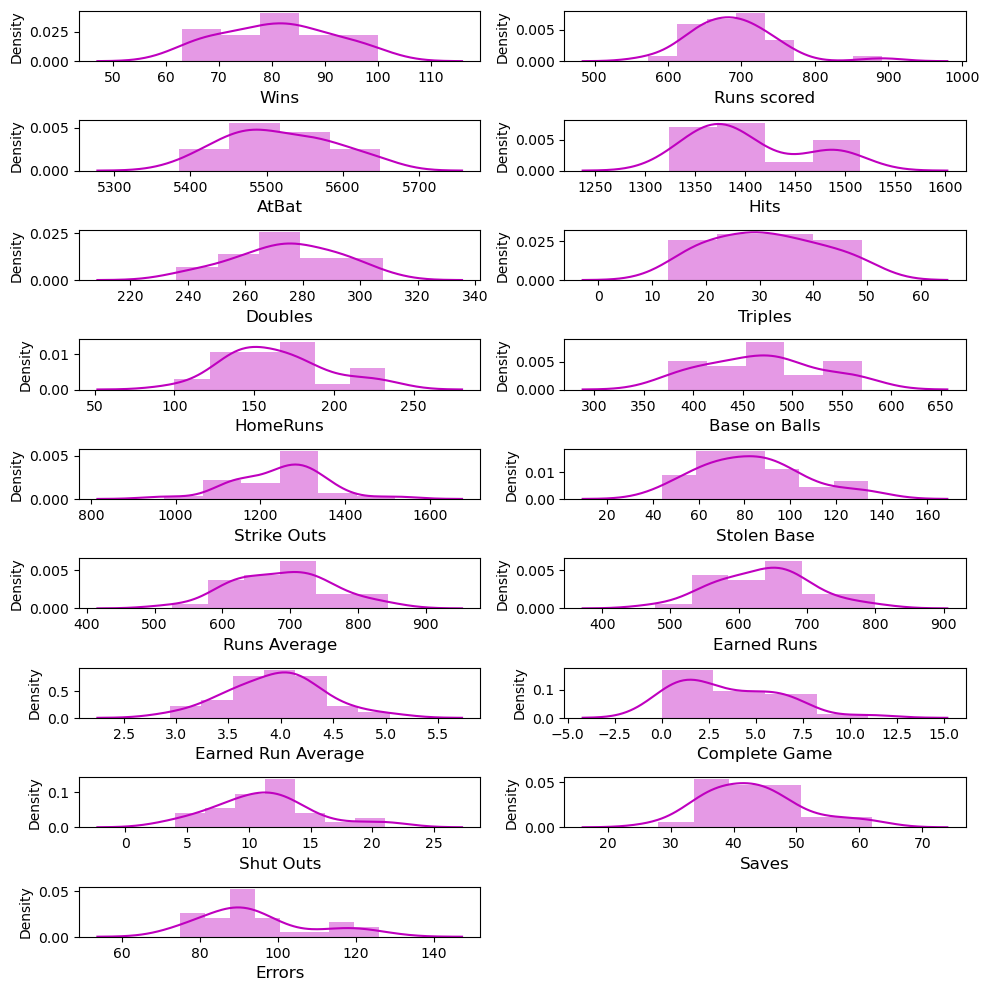

In [12]:
# to check how the data is distributes in columns:
plt.figure(figsize=(10,10),facecolor="white")
plotnum=1
for i in df.columns:
    if plotnum<=18:
        p=plt.subplot(9,2,plotnum)
        sns.distplot(df[i],color="m")
        plt.xlabel(i,fontsize=12)
        plt.yticks(rotation=0,fontsize=10)
    plotnum+=1  
plt.tight_layout()    

from the above distribution plots we can observe the columns that have right skewed data.. some have left skewed data also.

### Bivariate Analysis:


In [13]:
df.columns.tolist()

['Wins',
 'Runs scored',
 'AtBat',
 'Hits',
 'Doubles',
 'Triples',
 'HomeRuns',
 'Base on Balls',
 'Strike Outs',
 'Stolen Base',
 'Runs Average',
 'Earned Runs',
 'Earned Run Average',
 'Complete Game',
 'Shut Outs',
 'Saves',
 'Errors']

<function matplotlib.pyplot.show(close=None, block=None)>

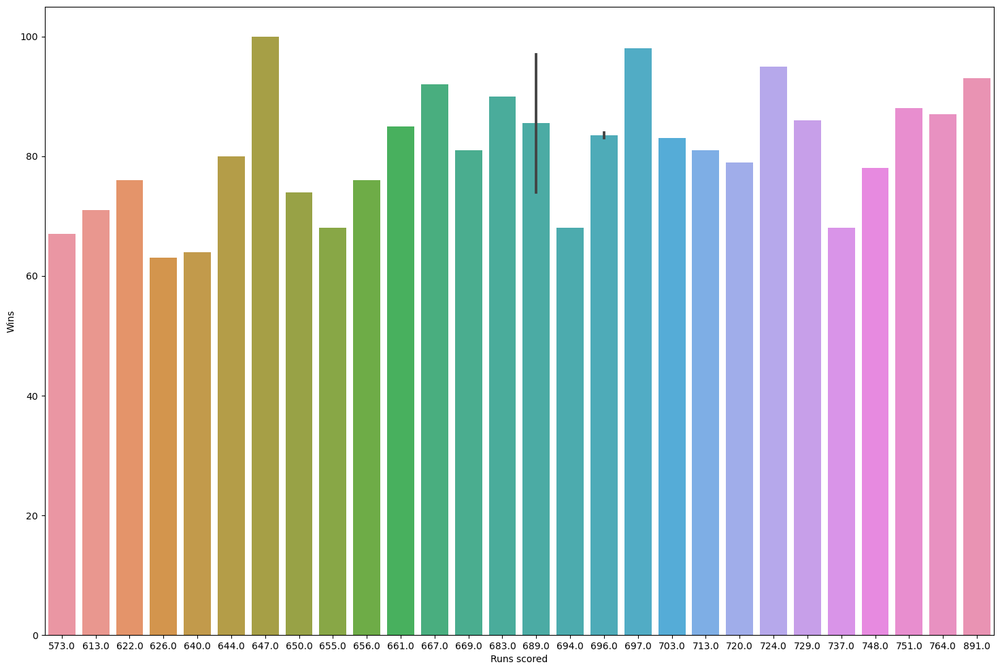

In [14]:
plt.figure(figsize=(18,12))
sns.barplot(x="Runs scored", y="Wins", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

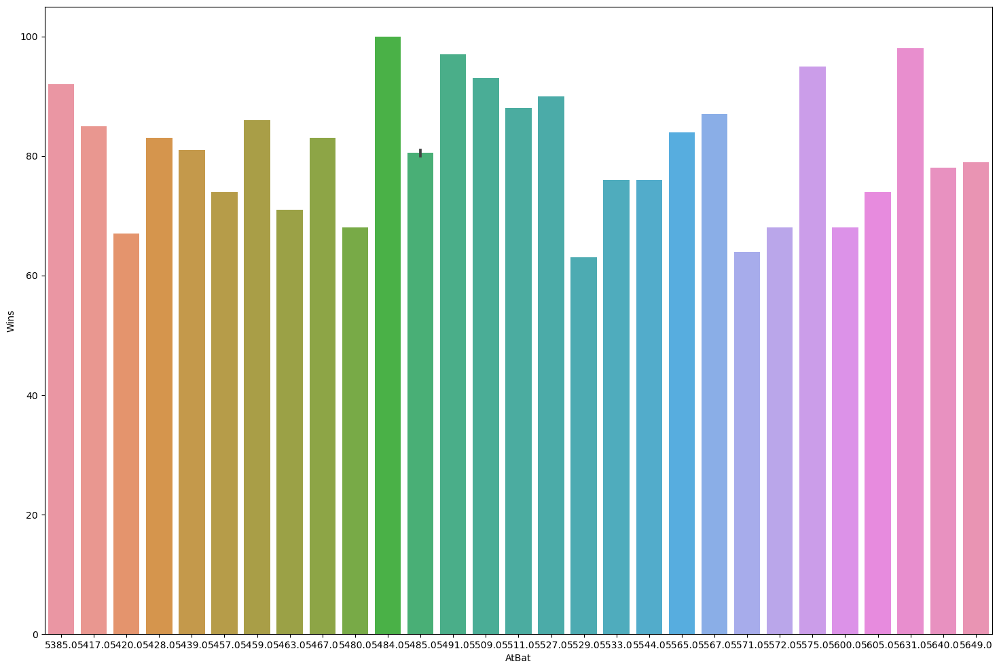

In [15]:
plt.figure(figsize=(18,12))
sns.barplot(x="AtBat", y="Wins", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

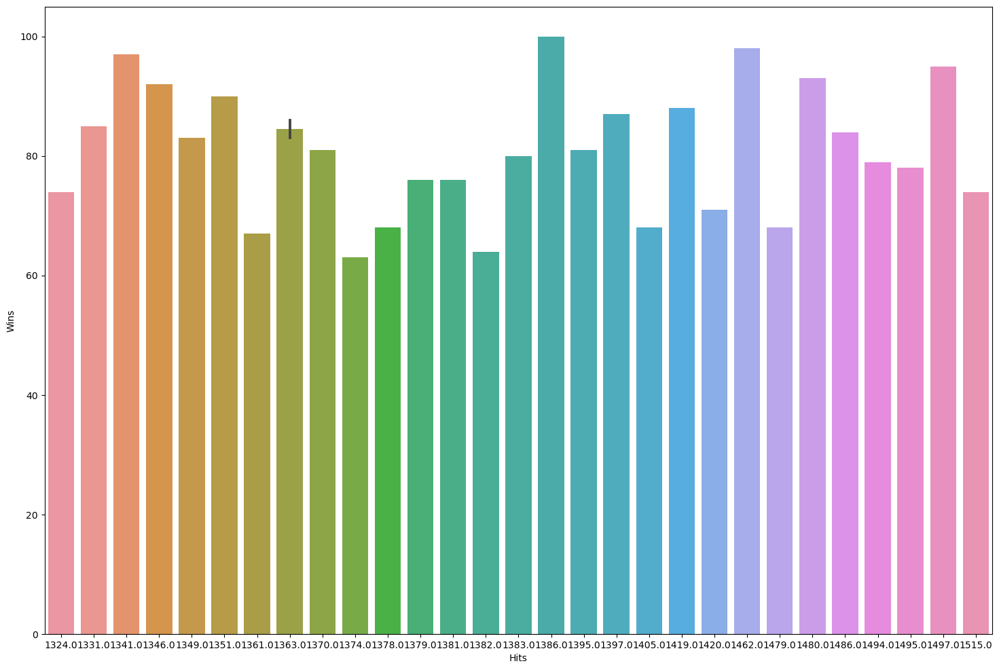

In [16]:
plt.figure(figsize=(18,12))
sns.barplot(x="Hits", y="Wins", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

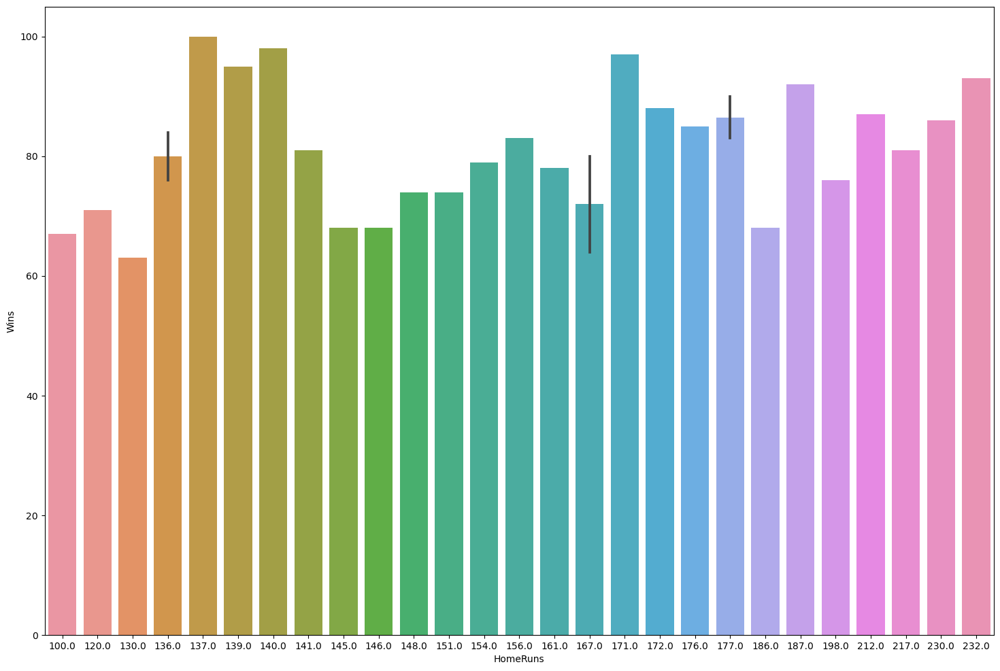

In [17]:
plt.figure(figsize=(18,12))
sns.barplot(x="HomeRuns", y="Wins", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

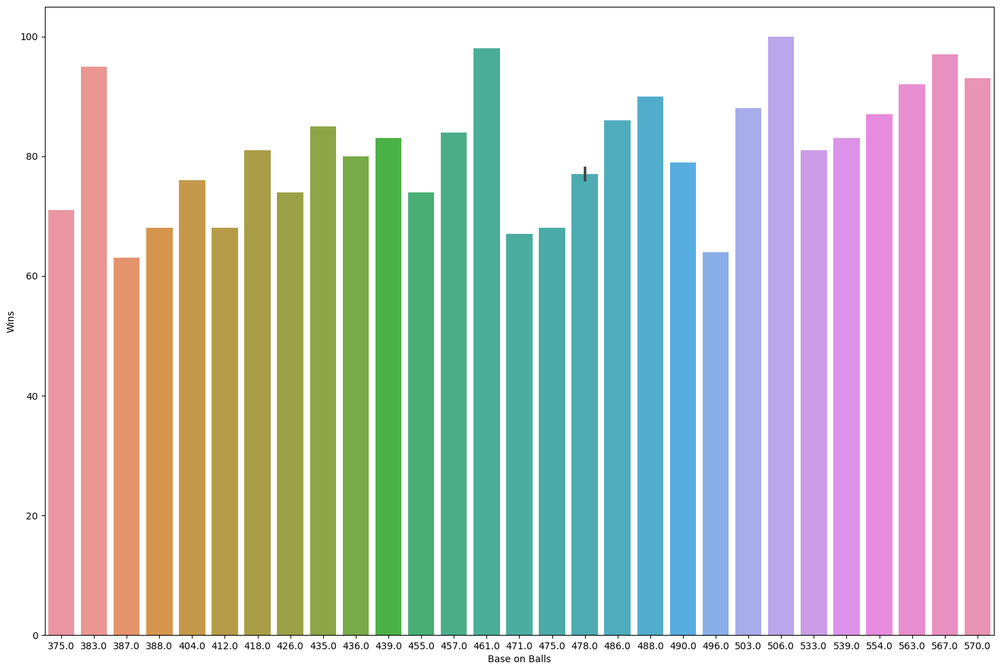

In [18]:
plt.figure(figsize=(18,12))
sns.barplot(x="Base on Balls", y="Wins", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

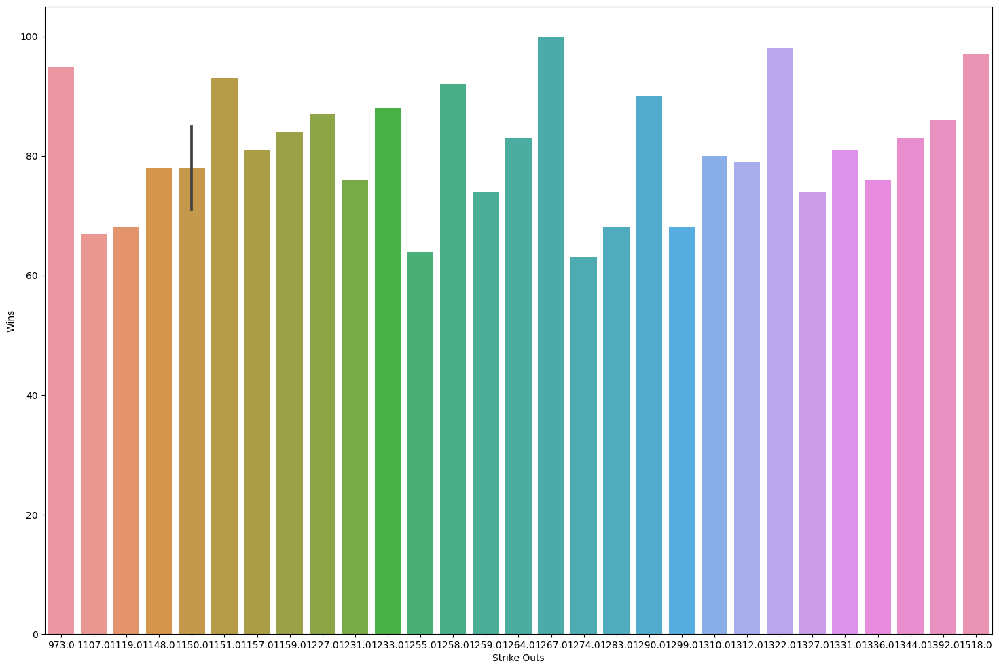

In [19]:
plt.figure(figsize=(18,12))
sns.barplot(x="Strike Outs", y="Wins", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

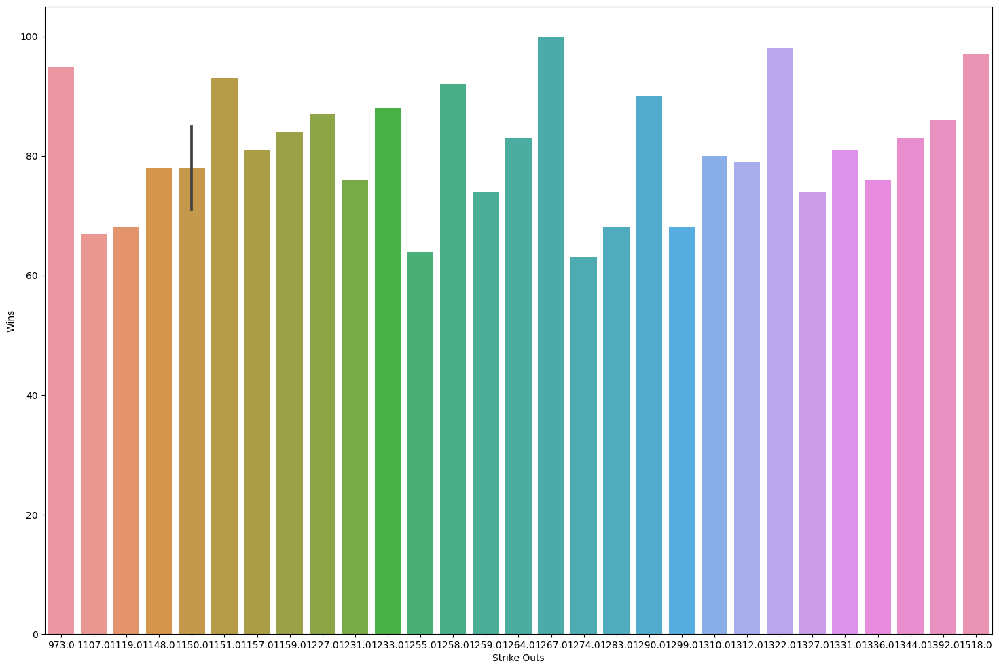

In [20]:
plt.figure(figsize=(18,12))
sns.barplot(x="Strike Outs", y="Wins", data=df)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

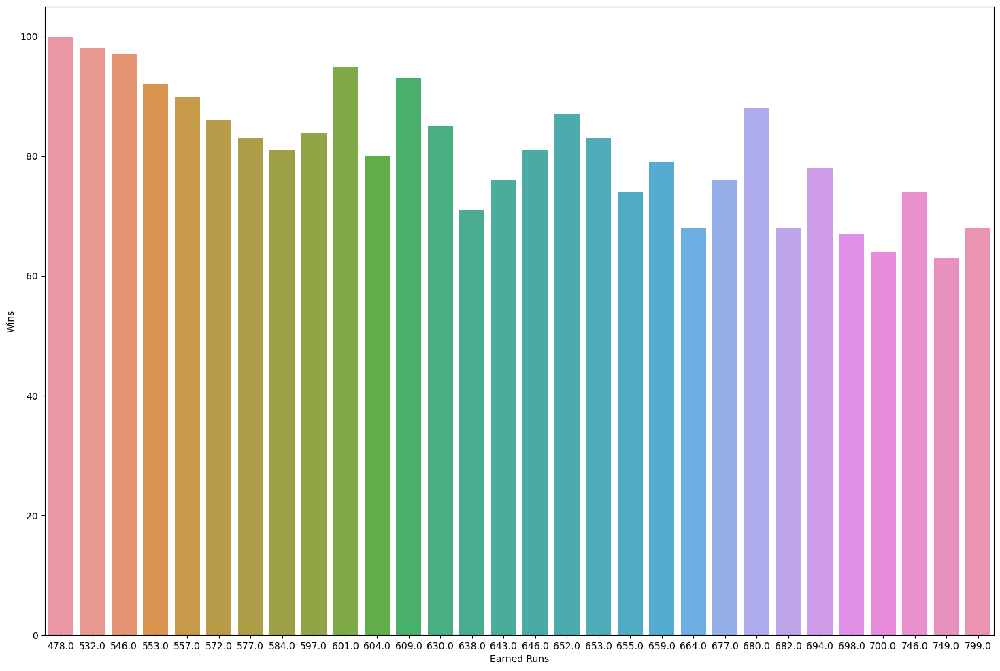

In [21]:
plt.figure(figsize=(18,12))
sns.barplot(x="Earned Runs", y="Wins", data=df)
plt.show

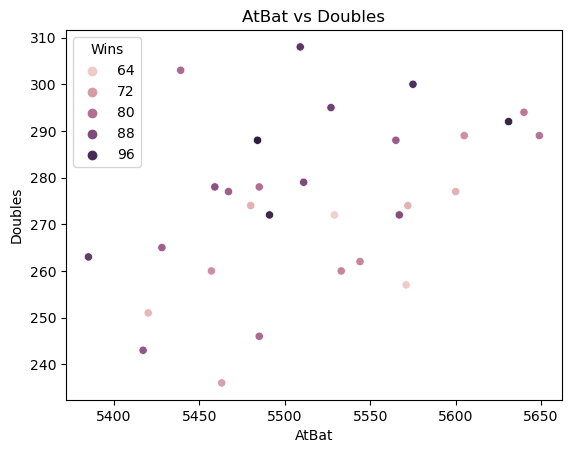

In [22]:
# analysing Atbat scored  and Doubles
plt.title("AtBat vs Doubles")
sns.scatterplot(x="AtBat",y="Doubles",hue='Wins',data=df)
plt.show()


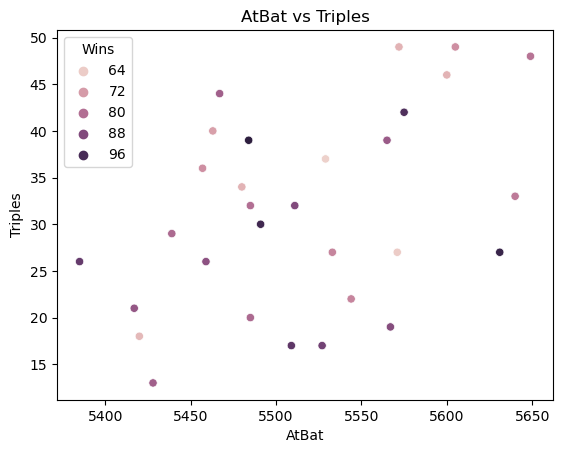

In [23]:
# analysing Atbat scored  and Triples
plt.title("AtBat vs Triples")
sns.scatterplot(x="AtBat",y="Triples",hue='Wins',data=df)
plt.show()

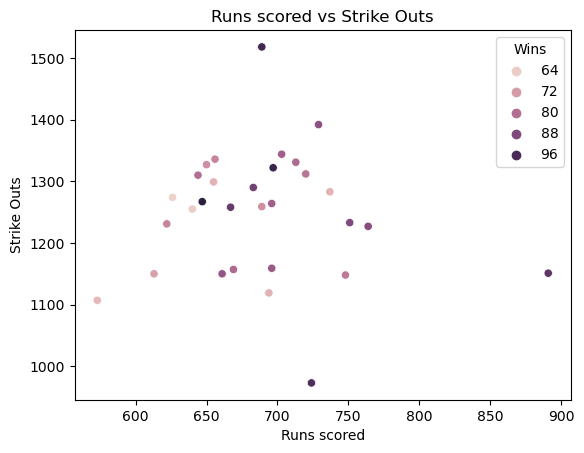

In [24]:
# analysing Runs scored vs Strike outs
plt.title("Runs scored vs Strike Outs")
sns.scatterplot(x="Runs scored",y="Strike Outs",hue='Wins',data=df)
plt.show()

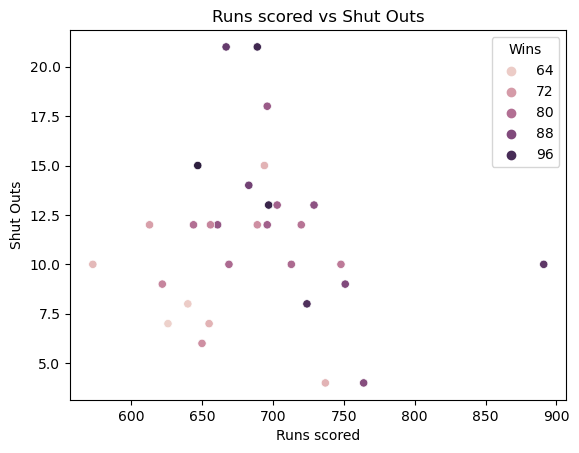

In [25]:
# analysing Runs scored vs Shut Outs
plt.title("Runs scored vs Shut Outs")
sns.scatterplot(x="Runs scored",y="Shut Outs",hue='Wins',data=df)
plt.show()

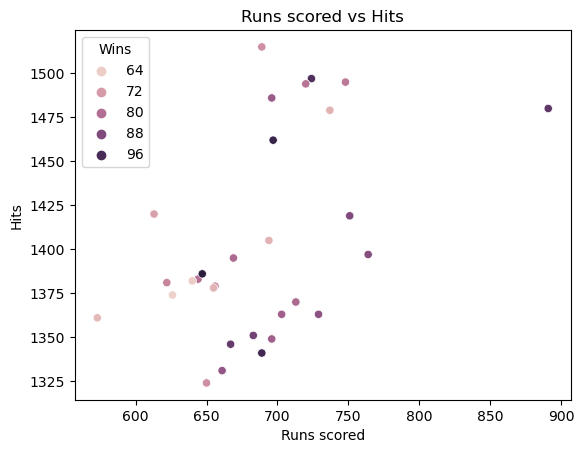

In [26]:
# analysing Runs scored vs Hits
plt.title("Runs scored vs Hits")
sns.scatterplot(x="Runs scored",y="Hits",hue='Wins',data=df)
plt.show()

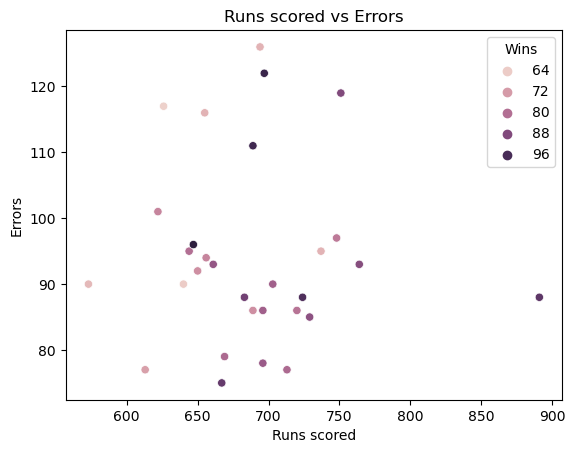

In [27]:
# analysing Runs scored vs Error
plt.title("Runs scored vs Errors")
sns.scatterplot(x="Runs scored",y="Errors",hue='Wins',data=df)
plt.show()

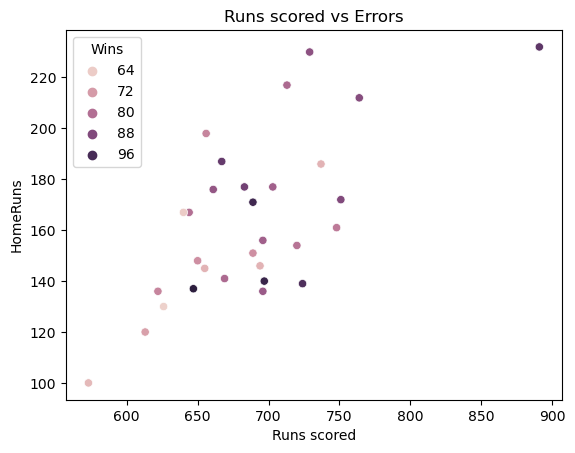

In [28]:
# analysing Runs scored vs Home Runs
plt.title("Runs scored vs Errors")
sns.scatterplot(x="Runs scored",y="HomeRuns",hue='Wins',data=df)
plt.show()

# Multivariate Analysis

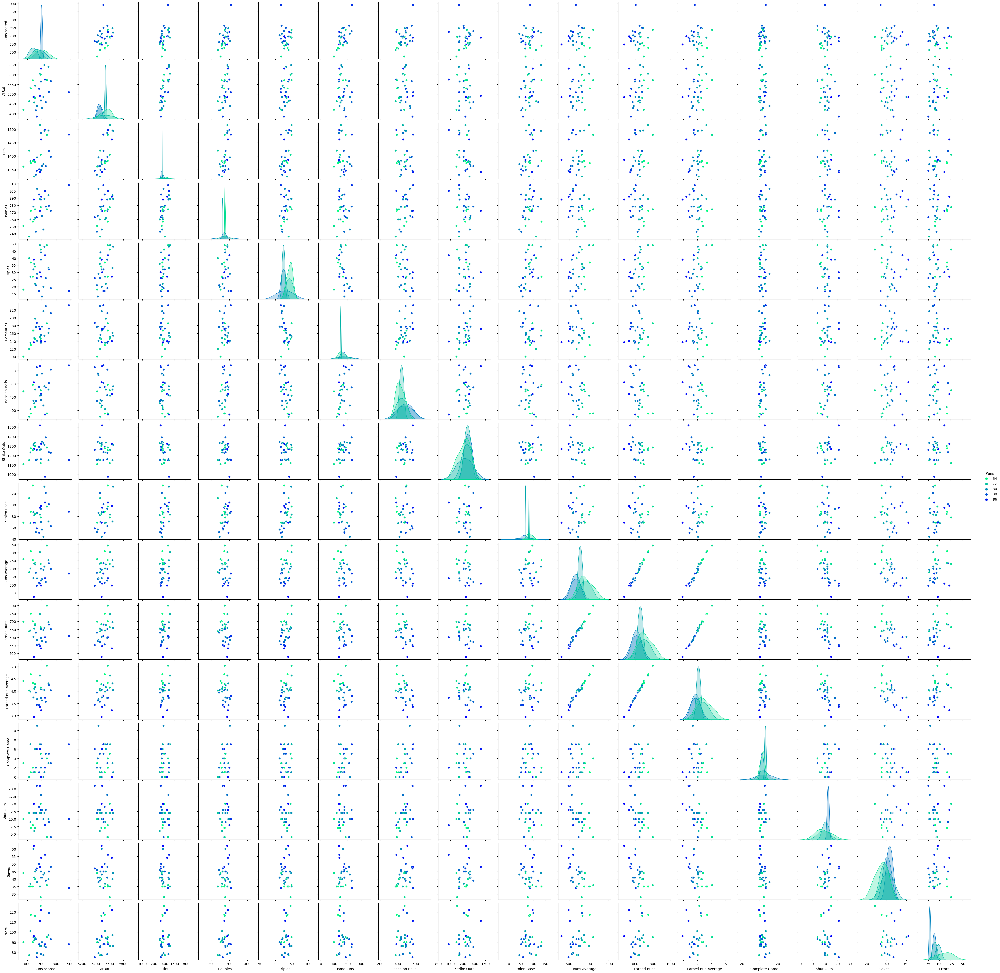

In [29]:
# multivariate amalysis
sns.pairplot(df,hue='Wins',palette='winter_r')
plt.show()

### Feature Engineering

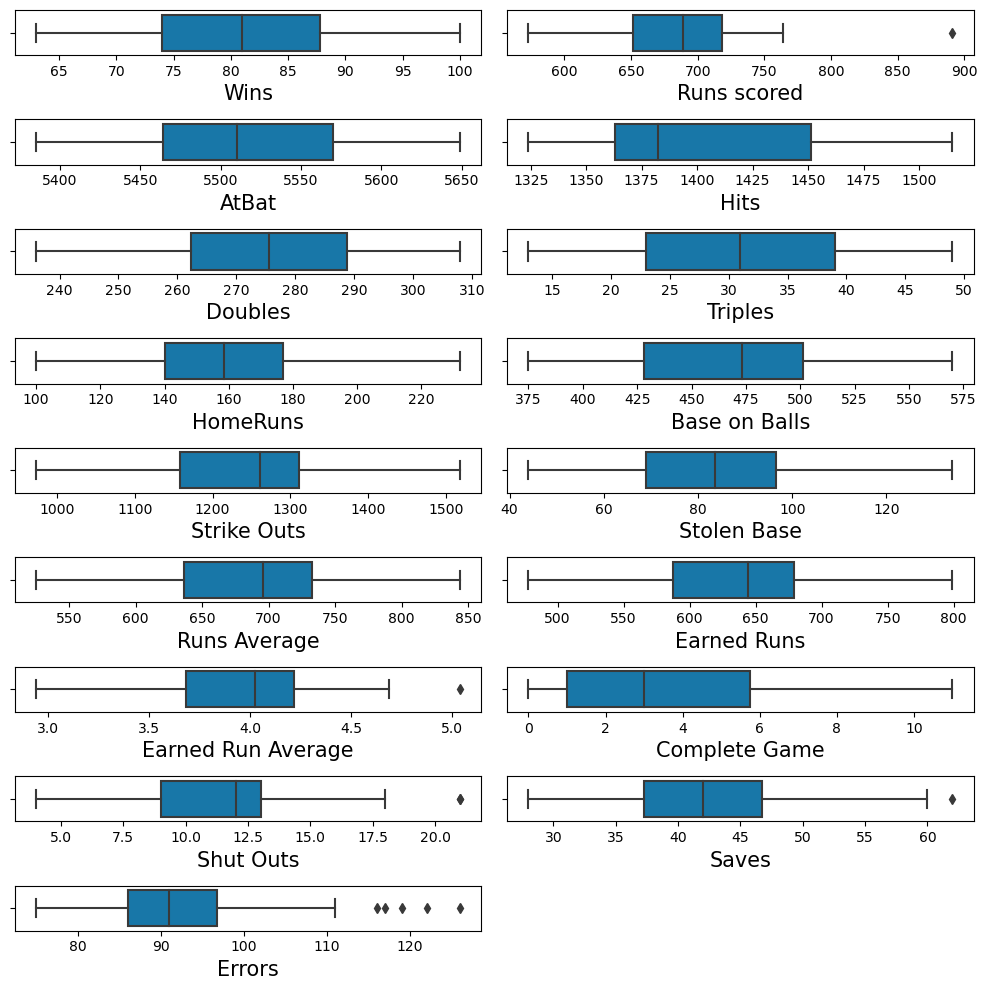

In [50]:
# checking for outliers
plt.figure(figsize=(10,10),facecolor="white")
plotnum=1
for i in df.columns:
    if plotnum<=18:
        p=plt.subplot(9,2,plotnum)
        sns.boxplot(df[i],palette='winter_r')
        plt.xlabel(i,fontsize=15)
        plt.yticks(rotation=0,fontsize=10)
        plotnum+=1
plt.tight_layout()    

from the above box plots we can observe "Runs scored", "Earned Run Average","Shut Outs","Saves" has only one outlier present.. , "Errors" have some outliers but outliers in Errors column is quite possible.. 
We still applied Z score method for improving the performance of the model

In [51]:
#z-score method:
from scipy.stats import zscore
out_features=df[['Runs scored','Earned Run Average','Shut Outs','Saves','Errors']]
z=np.abs(zscore(out_features))
z

,Runs scored,Earned Run Average,Shut Outs,Saves,Errors
0,0.619078,0.506955,0.814629,1.671607,0.461470
1,0.134432,0.254598,0.172800,0.249879,0.607197
2,0.332906,0.641347,0.320914,0.654856,1.117242
3,1.146419,0.053010,0.567771,0.784104,0.485758
4,0.013270,1.531318,0.172800,1.042600,0.607197
5,3.509647,0.350165,0.320914,1.171848,0.461470
6,1.311430,0.165003,1.802057,0.637623,0.097152
7,0.428681,0.209800,0.320914,0.008617,1.262970
8,0.765626,0.484557,0.172800,2.188598,0.048576
9,1.034489,0.792164,0.320914,0.396360,0.194303


In [52]:
#threshold=3
np.where(z>3)

(array([5], dtype=int64), array([0], dtype=int64))

In [53]:
df1=df[(z<3).all(axis=1)]
df1.shape          # after removing outliers the data frame siz

(29, 17)

In [54]:
#originaldata frame size
df.shape

(30, 17)

In [55]:
#data loss percentage:
print("data loss percentage",((df.shape[0]-df1.shape[0])/df.shape[0])*100)

data loss percentage 3.3333333333333335


The data loss percentage is affordable.. so we can proceed

In [56]:
# Checking for Skewness:
df1.skew()

Wins                  0.119013
Runs scored          -0.215364
AtBat                 0.169573
Hits                  0.783772
Doubles              -0.335304
Triples               0.090124
HomeRuns              0.450862
Base on Balls         0.151193
Strike Outs          -0.233815
Stolen Base           0.494966
Runs Average          0.018155
Earned Runs           0.018461
Earned Run Average    0.016693
Complete Game         0.854980
Shut Outs             0.526943
Saves                 0.627480
Errors                0.840271
dtype: float64

In [58]:
from scipy.stats import boxcox
df1['Complete Game']=boxcox(df1['Complete Game'],0.5)
df1['Hits']=boxcox(df1['Hits'],0.5)
df1['Saves']=boxcox(df1['Saves'],0.5)
df1['Shut Outs']=boxcox(df1['Shut Outs'],0.5)
df1['Errors']=boxcox(df1['Errors'],0.5)

In [59]:
df1.skew()

Wins                  0.119013
Runs scored          -0.215364
AtBat                 0.169573
Hits                  0.761274
Doubles              -0.335304
Triples               0.090124
HomeRuns              0.450862
Base on Balls         0.151193
Strike Outs          -0.233815
Stolen Base           0.494966
Runs Average          0.018155
Earned Runs           0.018461
Earned Run Average    0.016693
Complete Game        -0.260678
Shut Outs            -0.085802
Saves                 0.370280
Errors                0.714966
dtype: float64

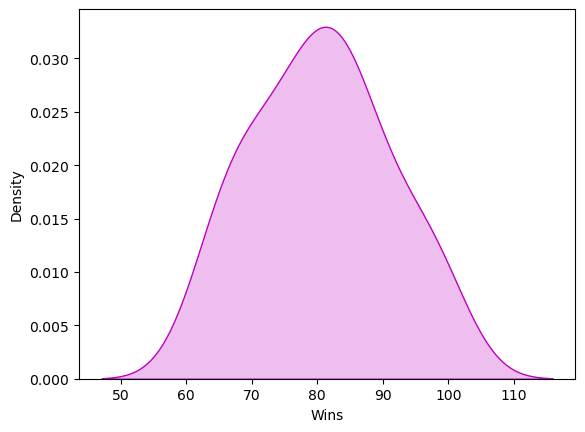

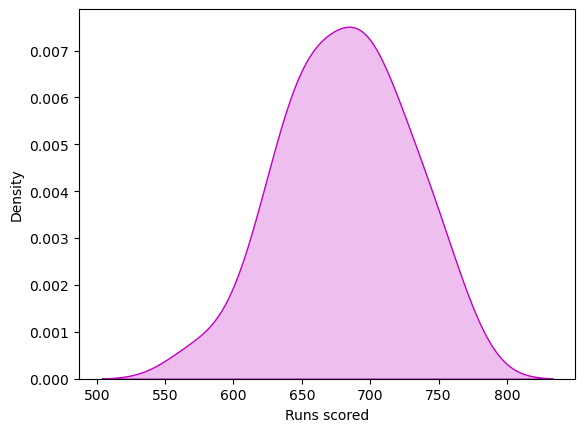

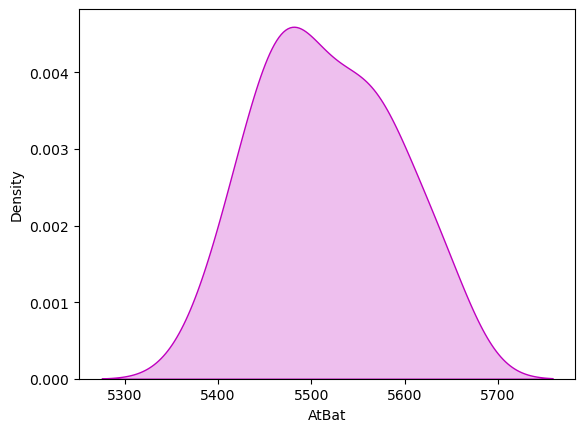

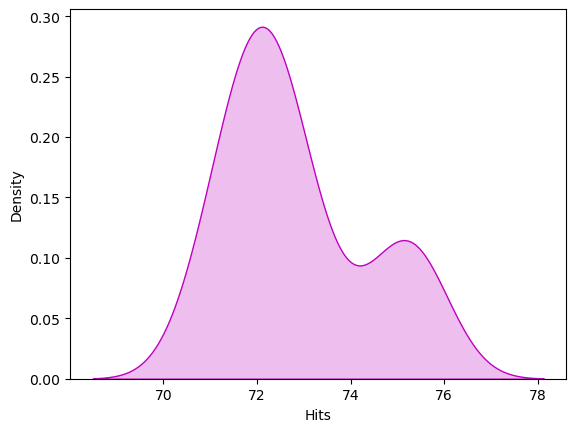

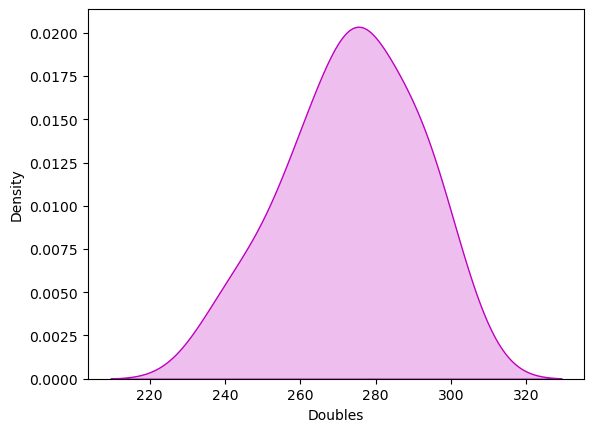

...

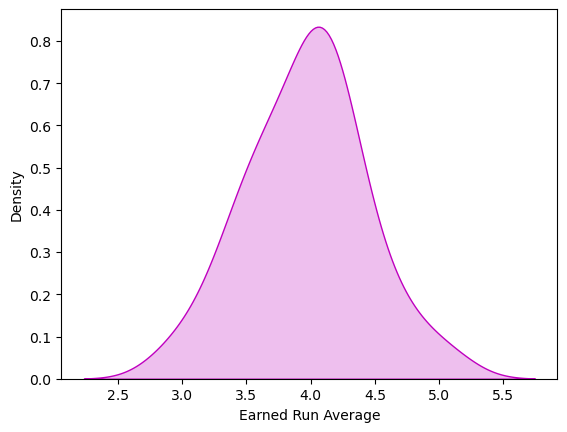

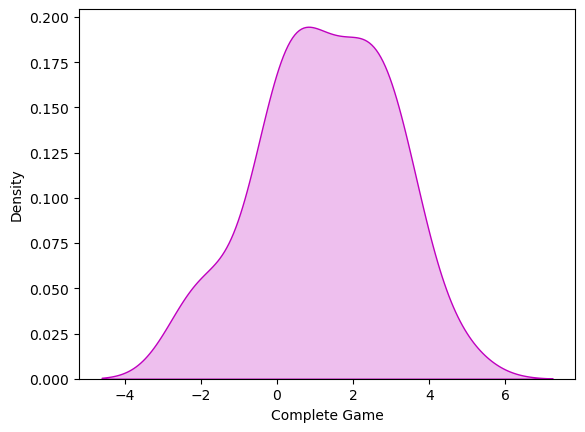

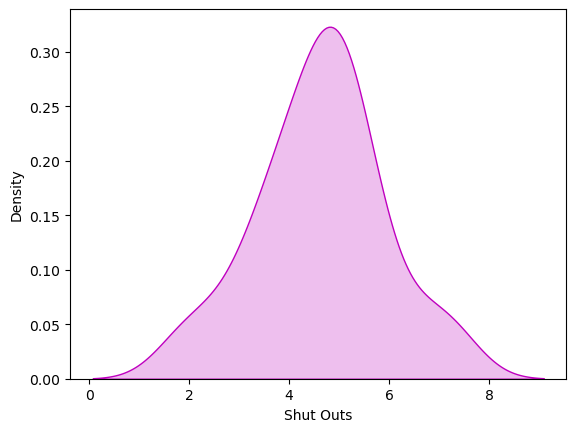

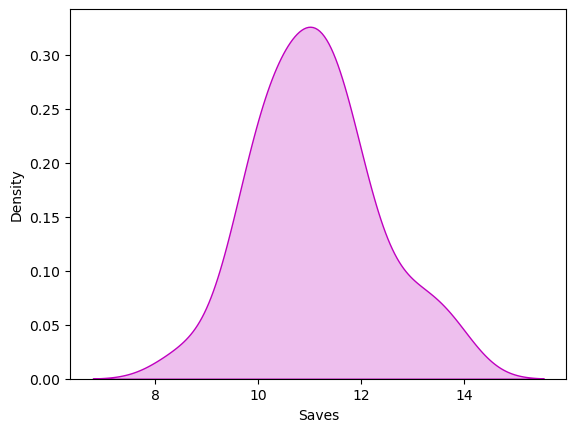

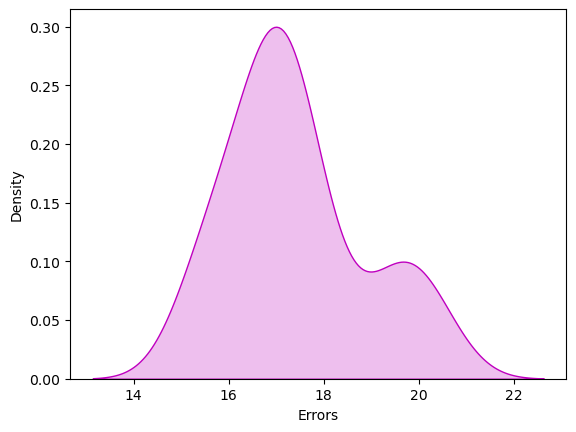

In [60]:
#visualizing the spreading of data
for i in df1.columns:
    sns.distplot(df1[i],color="m",kde_kws={"shade":True},hist=False)
    plt.show()

### correlation between target and input variables:

In [61]:
corr=df1.corr()
corr

,Wins,Runs scored,AtBat,Hits,Doubles,Triples,HomeRuns,Base on Balls,Strike Outs,Stolen Base,Runs Average,Earned Runs,Earned Run Average,Complete Game,Shut Outs,Saves,Errors
Wins,1.000000,0.390451,-0.085780,-0.019562,0.384886,-0.206737,0.245697,0.447513,0.156469,-0.169503,-0.823176,-0.815308,-0.826952,-0.003340,0.477949,0.754886,-0.073904
Runs scored,0.390451,1.000000,0.438022,0.432903,0.469293,0.134204,0.586894,0.258450,0.081158,0.075323,-0.013858,0.007727,-0.009122,0.141559,-0.119300,0.071589,0.042051
AtBat,-0.085780,0.438022,1.000000,0.769684,0.490752,0.445604,-0.064653,-0.137850,-0.111243,0.373674,0.315499,0.309146,0.254872,-0.064516,-0.193987,-0.127766,0.319070
Hits,-0.019562,0.432903,0.769684,1.000000,0.527700,0.580906,-0.218968,-0.222036,-0.372596,0.419058,0.244127,0.280268,0.256176,0.053891,-0.127917,-0.090078,-0.012423
Doubles,0.384886,0.469293,0.490752,0.527700,1.000000,0.342419,-0.098695,0.211243,-0.096772,0.194308,-0.215196,-0.224993,-0.248212,0.256132,0.088345,0.258675,0.145928
Triples,-0.206737,0.134204,0.445604,0.580906,0.342419,1.000000,-0.369299,-0.404852,-0.196586,0.483818,0.312750,0.333731,0.325883,0.009499,-0.067667,-0.236230,0.103521
HomeRuns,0.245697,0.586894,-0.064653,-0.218968,-0.098695,-0.369299,1.000000,0.336814,0.479914,-0.166072,-0.092586,-0.062094,-0.070756,0.103823,-0.030256,0.084263,-0.186196
Base on Balls,0.447513,0.258450,-0.137850,-0.222036,0.211243,-0.404852,0.336814,1.000000,0.315566,-0.117622,-0.425381,-0.455832,-0.465794,0.446861,0.434799,0.197177,-0.051276
Strike Outs,0.156469,0.081158,-0.111243,-0.372596,-0.096772,-0.196586,0.479914,0.315566,1.000000,0.038188,-0.140570,-0.177655,-0.195362,-0.065802,0.200067,0.105667,0.147978
Stolen Base,-0.169503,0.075323,0.373674,0.419058,0.194308,0.483818,-0.166072,-0.117622,0.038188,1.000000,0.134315,0.146243,0.128848,-0.038446,-0.098740,-0.187605,0.080308


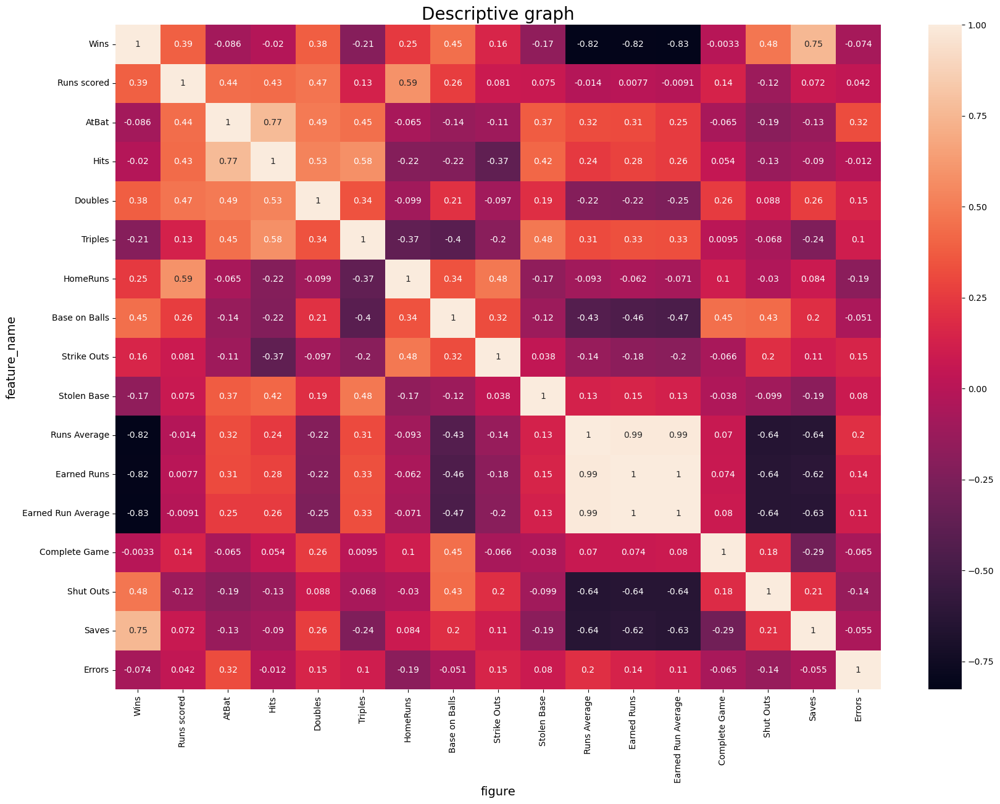

In [62]:
#visualizing corelation using heatmap
plt.figure(figsize=(20,14))
sns.heatmap(df1.corr(),annot=True)
plt.xlabel('figure',fontsize=14)
plt.ylabel('feature_name',fontsize=14)
plt.title('Descriptive graph',fontsize=20)
plt.show()


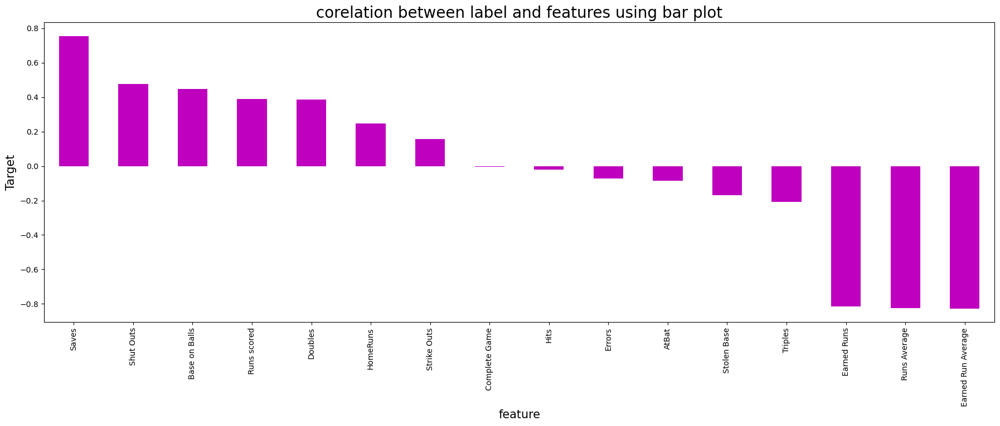

In [63]:
# visualizing the corelation using barplot:
plt.figure(figsize=(22,7))
df1.corr()['Wins'].sort_values(ascending=False).drop(['Wins']).plot(kind='bar',color="m")
plt.xlabel('feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.title("corelation between label and features using bar plot",fontsize=20)
plt.show()


In [64]:
# Variance Inflation Factor to check  multicolinearity:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif= pd.DataFrame()
vif['VIF']= [variance_inflation_factor(df1.values,i) for i in range(df1.shape[1])]
vif['Features']= df1.columns
vif

,VIF,Features
0,1069.200744,Wins
1,2559.186076,Runs scored
2,20440.826662,AtBat
3,21666.010783,Hits
4,1085.377890,Doubles
5,34.360428,Triples
6,266.945666,HomeRuns
7,273.623992,Base on Balls
8,407.710394,Strike Outs
9,28.025607,Stolen Base


In [65]:
#separating target variable and input variable

x=df1.drop('Wins',axis=1)
y=df1['Wins']

In [66]:
# feature scaling using standard scalarization

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,Runs scored,AtBat,Hits,Doubles,Triples,HomeRuns,Base on Balls,Strike Outs,Stolen Base,Runs Average,Earned Runs,Earned Run Average,Complete Game,Shut Outs,Saves,Errors
0,0.959398,0.830084,1.731088,1.556538,1.010845,-0.765863,-1.536359,-2.727623,0.905953,-0.664514,-0.511148,-0.511388,-0.253549,-0.777436,1.602631,-0.454325
1,0.331147,-0.702831,-0.944305,0.201171,1.208917,-0.181389,-0.495021,0.121896,-0.585315,0.154638,0.232161,0.238952,-0.253549,0.247475,0.255621,-0.607619
2,-0.274666,-1.100253,-0.097707,1.733325,-0.276617,-0.697101,1.252941,-0.925866,0.116458,-0.678397,-0.754153,-0.643801,2.020463,-0.239162,-0.689393,-1.158698
3,-1.329231,0.233951,-0.353870,-0.800621,-0.474688,-0.869006,-1.145857,-0.201246,-0.673037,0.168522,0.089217,0.040333,1.218547,-0.500806,-0.831290,0.502274
4,0.174084,1.255894,2.047274,0.908319,1.704094,-0.353293,-0.197495,0.072935,-0.015124,1.584683,1.561540,1.496876,1.218547,0.247475,-1.120956,-0.607619
5,1.856900,0.716535,-0.061217,-0.093474,-1.266972,1.743939,1.643442,-0.240414,-0.892341,0.126870,0.217866,0.150677,0.126372,-2.113126,0.637942,-0.078546
6,0.712585,-0.447345,-0.556053,-1.625627,-1.167936,1.915843,-0.885522,0.777970,-1.725697,0.057451,0.132100,0.194815,-1.944003,-0.239162,-0.006384,-1.320594
7,-0.835605,-0.447345,-0.317196,0.260100,0.020490,0.196801,-0.550807,0.572335,0.160319,-0.650630,-0.468265,-0.489319,-0.748671,0.247475,2.059075,0.068929
8,1.497899,1.752672,1.695839,1.202964,0.119526,-0.009484,0.230197,-1.013995,-0.541454,0.890486,0.818231,0.768604,0.126372,-0.239162,-0.411095,0.214859
9,1.565212,-0.078310,0.338457,0.319029,0.020490,0.368705,0.695081,-0.181661,0.774370,0.612808,0.618110,0.614123,0.728839,-0.500806,0.255621,1.730239


#to avoid multi colinearity problem and Data de-noising we will use Principal Component Analysis (PCA) to the data

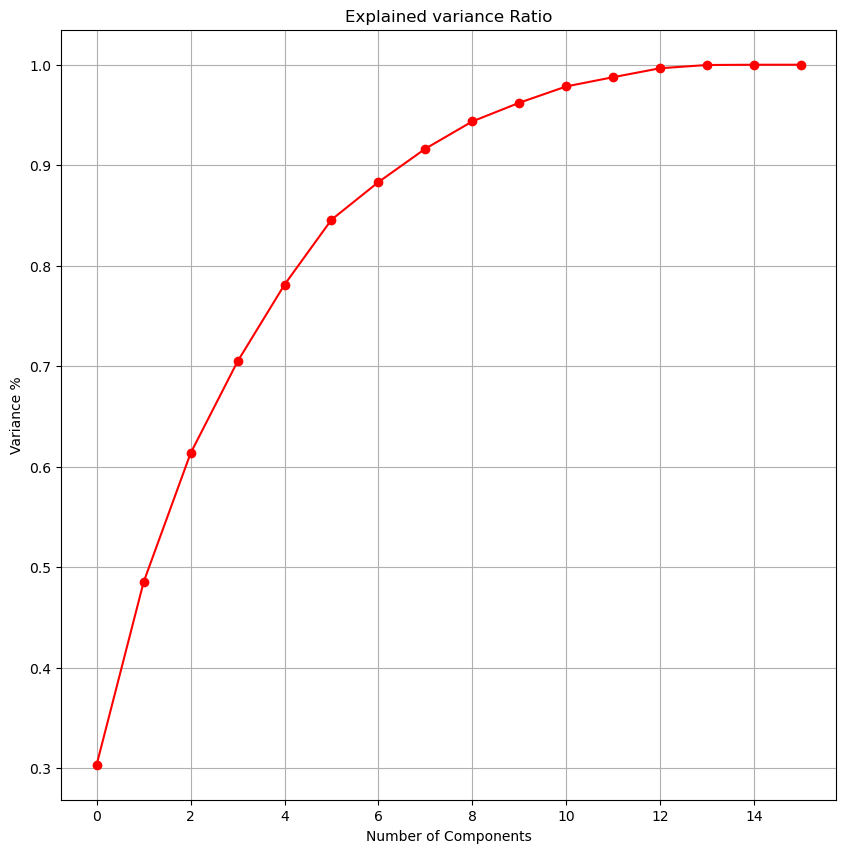

In [67]:
from sklearn.decomposition import PCA
pca = PCA()
#plot the graph to find the principal components
x_pca = pca.fit_transform(x)
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained variance Ratio')
plt.grid()

from the graph we can see the first 9 features can be taken as the major contributing factors for the analysis, so that multicolinearity problem avaoided

In [68]:

pca_new = PCA(n_components=7)
x_new = pca_new.fit_transform(x)

In [69]:
x_new=pd.DataFrame(x_new,columns=np.arange(7))

In [70]:
y

0      95.0
1      83.0
2      81.0
3      76.0
4      74.0
6      87.0
7      81.0
8      80.0
9      78.0
10     88.0
11     86.0
12     85.0
13     76.0
14     68.0
15    100.0
16     98.0
17     97.0
18     68.0
19     64.0
20     90.0
21     83.0
22     71.0
23     67.0
24     63.0
25     92.0
26     84.0
27     79.0
28     74.0
29     68.0
Name: Wins, dtype: float64

we can see the output variable contains continues data.. so we can use Linear Regression model.

# Model Building:

In [71]:
#finding the best random state:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.linear_model import Lasso,Ridge
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import  GradientBoostingRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [72]:
# finding the best Random State:
maxAcc=0
maxRs=0
for i in range(1,1000):
    x_train,x_test,y_train,y_test=train_test_split(x_new,y,test_size=.30,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    acc=r2_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum r2_score is",maxAcc, "on random_state",maxRs)        

maximum r2_score is 0.9356987470840663 on random_state 283


In [73]:
# creating train test split:
x_train,x_test,y_train,y_test=train_test_split(x_new,y,test_size=.30,random_state=maxRs)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(20, 7)
(20,)
(9, 7)
(9,)


In [74]:
LR=LinearRegression()
LR.fit(x_train,y_train)
pred_lr=LR.predict(x_test)
pred_train=LR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_lr))
print('r2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_lr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_lr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_lr)))

r2_score: 0.9356987470840663
r2_score on training Data: 81.35701989781698
mean absolute error: 2.170429277728663
Mean Squared Error:- 6.927070777091818
Root Mean Squrared Error:- 2.63193289752832


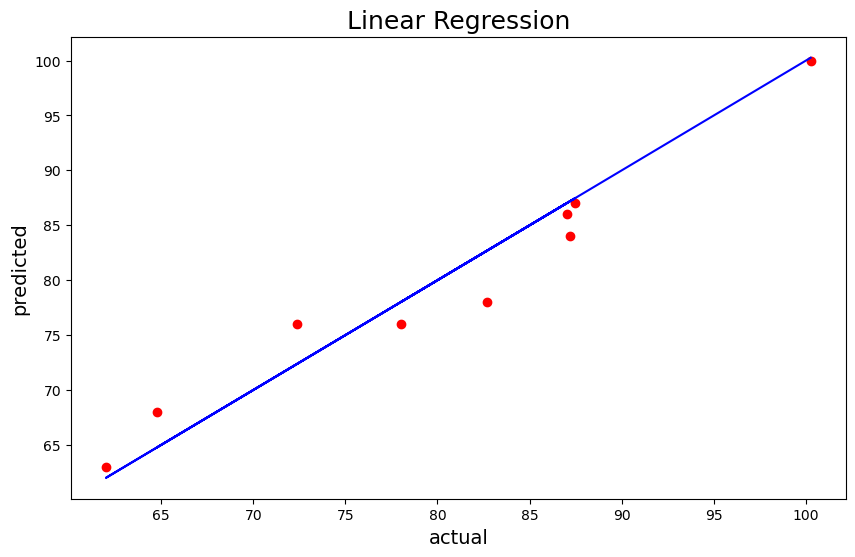

In [75]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_lr,y=y_test,color="r")
plt.plot(pred_lr,pred_lr,color="b")
plt.xlabel('actual',fontsize=14)
plt.ylabel('predicted',fontsize=14)
plt.title("Linear Regression",fontsize=18)
plt.show()

In [76]:
# Random Forest model:
RFR=RandomForestRegressor()
RFR.fit(x_train,y_train)
pred_RFR=RFR.predict(x_test)
pred_train=RFR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_RFR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_RFR))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_RFR))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_RFR)))

r2_score: 0.7052246275498509
R2_score on training Data: 89.37351356646097
mean absolute error: 4.525555555555556
Mean Squared Error:- 31.75567777777778
Root Mean Squrared Error:- 5.635217633577055


In [77]:
# KNN
knn=KNN()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
pred_train=knn.predict(x_train)
print('r2_score:',r2_score(y_test,pred_knn))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_knn))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_knn))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_knn)))

r2_score: 0.7527526931010774
R2_score on training Data: 52.62415515721421
mean absolute error: 3.977777777777776
Mean Squared Error:- 26.635555555555538
Root Mean Squrared Error:- 5.160964595456506


In [78]:
# GBR
GBR=GradientBoostingRegressor()
GBR.fit(x_train,y_train)
pred_GBR=GBR.predict(x_test)
pred_train=GBR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_GBR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_GBR))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_GBR))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_GBR)))

r2_score: 0.818533484468695
R2_score on training Data: 99.99996314829994
mean absolute error: 3.764024764190184
Mean Squared Error:- 19.549096475631696
Root Mean Squrared Error:- 4.421436019624359


In [79]:
#Lasso
lasso=Lasso()
lasso.fit(x_train,y_train)
pred_lasso=lasso.predict(x_test)
pred_train=lasso.predict(x_train)
print('r2_score:',r2_score(y_test,pred_lasso))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_lasso))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_lasso))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_lasso)))

r2_score: 0.9483674698552846
R2_score on training Data: 78.55097444355826
mean absolute error: 2.2079791521831535
Mean Squared Error:- 5.562289605466497
Root Mean Squrared Error:- 2.3584506790404793


In [80]:
#Ridge:
ridge=Ridge()
ridge.fit(x_train,y_train)
pred_ridge=ridge.predict(x_test)
pred_train=ridge.predict(x_train)
print('r2_score:',r2_score(y_test,pred_ridge))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_ridge))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_ridge))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_ridge)))

r2_score: 0.9410121104749425
R2_score on training Data: 81.33001190498528
mean absolute error: 2.0235292801456364
Mean Squared Error:- 6.354670666612987
Root Mean Squrared Error:- 2.5208472120723595


In [81]:
#etr
from sklearn.ensemble import ExtraTreesRegressor
etr=ExtraTreesRegressor()
etr.fit(x_train,y_train)
pred_etr=etr.predict(x_test)
pred_train=etr.predict(x_train)
print('r2_score:',r2_score(y_test,pred_etr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_etr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_etr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_etr)))


r2_score: 0.6859461035984415
R2_score on training Data: 100.0
mean absolute error: 4.556666666666666
Mean Squared Error:- 33.8325222222222
Root Mean Squrared Error:- 5.816573065149462


# Cross Validating the models:

In [82]:
from sklearn.model_selection import cross_val_score

In [83]:
scoreLR=cross_val_score(LR,x_new,y,cv=4,scoring='r2')             #CROSS VALIDATION FOR LINEAR REGRESSOR
print(scoreLR)
print(scoreLR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_lr)-scoreLR.mean())*100)

[0.33454979 0.58585273 0.80941679 0.91575853]
0.6613944571320173
difference between r2 score and cross validation score is: 27.430428995204903


In [84]:
scoreRFR=cross_val_score(RFR,x_new,y,cv=4,scoring='r2')        #CROSS VALIDATION FOR RANDOM FOREST
print(scoreRFR)
print(scoreRFR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_RFR)-scoreRFR.mean())*100)

[-0.25250818  0.61784952  0.33386178  0.32415762]
0.255840183722562
difference between r2 score and cross validation score is: 44.93844438272889


In [85]:
scoreknn=cross_val_score(knn,x_new,y,cv=4,scoring='r2')            # CROSS VALIDATION FOR KNN
print(scoreknn)
print(scoreknn.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_knn)-scoreknn.mean())*100)

[0.19660989 0.54645367 0.49937349 0.58702487]
0.45736548067739013
difference between r2 score and cross validation score is: 29.538721242368727


In [86]:
scoreGBR=cross_val_score(GBR,x_new,y,cv=4,scoring='r2')             #cross validation for gbr
print(scoreGBR)
print(scoreGBR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_GBR)-scoreGBR.mean())*100)

[-0.97415146  0.61033231  0.66702647  0.08760253]
0.09770246325041432
difference between r2 score and cross validation score is: 72.08310212182806


In [87]:
scoreL=cross_val_score(lasso,x_new,y,cv=4,scoring='r2')            #cross validation for lasso
print(scoreL) 
print(scoreL.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_lasso)-scoreL.mean())*100)

[0.19510745 0.67360123 0.77627985 0.92394527]
0.6422334489964384
difference between r2 score and cross validation score is: 30.613402085884623


In [88]:
scoreR=cross_val_score(ridge,x_new,y,cv=4,scoring='r2')          #cross validation for ridge
print(scoreR)
print(scoreR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_ridge)-scoreR.mean())*100)

[0.34499981 0.6000143  0.8071067  0.92374584]
0.6689666610706464
difference between r2 score and cross validation score is: 27.20454494042961


In [89]:
scoreETR=cross_val_score(etr,x_new,y,cv=4,scoring='r2')             #cross validation for ETR
print(scoreETR)
print(scoreETR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_etr)-scoreETR.mean())*100)

[-0.01421886  0.62561438  0.44014177  0.55775915]
0.40232410846303557
difference between r2 score and cross validation score is: 28.3621995135406


From varifying cross validation score we can conclude that Lasso Regression model performs better for the given problem statement

In [98]:
from sklearn.model_selection import GridSearchCV
parameter = {
    'alpha':[.00001, 0.0001,0.001, 0.01],
    'fit_intercept':[True,False],
    'normalize':[True,False],
    'positive':[True,False],
    'selection':['cyclic','random'],
    }

GCV=GridSearchCV(Lasso(),parameter,cv=4)
GCV.fit(x_train,y_train)


GridSearchCV(cv=4, estimator=Lasso(),
             param_grid={'alpha': [1e-05, 0.0001, 0.001, 0.01],
                         'fit_intercept': [True, False],
                         'normalize': [True, False], 'positive': [True, False],
                         'selection': ['cyclic', 'random']})

In [99]:
GCV.best_params_

{'alpha': 0.01,
 'fit_intercept': True,
 'normalize': True,
 'positive': False,
 'selection': 'random'}

In [102]:
model=Lasso(alpha=0.01,fit_intercept=True,normalize=True,positive=False,selection='random')

# Final Model

In [103]:
model.fit(x_train,y_train)
pred=model.predict(x_test)
acc=r2_score(y_test,pred)
print(acc*100)

93.87228850558454


### the final model is working with 93.87% accuracy

In [106]:
#saving the model: using joblib:
import joblib
joblib.dump(model,"BaseBall Analysis")

['BaseBall Analysis']

In [109]:
#predicting the saved model:
lassom=joblib.load("BaseBall Analysis")
prediction=lassom.predict(x_test)
prediction

array([100.20284502,  64.71630908,  87.03872172,  72.45528032,
        62.1529688 ,  82.47859212,  87.1770375 ,  77.95722421,
        87.21037327])

In [110]:
a=np.array(y_test)
dfBaseball=pd.DataFrame()
dfBaseball['predicted']=prediction
dfBaseball['original']=a
dfBaseball

,predicted,original
0,100.202845,100.0
1,64.716309,68.0
2,87.038722,86.0
3,72.455280,76.0
4,62.152969,63.0
5,82.478592,78.0
6,87.177038,87.0
7,77.957224,76.0
8,87.210373,84.0


# Project 2: Avocado Project

# Project Descrfiption:

This data was downloaded from the Hass Avocado Board website in May of 2018 & compiled into a single CSV. 
The table below represents weekly 2018 retail scan data for National retail volume (units) and price. Retail scan data comes directly from retailers’ cash registers based on actual retail sales of Hass avocados. 
Starting in 2013, the table below reflects an expanded, multi-outlet retail data set. Multi-outlet reporting includes an aggregation of the following channels: grocery, mass, club, drug, dollar and military. The Average Price (of avocados) in the table reflects a per unit (per avocado) cost, even when multiple units (avocados) are sold in bags. 
The Product Lookup codes (PLU’s) in the table are only for Hass avocados. Other varieties of avocados (e.g. greenskins) are not included in this table.
Some relevant columns in the dataset:
•	Date - The date of the observation
•	AveragePrice - the average price of a single avocado
•	type - conventional or organic
•	year - the year
•	Region - the city or region of the observation
•	Total Volume - Total number of avocados sold
•	4046 - Total number of avocados with PLU 4046 sold
•	4225 - Total number of avocados with PLU 4225 sold
•	4770 - Total number of avocados with PLU 4770 sold



#### Here the problem statement can be viewed in two different ways such as predicting the "AveragePrice" and "Region"

In [91]:
dfav=pd.read_csv('avocado.csv')
dfav

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,0.0,27-12-2015,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015.0,Albany
1,1.0,20-12-2015,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015.0,Albany
2,2.0,13-12-2015,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015.0,Albany
3,3.0,06-12-2015,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015.0,Albany
4,4.0,29-11-2015,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015.0,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16463,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16464,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16465,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [92]:
dfav.drop('Unnamed: 0',axis=1,inplace=True)
dfav

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,27-12-2015,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015.0,Albany
1,20-12-2015,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015.0,Albany
2,13-12-2015,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015.0,Albany
3,06-12-2015,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015.0,Albany
4,29-11-2015,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015.0,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...
16463,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16464,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16465,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [93]:
dfav.head()

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,27-12-2015,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015.0,Albany
1,20-12-2015,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015.0,Albany
2,13-12-2015,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015.0,Albany
3,06-12-2015,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015.0,Albany
4,29-11-2015,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015.0,Albany


In [94]:
dfav.tail()

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
16463,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16464,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16465,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# EDA

In [95]:
dfav.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16468 entries, 0 to 16467
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Date          1517 non-null   object 
 1   AveragePrice  1517 non-null   float64
 2   Total Volume  1517 non-null   float64
 3   4046          1517 non-null   float64
 4   4225          1517 non-null   float64
 5   4770          1517 non-null   float64
 6   Total Bags    1517 non-null   float64
 7   Small Bags    1517 non-null   float64
 8   Large Bags    1517 non-null   float64
 9   XLarge Bags   1517 non-null   float64
 10  type          1517 non-null   object 
 11  year          1517 non-null   float64
 12  region        1517 non-null   object 
dtypes: float64(10), object(3)
memory usage: 1.6+ MB


In [96]:
dfav.shape

(16468, 13)

seems the dataset contains so many null values.

In [97]:
#checking for null values
dfav.isnull().sum()

Date            14951
AveragePrice    14951
Total Volume    14951
4046            14951
4225            14951
4770            14951
Total Bags      14951
Small Bags      14951
Large Bags      14951
XLarge Bags     14951
type            14951
year            14951
region          14951
dtype: int64

<AxesSubplot:>

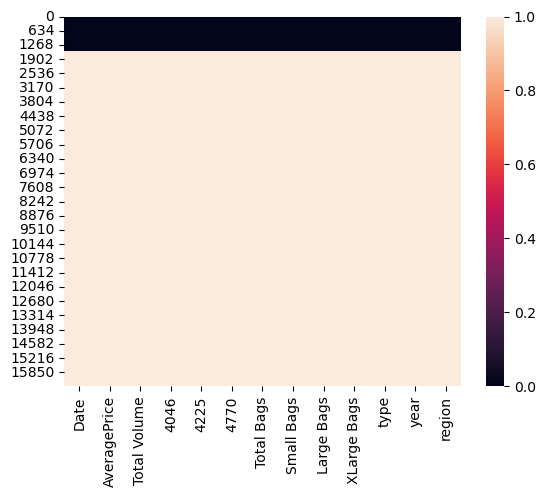

In [98]:
#visualizing null values using heatmap
sns.heatmap(dfav.isnull())

 the data set contains huge number of null values present in it.

In [99]:
dfav.dropna(inplace=True)

In [100]:
dfav

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,27-12-2015,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.00,conventional,2015.0,Albany
1,20-12-2015,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.00,conventional,2015.0,Albany
2,13-12-2015,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.00,conventional,2015.0,Albany
3,06-12-2015,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.00,conventional,2015.0,Albany
4,29-11-2015,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.00,conventional,2015.0,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1512,16-10-2016,1.39,190846.01,57529.11,56366.66,17531.78,59418.46,48823.53,10354.65,240.28,conventional,2016.0,Charlotte
1513,09-10-2016,1.51,178235.75,43325.87,52189.61,19419.57,63300.70,54704.14,8596.56,0.00,conventional,2016.0,Charlotte
1514,02-10-2016,1.48,178410.82,46364.75,52893.38,16736.92,62415.77,53332.61,8258.16,825.00,conventional,2016.0,Charlotte
1515,25-09-2016,1.47,189131.52,54110.79,53593.58,17495.42,63931.73,55653.47,8278.26,0.00,conventional,2016.0,Charlotte


In [101]:
dfav.shape

(1517, 13)

<AxesSubplot:>

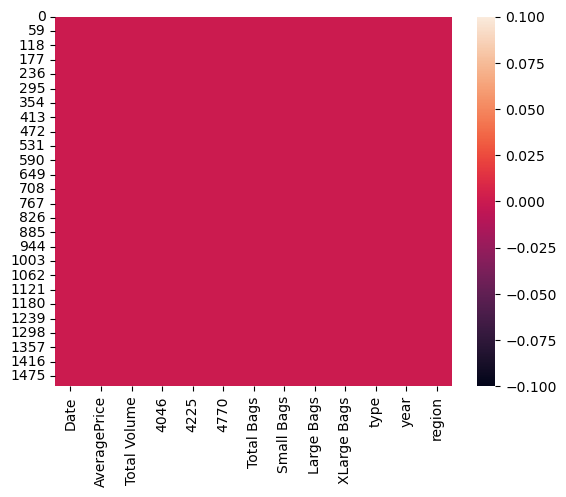

In [102]:
# visualizing heatmap after dropping null values
sns.heatmap(dfav.isnull())

In [103]:
dfav.dtypes

Date             object
AveragePrice    float64
Total Volume    float64
4046            float64
4225            float64
4770            float64
Total Bags      float64
Small Bags      float64
Large Bags      float64
XLarge Bags     float64
type             object
year            float64
region           object
dtype: object

In [104]:
#converting date column data type to datetime format:
#dfav['Date']=pd.to_datetime(dfav.Date)

In [105]:
#dfav['Date'].dtype

In [106]:
#numerical columns:
numeric_col=[]
for i in dfav.dtypes.index:
    if dfav.dtypes[i]!="object":
        numeric_col.append(i)
print("numerical column:",numeric_col)        

numerical column: ['AveragePrice', 'Total Volume', '4046', '4225', '4770', 'Total Bags', 'Small Bags', 'Large Bags', 'XLarge Bags', 'year']


In [107]:
#Categorical Columns:
categorical_col=[]
for i in dfav.dtypes.index:
    if dfav.dtypes[i]=="object":
        categorical_col.append(i)
print("categorical columns:",categorical_col)    

categorical columns: ['Date', 'type', 'region']


In [108]:
#Statistical Summery:
dfav.describe()

,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,year
count,1517.000000,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1517.000000,1517.000000
mean,1.074990,1.601879e+06,6.464387e+05,6.114375e+05,5.040550e+04,2.935974e+05,2.487736e+05,4.264205e+04,2181.771074,2015.162821
std,0.188891,4.433143e+06,1.947614e+06,1.672906e+06,1.377812e+05,7.579765e+05,6.474765e+05,1.182157e+05,7455.712144,0.369324
min,0.490000,3.875074e+04,4.677200e+02,1.783770e+03,0.000000e+00,3.311770e+03,3.311770e+03,0.000000e+00,0.000000,2015.000000
25%,0.980000,1.474700e+05,2.040034e+04,4.147606e+04,9.112500e+02,3.620689e+04,2.972722e+04,5.407400e+02,0.000000,2015.000000
50%,1.080000,4.027919e+05,8.175117e+04,1.186649e+05,7.688170e+03,7.397906e+04,6.237569e+04,5.044350e+03,0.000000,2015.000000
75%,1.190000,9.819751e+05,3.775785e+05,4.851503e+05,2.916730e+04,1.576097e+05,1.461994e+05,2.926767e+04,401.480000,2015.000000
max,1.680000,4.465546e+07,1.893304e+07,1.895648e+07,1.381516e+06,6.736304e+06,5.893642e+06,1.121076e+06,108072.790000,2016.000000


#observations:
1. in 'Total Volume','4046','4770','Total Bags','Small Bags','Large Bags' columns the mean value is less than median (50%),
   so the data is left skewed or negatively skewed
2.in column '4255', 'XLarge Bags' dat are highly +vely skewed
3. overall if we check we can see most of the columns contains highly skewed date either +ve or -ve
4. difference between 75% and max shows that there are outliers present in some columns in the dataset

# Data Visualization:

### Univariate Analysis:


conventional    1517
Name: type, dtype: int64


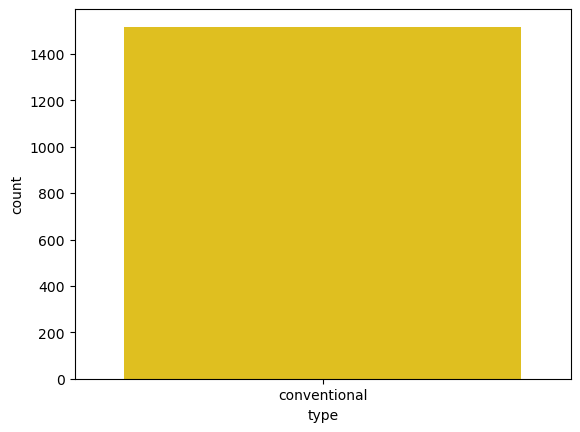

In [109]:
#visualizing the number of unique values in "type" column:   #categorical data
p=sns.countplot(x="type",data=dfav)
print(dfav["type"].value_counts())

from the above graph we can see the data presented here is only of one "type" that isconventional type 

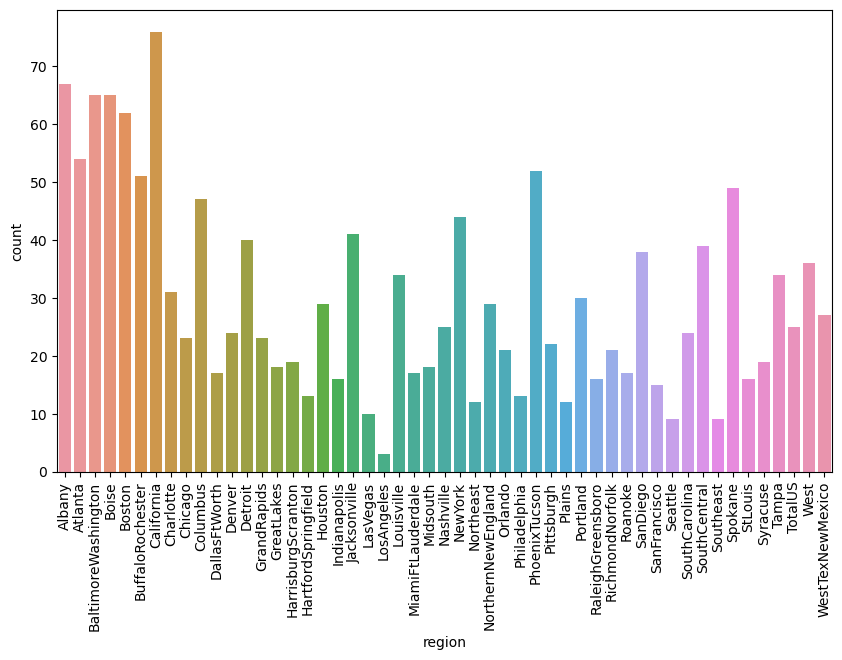

California             76
Albany                 67
BaltimoreWashington    65
Boise                  65
Boston                 62
Atlanta                54
PhoenixTucson          52
BuffaloRochester       51
Spokane                49
Columbus               47
NewYork                44
Jacksonville           41
Detroit                40
SouthCentral           39
SanDiego               38
West                   36
Tampa                  34
Louisville             34
Charlotte              31
Portland               30
Houston                29
NorthernNewEngland     29
WestTexNewMexico       27
Nashville              25
TotalUS                25
Denver                 24
SouthCarolina          24
Chicago                23
GrandRapids            23
Pittsburgh             22
Orlando                21
RichmondNorfolk        21
Syracuse               19
HarrisburgScranton     19
Midsouth               18
GreatLakes             18
DallasFtWorth          17
MiamiFtLauderdale      17
Roanoke     

In [110]:
#visualizing the number of unique values in "type" column:   #categorical data
plt.figure(figsize=(10,6))
p=sns.countplot(x="region",data=dfav)
plt.xticks(rotation=90)
plt.show()
print(dfav["region"].value_counts())

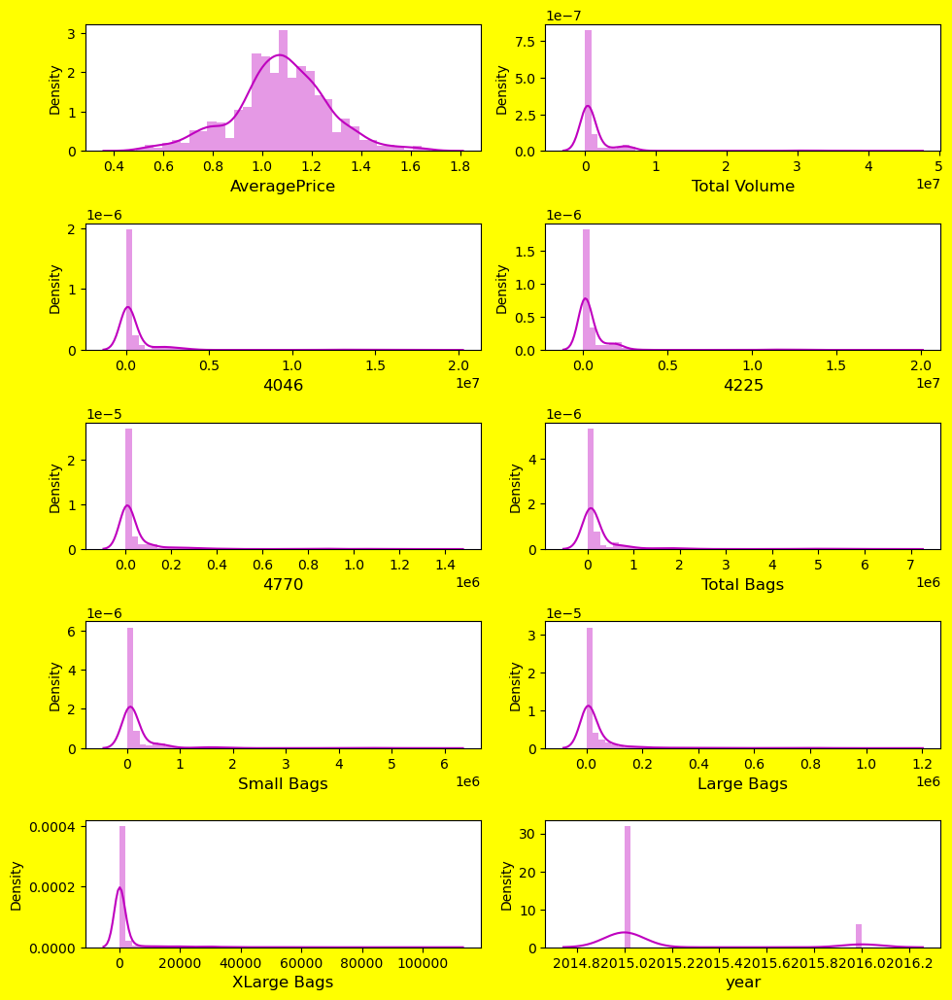

In [111]:
# to check how the data has been distributed in numerical columns:
plt.figure(figsize=(10,12),facecolor="yellow")
plotnum=1
for i in numeric_col:
    if plotnum<=12:
        p=plt.subplot(6,2,plotnum)
        sns.distplot(dfav[i],color="m")
        plt.xlabel(i,fontsize=12)
        plt.yticks(rotation=0,fontsize=10)
    plotnum+=1
plt.tight_layout()    


In [112]:
dfav['year'].value_counts()

2015.0    1270
2016.0     247
Name: year, dtype: int64

2015.0    1270
2016.0     247
Name: year, dtype: int64


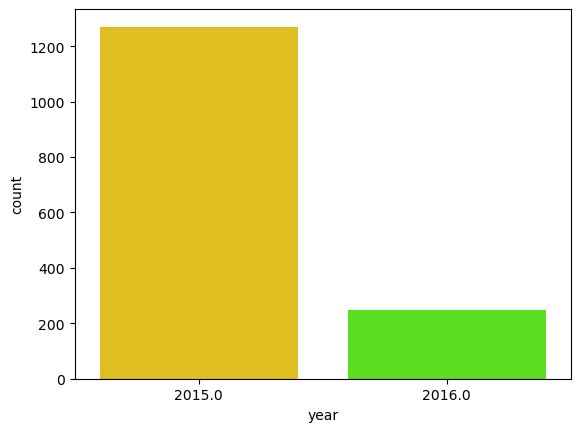

In [113]:
p=sns.countplot(x="year",data=dfav)
print(dfav["year"].value_counts())

### Bivariate Analysis:


In [114]:
dfav.columns.tolist()

['Date',
 'AveragePrice',
 'Total Volume',
 '4046',
 '4225',
 '4770',
 'Total Bags',
 'Small Bags',
 'Large Bags',
 'XLarge Bags',
 'type',
 'year',
 'region']

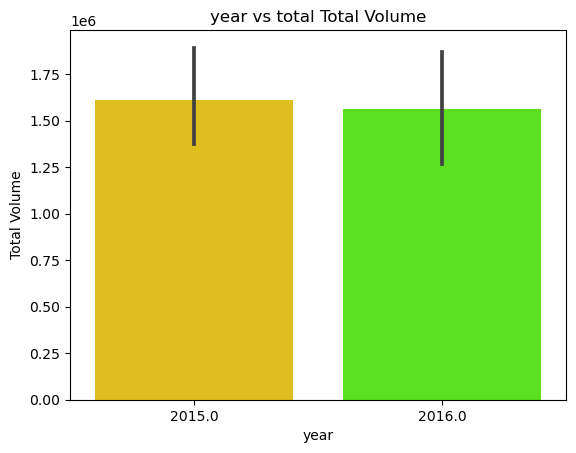

In [115]:
# analysing Total Volume  and year                         # to get insight of total sales in each year
plt.title("year vs total Total Volume")
sns.barplot(x="year",y="Total Volume",data=dfav)
plt.show()


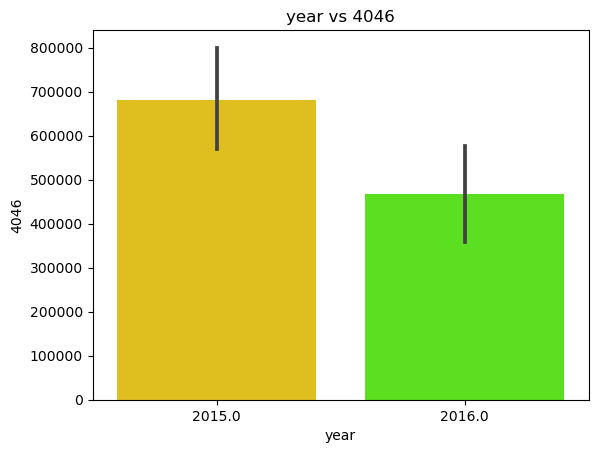

In [116]:
# analysing Total Volume  and year                         # to get insight of 4046 sales in each year
plt.title("year vs 4046")
sns.barplot(x="year",y="4046",data=dfav)
plt.show()


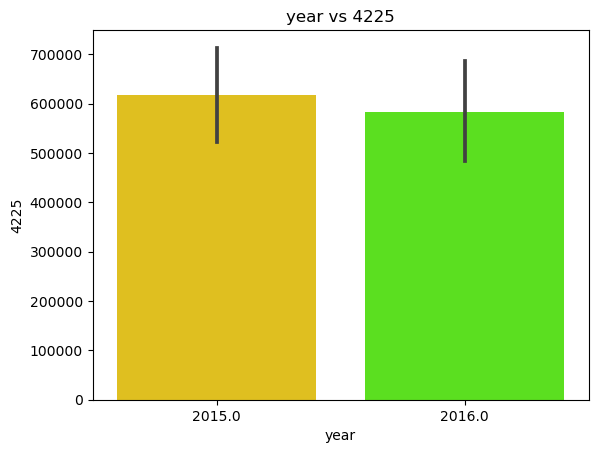

In [117]:
# analysing 4225  and year                         # to get insight of  4225 sales in each year
plt.title("year vs 4225")
sns.barplot(x="year",y="4225",data=dfav)
plt.show()


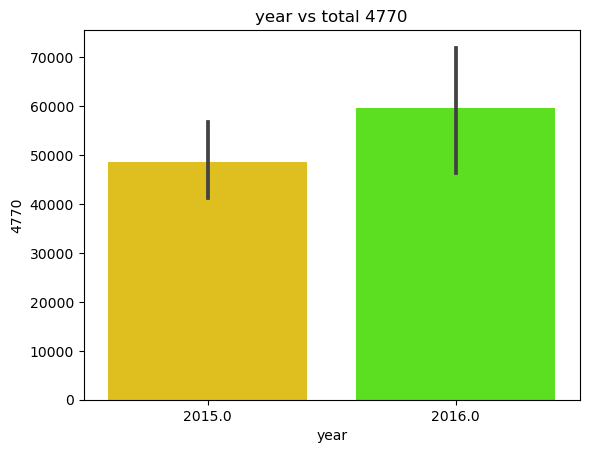

In [118]:
# analysing 4770 and year                         # to get insight of 4770 sales in each year
plt.title("year vs total 4770")
sns.barplot(x="year",y="4770",data=dfav)
plt.show()


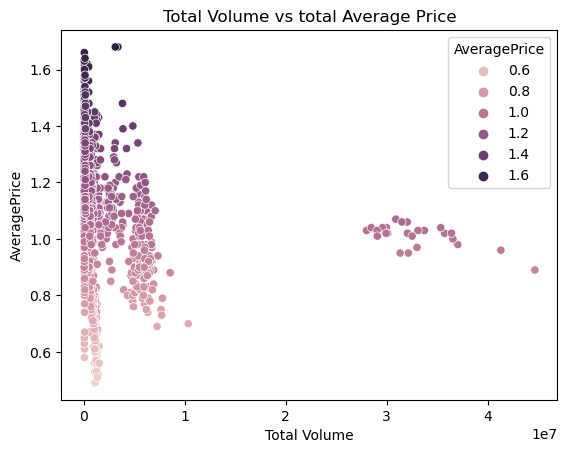

In [119]:
# analysing Total Volume  and Average Price
plt.title("Total Volume vs total Average Price")
sns.scatterplot(x="Total Volume",y="AveragePrice",hue="AveragePrice",data=dfav)
plt.show()


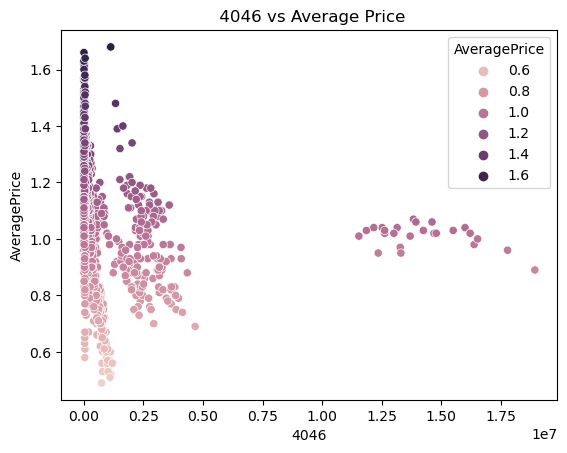

In [120]:
# analysing 4046  and Average Price
plt.title(" 4046 vs Average Price")
sns.scatterplot(x="4046",y="AveragePrice",hue="AveragePrice",data=dfav)
plt.show()


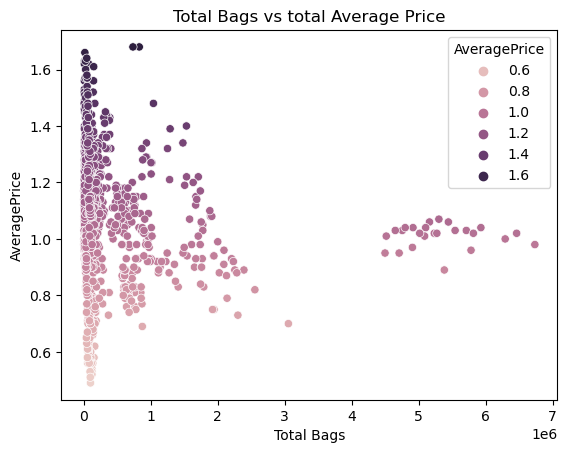

In [121]:
# analysing Total Bags  and Average Price
plt.title("Total Bags vs total Average Price")
sns.scatterplot(x="Total Bags",y="AveragePrice",hue="AveragePrice",data=dfav)
plt.show()


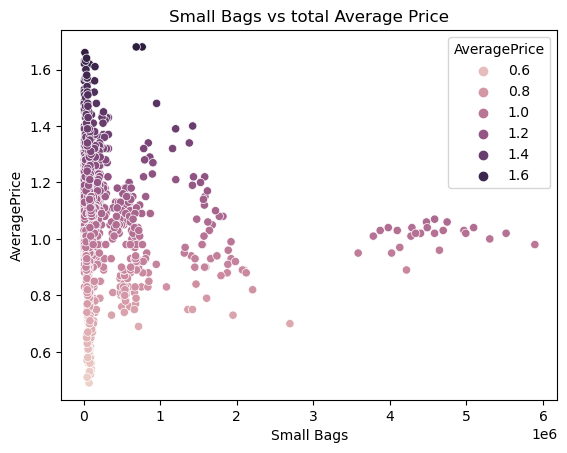

In [122]:
# analysing Small Bags   and Average Price
plt.title("Small Bags vs total Average Price")
sns.scatterplot(x="Small Bags",y="AveragePrice",data=dfav,hue='AveragePrice')
plt.show()


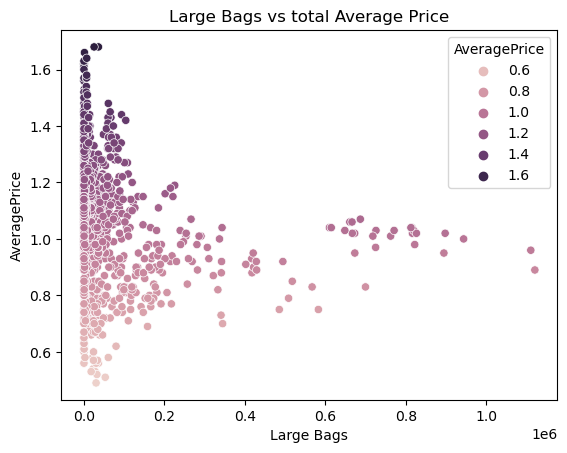

In [123]:
# analysing Large Bags  and Average Price
plt.title("Large Bags vs total Average Price")
sns.scatterplot(x="Large Bags",y="AveragePrice",data=dfav,hue='AveragePrice')
plt.show()


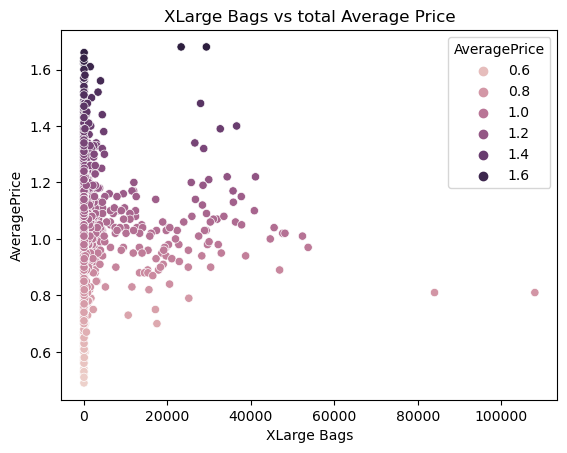

In [124]:
# analysing XLarge Bags  and Average Price
plt.title("XLarge Bags vs total Average Price")
sns.scatterplot(x="XLarge Bags",y="AveragePrice",data=dfav,hue='AveragePrice')
plt.show()


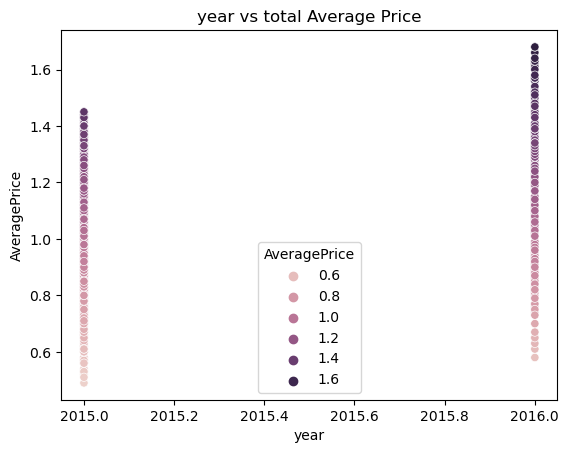

In [125]:
# analysing year  and Average Price
plt.title("year vs total Average Price")
sns.scatterplot(x="year",y="AveragePrice",data=dfav,hue='AveragePrice')
plt.show()


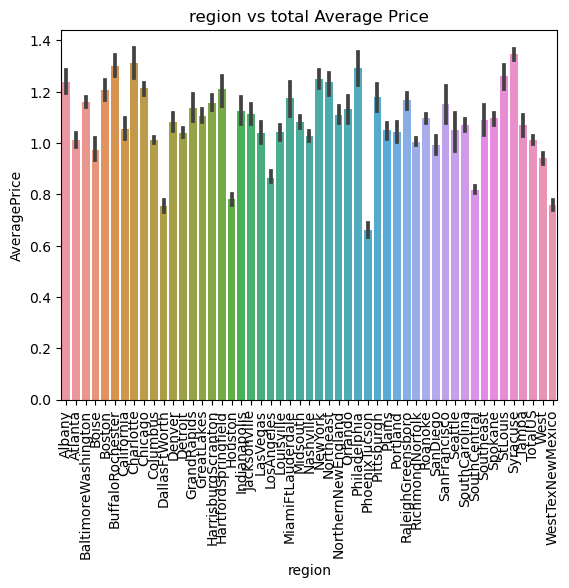

In [126]:
# analysing region  and Average Price
plt.title("region vs total Average Price")
sns.barplot(x="region",y="AveragePrice",data=dfav)
plt.xticks(rotation=90)
plt.show()


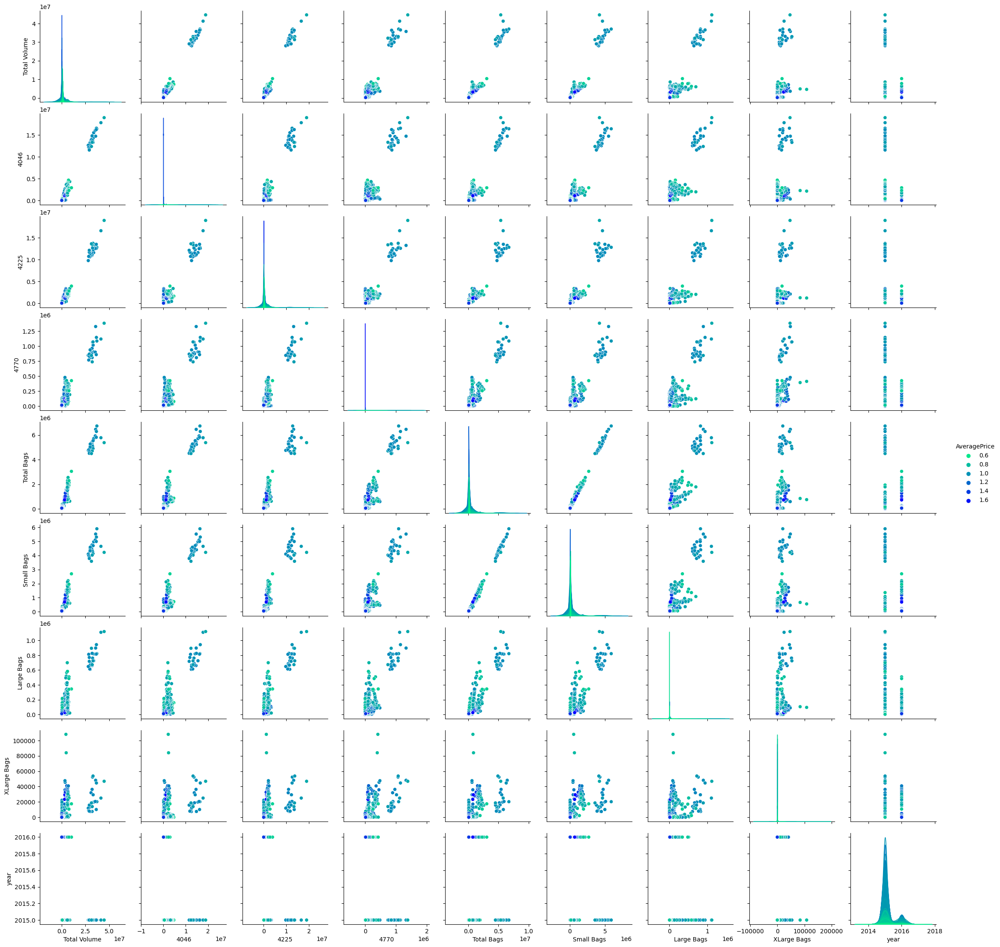

In [222]:
#Multivariate Analysis:
sns.pairplot(dfav,hue='AveragePrice',palette='winter_r')
plt.show()

## Feature Engineering:

In [127]:
# Encoding Categorical Columns:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in dfav.columns:
    if dfav[i].dtypes=="object":
        dfav[i]=OE.fit_transform(dfav[i].values.reshape(-1,1))    
dfav       

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,92.0,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.00,0.0,2015.0,0.0
1,68.0,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.00,0.0,2015.0,0.0
2,44.0,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.00,0.0,2015.0,0.0
3,20.0,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.00,0.0,2015.0,0.0
4,98.0,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.00,0.0,2015.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1512,53.0,1.39,190846.01,57529.11,56366.66,17531.78,59418.46,48823.53,10354.65,240.28,0.0,2016.0,7.0
1513,29.0,1.51,178235.75,43325.87,52189.61,19419.57,63300.70,54704.14,8596.56,0.00,0.0,2016.0,7.0
1514,5.0,1.48,178410.82,46364.75,52893.38,16736.92,62415.77,53332.61,8258.16,825.00,0.0,2016.0,7.0
1515,83.0,1.47,189131.52,54110.79,53593.58,17495.42,63931.73,55653.47,8278.26,0.00,0.0,2016.0,7.0


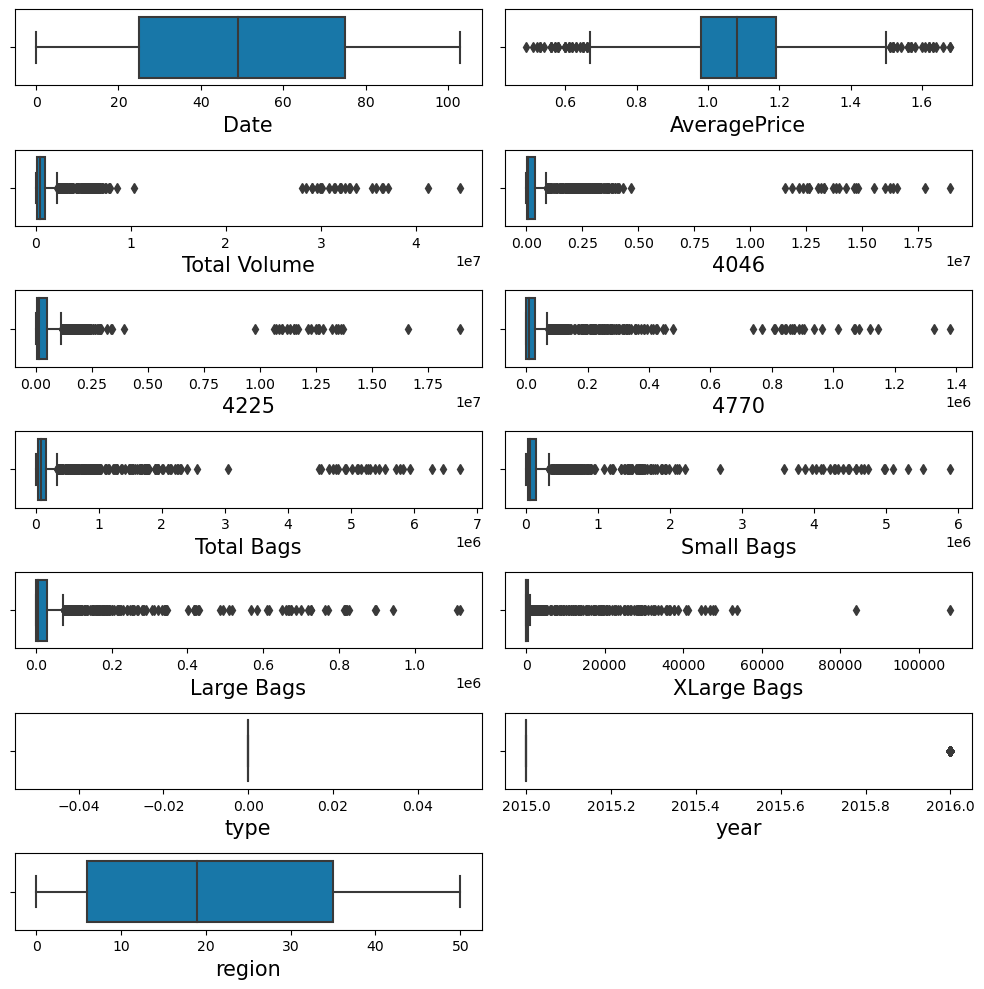

In [128]:
# checking for outliers
plt.figure(figsize=(10,10),facecolor="white")
plotnum=1
for i in dfav.columns:
    if plotnum<=14:
        p=plt.subplot(7,2,plotnum)
        sns.boxplot(dfav[i],palette='winter_r')
        plt.xlabel(i,fontsize=15)
        plt.yticks(rotation=0,fontsize=10)
        plotnum+=1
plt.tight_layout()    

In [129]:
dfav.drop(['type','year'],axis=1,inplace=True)    # droping some of columns which contains outliers only
dfav

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,region
0,92.0,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.00,0.0
1,68.0,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.00,0.0
2,44.0,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.00,0.0
3,20.0,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.00,0.0
4,98.0,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...
1512,53.0,1.39,190846.01,57529.11,56366.66,17531.78,59418.46,48823.53,10354.65,240.28,7.0
1513,29.0,1.51,178235.75,43325.87,52189.61,19419.57,63300.70,54704.14,8596.56,0.00,7.0
1514,5.0,1.48,178410.82,46364.75,52893.38,16736.92,62415.77,53332.61,8258.16,825.00,7.0
1515,83.0,1.47,189131.52,54110.79,53593.58,17495.42,63931.73,55653.47,8278.26,0.00,7.0


In [130]:
# removing utliers from other columns using Z-Score method
from scipy.stats import zscore
out_features=dfav[['Total Volume','4046','4225','4770','Small Bags','Large Bags','XLarge Bags']]
z=np.abs(zscore(out_features))
z

,Total Volume,4046,4225,4770,Small Bags,Large Bags,XLarge Bags
0,0.346966,0.331490,0.333053,0.365608,0.371055,0.360044,0.292727
1,0.349078,0.331676,0.338923,0.365534,0.369812,0.360008,0.292727
2,0.334785,0.331614,0.300348,0.365010,0.371922,0.359960,0.292727
3,0.343636,0.331441,0.322576,0.365431,0.375576,0.359701,0.292727
4,0.349944,0.331539,0.339401,0.365408,0.375098,0.359160,0.292727
...,...,...,...,...,...,...,...
1512,0.318397,0.302475,0.331910,0.238672,0.308916,0.273213,0.260489
1513,0.321242,0.309770,0.334407,0.224966,0.299831,0.288090,0.292727
1514,0.321203,0.308209,0.333987,0.244443,0.301950,0.290953,0.182037
1515,0.318784,0.304230,0.333568,0.238936,0.298364,0.290783,0.292727


In [131]:
#threshold=3
np.where(z>3)

(array([ 398,  401,  409,  412,  412, 1016, 1017, 1059, 1182, 1182, 1182,
        1182, 1182, 1182, 1182, 1183, 1183, 1183, 1183, 1183, 1183, 1184,
        1184, 1184, 1184, 1184, 1184, 1184, 1185, 1185, 1185, 1185, 1185,
        1185, 1186, 1186, 1186, 1186, 1186, 1186, 1187, 1187, 1187, 1187,
        1187, 1187, 1187, 1188, 1188, 1188, 1188, 1188, 1188, 1189, 1189,
        1189, 1189, 1189, 1189, 1189, 1190, 1190, 1190, 1190, 1190, 1190,
        1190, 1191, 1191, 1191, 1191, 1191, 1191, 1191, 1192, 1192, 1192,
        1192, 1192, 1192, 1193, 1193, 1193, 1193, 1193, 1193, 1194, 1194,
        1194, 1194, 1194, 1194, 1195, 1195, 1195, 1195, 1195, 1195, 1195,
        1196, 1196, 1196, 1196, 1196, 1196, 1197, 1197, 1197, 1197, 1197,
        1197, 1198, 1198, 1198, 1198, 1198, 1198, 1198, 1199, 1199, 1199,
        1199, 1199, 1199, 1200, 1200, 1200, 1200, 1200, 1200, 1201, 1201,
        1201, 1201, 1201, 1201, 1202, 1202, 1202, 1202, 1202, 1202, 1202,
        1203, 1203, 1203, 1203, 1203, 

In [132]:
# we have to removethese rows which have outliers:
dfav1=dfav[(z<3).all(axis=1)]
dfav1.shape          # after removing outliers the data frame size

(1439, 11)

In [133]:
dfav.shape                       # original dataframe size

(1517, 11)

In [134]:
#data loss percentage:
print("data loss percentage",((dfav.shape[0]-dfav1.shape[0])/dfav.shape[0])*100)

data loss percentage 5.1417270929466055


the data loss percentage in z-score method is 5.14 only, which is affordable.. so we can proceed

In [135]:
#checking for skewness present in the data:
dfav1.skew()

Date            0.013397
AveragePrice   -0.164097
Total Volume    2.699607
4046            3.117671
4225            2.364213
4770            3.329694
Total Bags      4.153979
Small Bags      4.394953
Large Bags      3.521463
XLarge Bags     5.107058
region          0.277518
dtype: float64

 
###### from the above skewness table we can see the data are highly skewed.. so we have to normalize the data for the better performance of the model.

In [136]:
# applying log transform to reduce skewness
dfav1['Total Volume']=np.log2(dfav1['Total Volume']+1)
dfav1['4046']=np.log2(dfav1['4046']+1)
dfav1['4225']=np.log2(dfav1['4225']+1)
dfav1['4770']=np.log2(dfav1['4770']+1)
dfav1['Total Bags']=np.log2(dfav1['Total Bags']+1)
dfav1['Small Bags']=np.log2(dfav1['Small Bags']+1)
dfav1['Large Bags']=np.log2(dfav1['Large Bags']+1)
dfav1['XLarge Bags']=np.log2(dfav1['XLarge Bags']+1)


In [137]:
dfav1.skew()

Date            0.013397
AveragePrice   -0.164097
Total Volume    0.460393
4046           -0.271890
4225            0.010401
4770           -0.451450
Total Bags      0.378709
Small Bags      0.421548
Large Bags     -0.981094
XLarge Bags     0.851902
region          0.277518
dtype: float64

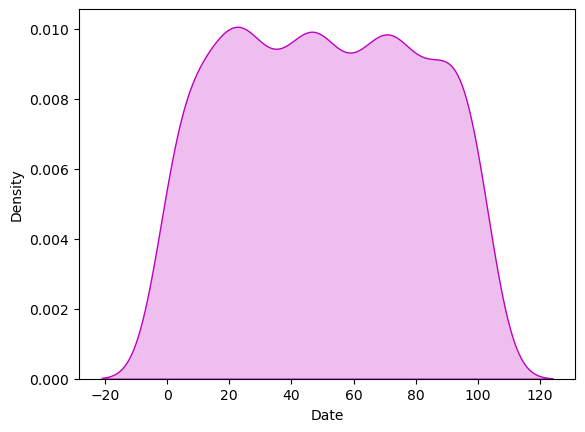

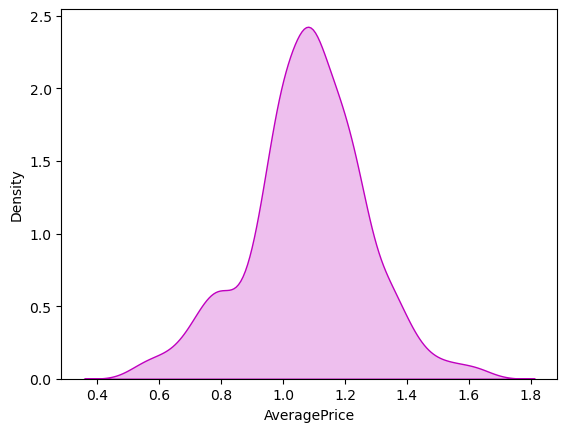

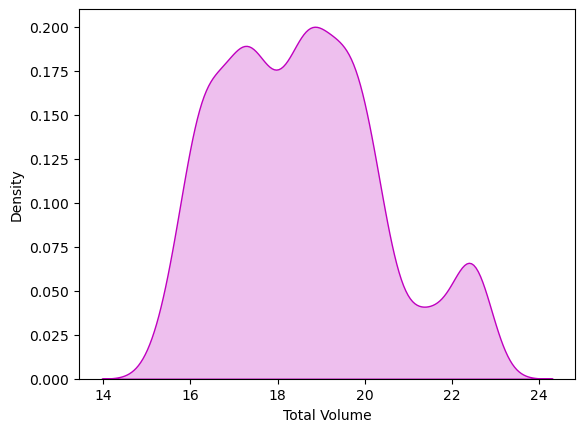

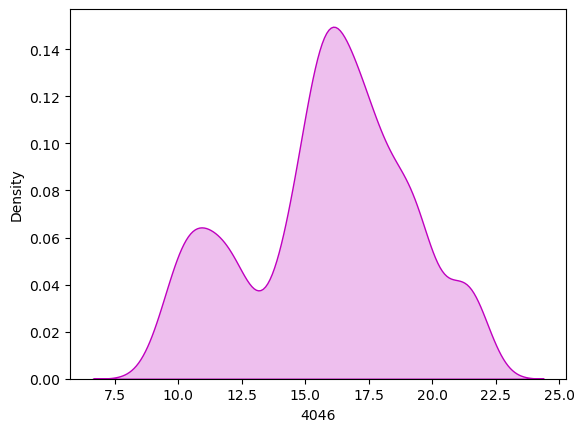

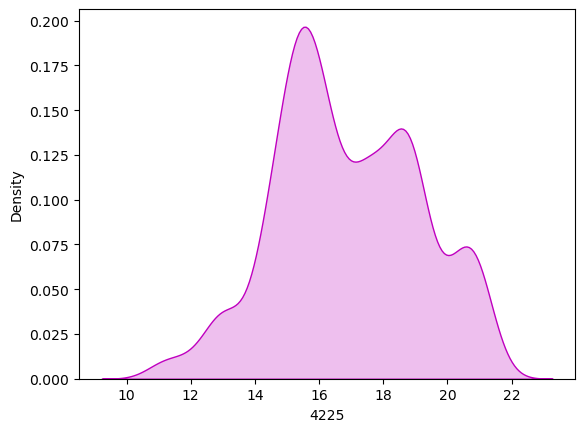

...

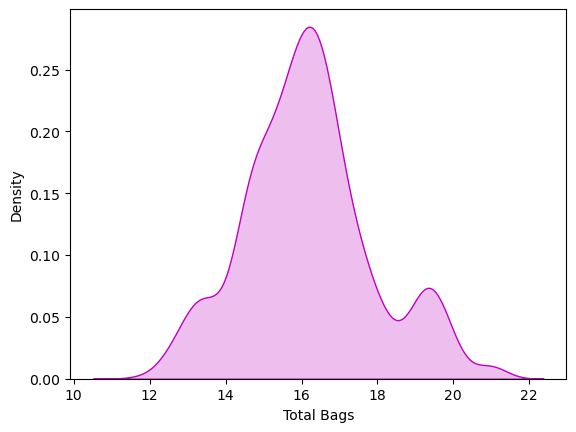

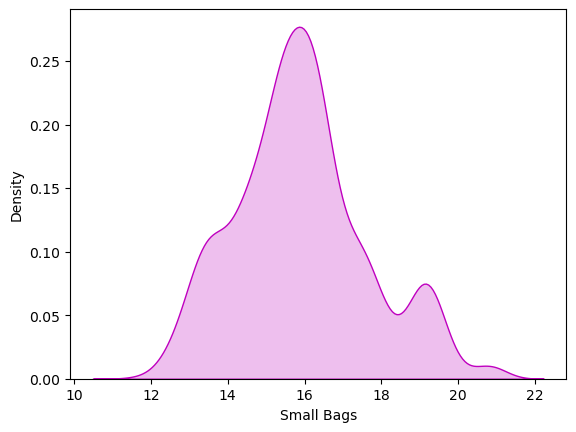

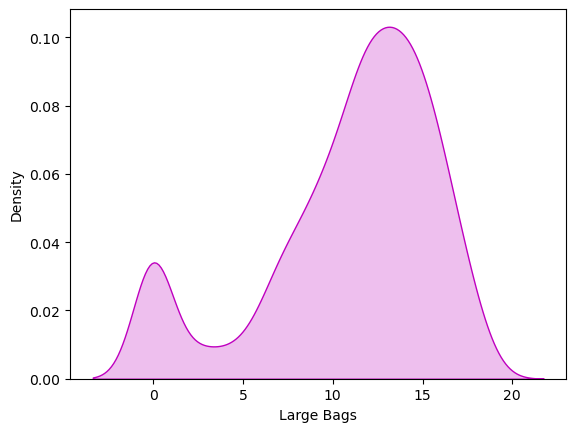

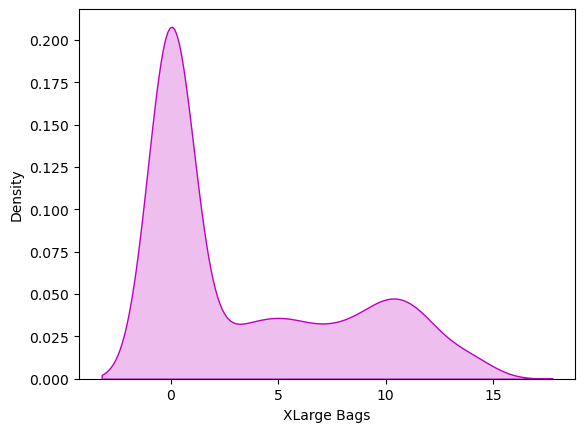

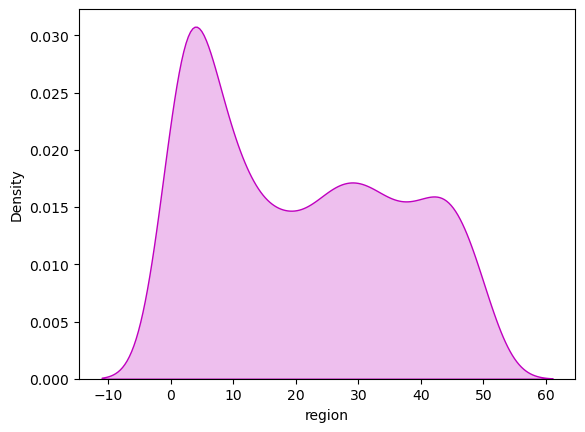

In [138]:
#visualizing the spreading of data
for i in dfav1.columns:
    sns.distplot(dfav1[i],color="m",kde_kws={"shade":True},hist=False)
    plt.show()

In [139]:
# corelation between target variable and features
corr=dfav1.corr()
corr

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,region
Date,1.000000,0.092639,-0.040216,-0.021836,-0.047578,0.004967,-0.017434,-0.006875,-0.028466,0.022988,-0.026685
AveragePrice,0.092639,1.000000,-0.349253,-0.540384,-0.114794,-0.291687,-0.189767,-0.142685,-0.203736,-0.050811,-0.215895
Total Volume,-0.040216,-0.349253,1.000000,0.715444,0.861478,0.563792,0.916182,0.897385,0.524762,0.268347,0.158024
4046,-0.021836,-0.540384,0.715444,1.000000,0.339923,0.513861,0.571182,0.526033,0.457610,0.181686,0.311496
4225,-0.047578,-0.114794,0.861478,0.339923,1.000000,0.464755,0.801890,0.812185,0.370000,0.233392,0.087215
4770,0.004967,-0.291687,0.563792,0.513861,0.464755,1.000000,0.490054,0.507512,0.277639,0.480544,0.009869
Total Bags,-0.017434,-0.189767,0.916182,0.571182,0.801890,0.490054,1.000000,0.979621,0.533463,0.330705,0.118652
Small Bags,-0.006875,-0.142685,0.897385,0.526033,0.812185,0.507512,0.979621,1.000000,0.415115,0.317342,0.104563
Large Bags,-0.028466,-0.203736,0.524762,0.457610,0.370000,0.277639,0.533463,0.415115,1.000000,0.174067,0.043509
XLarge Bags,0.022988,-0.050811,0.268347,0.181686,0.233392,0.480544,0.330705,0.317342,0.174067,1.000000,-0.215819


In [140]:
corr['AveragePrice'].sort_values(ascending=False)

AveragePrice    1.000000
Date            0.092639
XLarge Bags    -0.050811
4225           -0.114794
Small Bags     -0.142685
Total Bags     -0.189767
Large Bags     -0.203736
region         -0.215895
4770           -0.291687
Total Volume   -0.349253
4046           -0.540384
Name: AveragePrice, dtype: float64

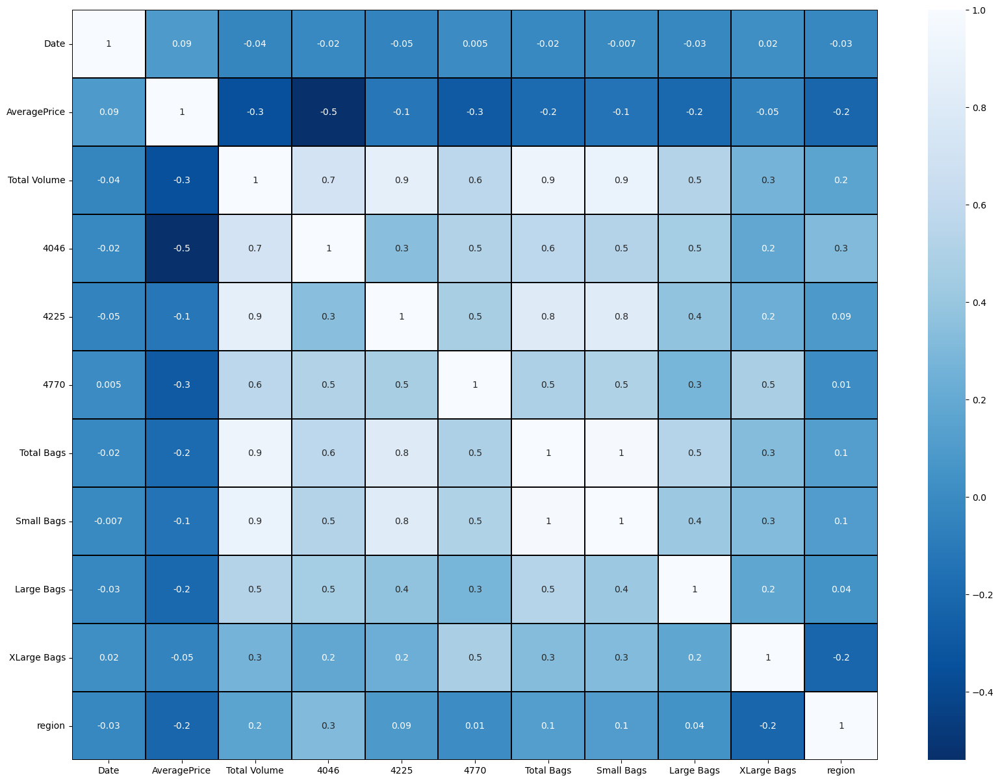

In [141]:
#visualizing the corelation matrix by using the heaatmap
plt.figure(figsize=(20,15))
sns.heatmap(dfav1.corr(),linewidth=0.1,fmt='0.1g',linecolor="black",annot=True,cmap="Blues_r")
plt.yticks(rotation=0);
plt.show()

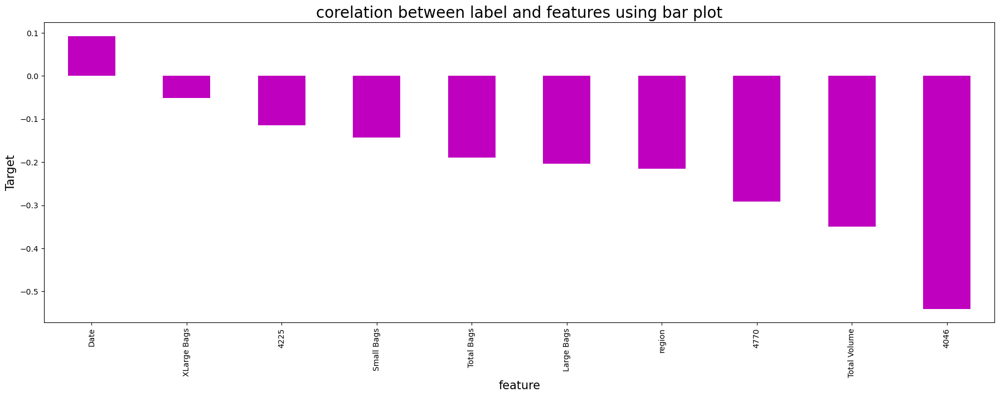

In [142]:
# visualizing the corelation using barplot:
plt.figure(figsize=(22,7))
dfav1.corr()['AveragePrice'].sort_values(ascending=False).drop(['AveragePrice']).plot(kind='bar',color="m")
plt.xlabel('feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.title("corelation between label and features using bar plot",fontsize=20)
plt.show()


In [143]:
dfav1.drop('Small Bags',axis=1,inplace=True)                 # to avoid Multicolinearity

In [144]:
dfav1.columns

Index(['Date', 'AveragePrice', 'Total Volume', '4046', '4225', '4770',
       'Total Bags', 'Large Bags', 'XLarge Bags', 'region'],
      dtype='object')

In [145]:
#separating target variable and input variable

x=dfav1.drop('AveragePrice',axis=1)
y=dfav1['AveragePrice']

In [146]:
x

,Date,Total Volume,4046,4225,4770,Total Bags,Large Bags,XLarge Bags,region
0,92.0,15.971131,10.019229,15.732799,5.619413,13.086446,6.558421,0.000000,0.0
1,68.0,15.743940,9.399342,15.446043,5.890690,13.214708,6.621905,0.000000,0.0
2,44.0,16.851129,9.636081,16.735961,7.038919,12.991938,6.702381,0.000000,0.0
3,20.0,16.269440,10.145932,16.135257,6.201242,12.504859,7.074249,0.000000,0.0
4,98.0,15.639358,9.880318,15.419940,6.262659,12.594546,7.634375,0.000000,0.0
...,...,...,...,...,...,...,...,...,...
1512,53.0,17.542057,15.812030,15.782580,14.097767,15.858648,13.338130,7.914565,7.0
1513,29.0,17.443435,15.402974,15.671503,14.245298,15.949957,13.069712,0.000000,7.0
1514,5.0,17.444852,15.500772,15.690827,14.030833,15.929646,13.011779,9.689998,7.0
1515,83.0,17.529038,15.723655,15.709799,14.094772,15.964267,13.015286,0.000000,7.0


In [147]:
x.isnull().sum()

Date            0
Total Volume    0
4046            0
4225            0
4770            0
Total Bags      0
Large Bags      0
XLarge Bags     0
region          0
dtype: int64

In [148]:
# feature scaling using standard scalarization

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,Date,Total Volume,4046,4225,4770,Total Bags,Large Bags,XLarge Bags,region
0,1.373970,-1.410667,-1.845437,-0.509017,-1.813645,-1.821482,-0.918974,-0.775984,-1.322226
1,0.575407,-1.535293,-2.040669,-0.636296,-1.736871,-1.745993,-0.905743,-0.775984,-1.322226
2,-0.223157,-0.927942,-1.966109,-0.063754,-1.411912,-1.877105,-0.888970,-0.775984,-1.322226
3,-1.021720,-1.247029,-1.805532,-0.330383,-1.648982,-2.163780,-0.811465,-0.775984,-1.322226
4,1.573611,-1.592662,-1.889187,-0.647882,-1.631601,-2.110993,-0.694724,-0.775984,-1.322226
...,...,...,...,...,...,...,...,...,...
1434,0.076305,-0.548933,-0.021003,-0.486921,0.585807,-0.189882,0.494051,0.943742,-0.878606
1435,-0.722259,-0.603032,-0.149834,-0.536224,0.627560,-0.136142,0.438107,-0.775984,-0.878606
1436,-1.520822,-0.602255,-0.119033,-0.527647,0.566864,-0.148096,0.426033,1.329519,-0.878606
1437,1.074509,-0.556074,-0.048836,-0.519226,0.584960,-0.127719,0.426764,-0.775984,-0.878606


In [149]:
y

0       1.33
1       1.35
2       0.93
3       1.08
4       1.28
        ... 
1512    1.39
1513    1.51
1514    1.48
1515    1.47
1516    1.43
Name: AveragePrice, Length: 1439, dtype: float64

##### the output variable contains continues data so we can apply a regression model to the given dataset

# modeling

In [150]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.linear_model import Lasso,Ridge


In [151]:
# finding the best random state
maxAcc=0
maxRs=0
for i in range(1,1000):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.20,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    acc=r2_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum r2_score is",maxAcc, "on random_state",maxRs)        

maximum r2_score is 0.5000477911652182 on random_state 75


In [152]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=maxRs)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(1007, 9)
(1007,)
(432, 9)
(432,)


In [153]:
LR=LinearRegression()
LR.fit(x_train,y_train)
pred_lr=LR.predict(x_test)
pred_train=LR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_lr))
print('r2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_lr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_lr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_lr)))

r2_score: 0.44572573033380314
r2_score on training Data: 33.43431061171167
mean absolute error: 0.1150346915518945
Mean Squared Error:- 0.021537252142132382
Root Mean Squrared Error:- 0.14675575675976865


In [154]:
# Random Forest model:
RFR=RandomForestRegressor()
RFR.fit(x_train,y_train)
pred_RFR=RFR.predict(x_test)
pred_train=RFR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_RFR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_RFR))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_RFR))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_RFR)))

r2_score: 0.7747011566502453
R2_score on training Data: 97.209882753652
mean absolute error: 0.06629652777777781
Mean Squared Error:- 0.00875436270833334
Root Mean Squrared Error:- 0.09356475142025088


In [155]:
# KNN
knn=KNN()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
pred_train=knn.predict(x_train)
print('r2_score:',r2_score(y_test,pred_knn))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_knn))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_knn))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_knn)))

r2_score: 0.6905929428883231
R2_score on training Data: 78.19187557747745
mean absolute error: 0.08233796296296296
Mean Squared Error:- 0.012022527777777776
Root Mean Squrared Error:- 0.10964728805482503


In [156]:
# GBR
GBR=GradientBoostingRegressor()
GBR.fit(x_train,y_train)
pred_GBR=GBR.predict(x_test)
pred_train=GBR.predict(x_train)
print('r2_score:',r2_score(y_test,pred_GBR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_GBR))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_GBR))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_GBR)))

r2_score: 0.7253207173023724
R2_score on training Data: 84.4566261603456
mean absolute error: 0.07601949317025818
Mean Squared Error:- 0.010673122122810406
Root Mean Squrared Error:- 0.10331080351449409


In [157]:
#Lasso
lasso=Lasso()
lasso.fit(x_train,y_train)
pred_lasso=lasso.predict(x_test)
pred_train=lasso.predict(x_train)
print('r2_score:',r2_score(y_test,pred_lasso))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_lasso))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_lasso))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_lasso)))

r2_score: -0.0010503147513021283
R2_score on training Data: 0.0
mean absolute error: 0.1499485775497444
Mean Squared Error:- 0.03889748129341072
Root Mean Squrared Error:- 0.19722444395513128


In [158]:
#Ridge:
ridge=Ridge()
ridge.fit(x_train,y_train)
pred_ridge=ridge.predict(x_test)
pred_train=ridge.predict(x_train)
print('r2_score:',r2_score(y_test,pred_ridge))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_ridge))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_ridge))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_ridge)))

r2_score: 0.44621517768967656
R2_score on training Data: 33.42189067733214
mean absolute error: 0.11483976817795088
Mean Squared Error:- 0.021518233847958104
Root Mean Squrared Error:- 0.14669094671436989


In [159]:
#Decision Tree:
dtr=DecisionTreeRegressor()
dtr.fit(x_train,y_train)
pred_dtr=dtr.predict(x_test)
pred_train=dtr.predict(x_train)
print('r2_score:',r2_score(y_test,pred_dtr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_dtr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_dtr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_dtr)))

r2_score: 0.547738397846728
R2_score on training Data: 100.0
mean absolute error: 0.08770833333333333
Mean Squared Error:- 0.017573379629629626
Root Mean Squrared Error:- 0.13256462435216126


In [160]:
#svr
from sklearn.svm import SVR
svr=SVR()
svr.fit(x_train,y_train)
pred_svr=svr.predict(x_test)
pred_train=svr.predict(x_train)
print('r2_score:',r2_score(y_test,pred_svr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('mean absolute error:',mean_absolute_error(y_test,pred_svr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_svr))
print("Root Mean Squrared Error:-",np.sqrt(mean_squared_error(y_test,pred_svr)))

r2_score: 0.6871602606665399
R2_score on training Data: 76.02806820451016
mean absolute error: 0.08468727476435564
Mean Squared Error:- 0.012155910376574723
Root Mean Squrared Error:- 0.11025384517818289


###### from above we can see Random Forest model performs better.. now cross validating the models:
    

In [161]:
# cross validation of the model:
from sklearn.model_selection import cross_val_score

In [162]:
scoreLR=cross_val_score(LR,x,y,cv=5,scoring='r2')             #CROSS VALIDATION FOR LINEAR REGRESSOR
print(scoreLR)
print(scoreLR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_lr)-scoreLR.mean())*100)

[-0.55984937 -0.01306283  0.31890599  0.09178623  0.15310365]
-0.001823266453816319
difference between r2 score and cross validation score is: 44.754899678761944


In [163]:
scoreRFR=cross_val_score(RFR,x,y,cv=5,scoring='r2')        #CROSS VALIDATION FOR RANDOM FOREST
print(scoreRFR)
print(scoreRFR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_RFR)-scoreRFR.mean())*100)

[-0.83674349  0.08605161  0.50857178  0.3502124   0.30053789]
0.0817260376382507
difference between r2 score and cross validation score is: 69.29751190119946


In [164]:
scoreknn=cross_val_score(knn,x,y,cv=5,scoring='r2')            # CROSS VALIDATION FOR KNN
print(scoreknn)
print(scoreknn.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_knn)-scoreknn.mean())*100)

[-1.19209728  0.09249601 -0.00497896 -0.35896091  0.30085994]
-0.23253623864600534
difference between r2 score and cross validation score is: 92.31291815343285


In [165]:
scoreGBR=cross_val_score(GBR,x,y,cv=5,scoring='r2')             #cross validation for gbr
print(scoreGBR)
print(scoreGBR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_GBR)-scoreGBR.mean())*100)

[-0.83087576  0.22937999  0.48398294  0.32873441  0.2650239 ]
0.09524909680611468
difference between r2 score and cross validation score is: 63.00716204962576


In [166]:
scoreL=cross_val_score(lasso,x,y,cv=5,scoring='r2')            #cross validation for lasso
print(scoreL) 
print(scoreL.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_lasso)-scoreL.mean())*100)

[-0.25966532 -0.0871809  -0.01464734 -0.00392758 -0.01087803]
-0.07525983568481558
difference between r2 score and cross validation score is: 7.420952093351345


In [167]:
scoreR=cross_val_score(ridge,x,y,cv=5,scoring='r2')          #cross validation for ridge
print(scoreR)
print(scoreR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_ridge)-scoreR.mean())*100)

[-0.53811541 -0.00780352  0.31670078  0.08042075  0.15375289]
0.0009910984458730177
difference between r2 score and cross validation score is: 44.52240792438035


In [168]:
scoreSVR=cross_val_score(svr,x,y,cv=5,scoring='r2')             #cross validation for svr
print(scoreSVR)
print(scoreSVR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_svr)-scoreSVR.mean())*100)

[-2.37488092  0.45689783  0.02015603 -0.08189561  0.14098935]
-0.3677466644380877
difference between r2 score and cross validation score is: 105.49069251046275


In [169]:
scoreDTR=cross_val_score(dtr,x,y,cv=5,scoring='r2')             #cross validation for svr
print(scoreDTR)
print(scoreDTR.mean())
print("difference between r2 score and cross validation score is:",(r2_score(y_test,pred_dtr)-scoreDTR.mean())*100)

[-2.97038549 -0.57024663  0.29011079 -1.46473568 -0.01678834]
-0.9464090675168915
difference between r2 score and cross validation score is: 149.41474653636195


# Hyperparameter Tuning Random forest model:


In [222]:
from sklearn.model_selection import GridSearchCV
parameter = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4],
    'min_samples_split': [8, 10],
    'n_estimators': [100, 200, 300]
    }

GCV=GridSearchCV(RandomForestRegressor(),parameter,cv=4)
GCV.fit(x_train,y_train)


GridSearchCV(cv=4, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': [True], 'max_depth': [80, 90, 100],
                         'max_features': [2, 3], 'min_samples_leaf': [3, 4],
                         'min_samples_split': [8, 10],
                         'n_estimators': [100, 200, 300]})

In [223]:
GCV.best_params_

{'bootstrap': True,
 'max_depth': 90,
 'max_features': 3,
 'min_samples_leaf': 3,
 'min_samples_split': 8,
 'n_estimators': 300}

In [224]:
model_av=RandomForestRegressor(bootstrap=True,max_depth=90,max_features=3,min_samples_leaf=3,min_samples_split= 8,n_estimators=300)

# Final Model

In [225]:
#  Final Model:
model_av.fit(x_train,y_train)
pred=model_av.predict(x_test)
acc=r2_score(y_test,pred)
print(acc*100)

77.66478186297726


### The Final Model giving 77.66% accuracy

In [226]:
import joblib
joblib.dump(model_av,"Avocado Average Price")


['Avocado Average Price']

In [227]:
RFRM=joblib.load("Avocado Average Price")
predictionM=RFRM.predict(x_test)
predictionM

array([1.18890003, 0.67896465, 0.99701709, 1.20295122, 1.00717545,
       1.1172271 , 1.14743853, 1.05853983, 0.76804355, 1.04205036,
       1.11216916, 1.04145578, 1.15864666, 0.85691473, 1.24565013,
       1.13523142, 1.05671428, 0.86491199, 0.68222674, 1.13457672,
       0.64862821, 0.98696121, 1.31842465, 1.06175224, 0.59219787,
       1.0745927 , 1.22995883, 0.92943852, 1.24925718, 1.02191926,
       1.20404553, 1.08849548, 1.17661457, 1.09004548, 0.82743203,
       0.59560662, 1.07869062, 0.7822527 , 1.04887174, 1.27480982,
       0.87311559, 1.17611609, 1.28278835, 1.19678146, 1.1239063 ,
       1.03579623, 1.07292443, 1.0874033 , 1.02668183, 0.98412786,
       1.15599424, 1.02836517, 1.28200523, 1.13436276, 1.17373091,
       1.04651662, 1.18084616, 0.70155534, 1.12841986, 1.22048615,
       1.06097475, 1.3837947 , 1.16297886, 0.98527871, 1.01759403,
       0.78515257, 0.81272826, 1.00983384, 0.98714662, 1.15404608,
       1.08659903, 1.06404853, 1.23364694, 0.82866896, 1.10631

In [228]:
a=np.array(y_test)
DFM=pd.DataFrame()
DFM['predicted']=predictionM
DFM['original']=a
DFM

,predicted,original
0,1.188900,1.06
1,0.678965,0.66
2,0.997017,0.92
3,1.202951,1.27
4,1.007175,0.97
...,...,...
427,0.904944,0.81
428,1.038625,0.96
429,1.016739,0.97
430,1.098739,1.05


### PHASE-2: REGION ANALYSIS

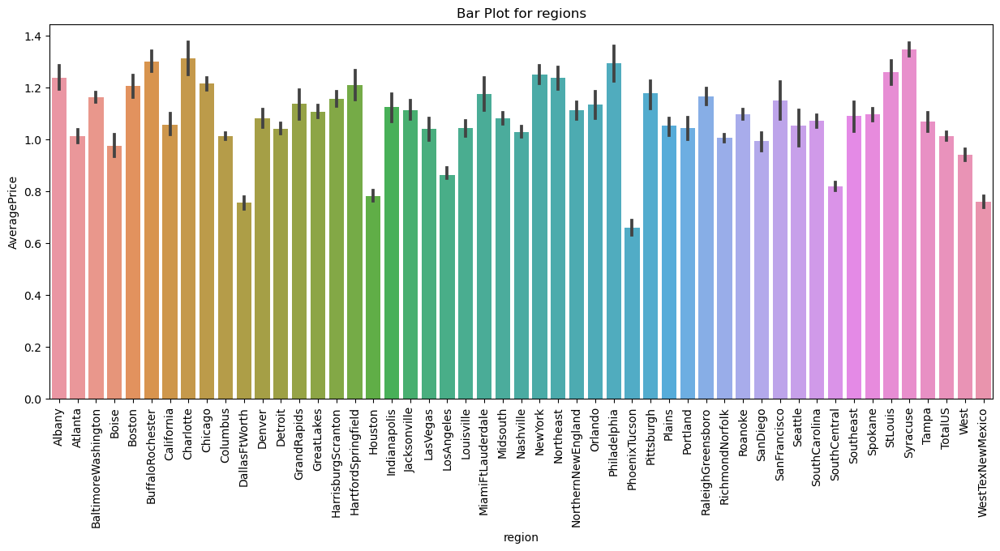

In [66]:
#BiVariate Analysis:
plt.figure(figsize=(15,6))
sns.barplot(x=dfav['region'],y=dfav['AveragePrice'], data=dfav)
plt.title(f'Bar Plot for regions')
plt.xticks(rotation=90)
plt.show()

In [170]:
dfav2=dfav1.copy()
dfav2

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Large Bags,XLarge Bags,region
0,92.0,1.33,15.971131,10.019229,15.732799,5.619413,13.086446,6.558421,0.000000,0.0
1,68.0,1.35,15.743940,9.399342,15.446043,5.890690,13.214708,6.621905,0.000000,0.0
2,44.0,0.93,16.851129,9.636081,16.735961,7.038919,12.991938,6.702381,0.000000,0.0
3,20.0,1.08,16.269440,10.145932,16.135257,6.201242,12.504859,7.074249,0.000000,0.0
4,98.0,1.28,15.639358,9.880318,15.419940,6.262659,12.594546,7.634375,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...
1512,53.0,1.39,17.542057,15.812030,15.782580,14.097767,15.858648,13.338130,7.914565,7.0
1513,29.0,1.51,17.443435,15.402974,15.671503,14.245298,15.949957,13.069712,0.000000,7.0
1514,5.0,1.48,17.444852,15.500772,15.690827,14.030833,15.929646,13.011779,9.689998,7.0
1515,83.0,1.47,17.529038,15.723655,15.709799,14.094772,15.964267,13.015286,0.000000,7.0


In [171]:
#separating target variable and input variable

x=dfav1.drop('region',axis=1)
y=dfav1['region']

In [172]:
x

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Large Bags,XLarge Bags
0,92.0,1.33,15.971131,10.019229,15.732799,5.619413,13.086446,6.558421,0.000000
1,68.0,1.35,15.743940,9.399342,15.446043,5.890690,13.214708,6.621905,0.000000
2,44.0,0.93,16.851129,9.636081,16.735961,7.038919,12.991938,6.702381,0.000000
3,20.0,1.08,16.269440,10.145932,16.135257,6.201242,12.504859,7.074249,0.000000
4,98.0,1.28,15.639358,9.880318,15.419940,6.262659,12.594546,7.634375,0.000000
...,...,...,...,...,...,...,...,...,...
1512,53.0,1.39,17.542057,15.812030,15.782580,14.097767,15.858648,13.338130,7.914565
1513,29.0,1.51,17.443435,15.402974,15.671503,14.245298,15.949957,13.069712,0.000000
1514,5.0,1.48,17.444852,15.500772,15.690827,14.030833,15.929646,13.011779,9.689998
1515,83.0,1.47,17.529038,15.723655,15.709799,14.094772,15.964267,13.015286,0.000000


In [173]:
# feature scaling using standard scalarization

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Large Bags,XLarge Bags
0,1.373970,1.330513,-1.410667,-1.845437,-0.509017,-1.813645,-1.821482,-0.918974,-0.775984
1,0.575407,1.435940,-1.535293,-2.040669,-0.636296,-1.736871,-1.745993,-0.905743,-0.775984
2,-0.223157,-0.778028,-0.927942,-1.966109,-0.063754,-1.411912,-1.877105,-0.888970,-0.775984
3,-1.021720,0.012675,-1.247029,-1.805532,-0.330383,-1.648982,-2.163780,-0.811465,-0.775984
4,1.573611,1.066946,-1.592662,-1.889187,-0.647882,-1.631601,-2.110993,-0.694724,-0.775984
...,...,...,...,...,...,...,...,...,...
1434,0.076305,1.646794,-0.548933,-0.021003,-0.486921,0.585807,-0.189882,0.494051,0.943742
1435,-0.722259,2.279357,-0.603032,-0.149834,-0.536224,0.627560,-0.136142,0.438107,-0.775984
1436,-1.520822,2.121216,-0.602255,-0.119033,-0.527647,0.566864,-0.148096,0.426033,1.329519
1437,1.074509,2.068503,-0.556074,-0.048836,-0.519226,0.584960,-0.127719,0.426764,-0.775984


In [174]:
y

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
1512    7.0
1513    7.0
1514    7.0
1515    7.0
1516    7.0
Name: region, Length: 1439, dtype: float64

In [175]:
y.nunique()

50

In [176]:
!pip install -U imbalanced-learn

Defaulting to user installation because normal site-packages is not writeable


In [177]:
# to balance the target variable data over sampling is performed:
from imblearn.over_sampling import SMOTE
sm=SMOTE(k_neighbors=2)
x1,y1=sm.fit_resample(x,y)

In [178]:
y1.value_counts()

0.0     67
37.0    67
27.0    67
28.0    67
29.0    67
30.0    67
31.0    67
32.0    67
33.0    67
34.0    67
35.0    67
36.0    67
38.0    67
1.0     67
39.0    67
40.0    67
41.0    67
42.0    67
43.0    67
44.0    67
45.0    67
46.0    67
47.0    67
49.0    67
26.0    67
25.0    67
24.0    67
23.0    67
2.0     67
3.0     67
4.0     67
5.0     67
6.0     67
7.0     67
8.0     67
9.0     67
10.0    67
11.0    67
12.0    67
13.0    67
14.0    67
15.0    67
16.0    67
17.0    67
18.0    67
19.0    67
20.0    67
21.0    67
22.0    67
50.0    67
Name: region, dtype: int64

#### Applying Classification Model for Region analysis:



In [179]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier,AdaBoostClassifier,BaggingClassifier
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
from sklearn.model_selection import cross_val_score

In [181]:
# creating train test split:
maxAcc=0
maxRs=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x1,y1,test_size=.30,random_state=i)
    RFR=RandomForestClassifier()
    RFR.fit(x_train,y_train)
    pred=RFR.predict(x_test)
    acc=accuracy_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum acc_score is",maxAcc, "on random_state",maxRs)        

maximum acc_score is 0.9970149253731343 on random_state 2


In [182]:
# creating train test split:
x_train,x_test,y_train,y_test=train_test_split(x1,y1,test_size=0.25,random_state=75)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(2512, 9)
(2512,)
(838, 9)
(838,)


In [183]:
#Logistic regression model:
logR=LogisticRegression()
logR.fit(x_train,y_train)
pred_train=logR.predict(x_train)
pred_Lgr=logR.predict(x_test)
print("predicted accuracy",accuracy_score(y_test,pred_Lgr))
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(confusion_matrix(y_test,pred_Lgr))
print(classification_report(y_test,pred_Lgr))


predicted accuracy 0.9439140811455847
accuracy score of original y_test data 0.9597929936305732
[[11  0  0 ...  0  0  0]
 [ 0 15  0 ...  2  0  0]
 [ 0  0 11 ...  0  0  0]
 ...
 [ 0  1  0 ... 12  0  0]
 [ 0  0  0 ...  0 13  0]
 [ 0  0  0 ...  0  0 19]]
              precision    recall  f1-score   support

         0.0       0.92      0.85      0.88        13
         1.0       0.68      0.83      0.75        18
         2.0       1.00      0.92      0.96        12
         3.0       1.00      0.95      0.98        22
         4.0       0.87      1.00      0.93        13
         5.0       1.00      0.92      0.96        12
         6.0       1.00      0.94      0.97        18
         7.0       0.92      0.73      0.81        15
         8.0       1.00      1.00      1.00        21
         9.0       1.00      1.00      1.00        19
        10.0       0.90      0.78      0.84        23
        11.0       1.00      1.00      1.00        21
        12.0       1.00      1.00      1.00  

In [184]:
#GradientBoosting
GBR=GradientBoostingClassifier()
GBR.fit(x_train,y_train)
pred_GBR=GBR.predict(x_test)
pred_train=GBR.predict(x_train)
print(accuracy_score(y_test,pred_GBR))
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(confusion_matrix(y_test,pred_GBR))
#print(classification_report(y_test,pred_GBR))


0.964200477326969
accuracy score of original y_test data 1.0
[[ 9  0  0 ...  0  0  0]
 [ 0 18  0 ...  0  0  0]
 [ 0  0 12 ...  0  0  0]
 ...
 [ 0  0  0 ... 14  0  0]
 [ 0  0  0 ...  0 13  0]
 [ 0  0  0 ...  0  0 17]]


In [185]:
#DecissionTreeClassifier:
from sklearn.tree import DecisionTreeClassifier
dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
pred_dtc=dtc.predict(x_test)
pred_train=dtc.predict(x_train)
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(accuracy_score(y_test,pred_dtc))
print(confusion_matrix(y_test,pred_dtc))
#print(classification_report(y_test,pred_dtc))

accuracy score of original y_test data 1.0
0.9558472553699284
[[12  0  0 ...  0  0  0]
 [ 0 17  0 ...  0  0  0]
 [ 0  0 11 ...  0  0  0]
 ...
 [ 0  0  0 ... 15  0  0]
 [ 0  0  0 ...  0 13  0]
 [ 0  0  0 ...  0  0 18]]


In [186]:
#RandomForestClassifier:
RFC=RandomForestClassifier()
RFC.fit(x_train,y_train)
pred_RFC=RFC.predict(x_test)
print(accuracy_score(y_test,pred_RFC))
print(confusion_matrix(y_test,pred_RFC))
#print(classification_report(y_test,pred_RFC))


0.9892601431980907
[[11  0  0 ...  0  0  0]
 [ 0 18  0 ...  0  0  0]
 [ 0  0 12 ...  0  0  0]
 ...
 [ 0  0  0 ... 15  0  0]
 [ 0  0  0 ...  0 13  0]
 [ 0  0  0 ...  0  0 19]]


In [187]:
#AdaBoostClassifier:
ABC=AdaBoostClassifier()
ABC.fit(x_train,y_train)
pred_ABC=ABC.predict(x_test)
print(accuracy_score(y_test,pred_ABC))
print(confusion_matrix(y_test,pred_ABC))
#print(classification_report(y_test,pred_ABC))

0.09904534606205251
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 8 0]
 [0 0 0 ... 0 0 0]]


## CROSS VALIDATING THE MODEL:

In [188]:
score_LR=cross_val_score(logR,x1,y1)                     # Logistic Regression
print(score_LR)
print(score_LR.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_Lgr)-(score_LR.mean()))

[0.90746269 0.92686567 0.92985075 0.93731343 0.95522388]
0.9313432835820896
diff b/w accuracy score and cross validation score is: 0.012570797563495106


In [ ]:
score_GBR=cross_val_score(GBR,x1,y1)                           #GBC
print(score_GBR)
print(score_GBR.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_GBR)-(score_GBR.mean()))

In [ ]:
score_dtc=cross_val_score(dtc,x1,y1)               # Decission tree cassifier
print(score_dtc)
print(score_dtc.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_dtc)-(score_dtc.mean()))

In [ ]:
score_RFC=cross_val_score(RFC,x1,y1)                      #Random forest classifier
print(score_RFC)
print(score_RFC.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_RFC)-(score_RFC.mean()))

In [ ]:
score_ABC=cross_val_score(ABC,x1,y1)                 #Adaboost classifier
print(score_ABC)
print(score_ABC.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_ABC)-(score_ABC.mean()))

##### From varifying cross validation score and accuracy score we can conclude that RandomForest Classifier gives best result for analysing region

## Hyperparameter Tuninf For Randomforest Classifier

In [138]:
from sklearn.model_selection import GridSearchCV
parameter = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4],
    'min_samples_split': [8, 10],
    'n_estimators': [100, 200, 300]
    }

GCV=GridSearchCV(RandomForestClassifier(),parameter,cv=4)
GCV.fit(x_train,y_train)


GridSearchCV(cv=4, estimator=RandomForestClassifier(),
             param_grid={'bootstrap': [True], 'max_depth': [80, 90, 100],
                         'max_features': [2, 3], 'min_samples_leaf': [3, 4],
                         'min_samples_split': [8, 10],
                         'n_estimators': [100, 200, 300]})

In [139]:
GCV.best_params_

{'bootstrap': True,
 'max_depth': 90,
 'max_features': 2,
 'min_samples_leaf': 3,
 'min_samples_split': 8,
 'n_estimators': 300}

In [140]:
model_r=RandomForestClassifier(bootstrap=True,max_depth=90,max_features=2,min_samples_leaf=3,min_samples_split=8,n_estimators=300)

# Final Model

In [142]:
#  Final Model:
model_r.fit(x_train,y_train)
pred=model_r.predict(x_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

98.56801909307876


### The Final model for region Prediction of avocado dataset is working with 98.56% Accuracy..

In [143]:
import joblib
joblib.dump(model_r,"Avocado region Prediction")


['Avocado region Prediction']

In [146]:
RFCM=joblib.load("Avocado Average Price")
predictionM=RFCM.predict(x_test)
predictionM

array([45., 12., 40., 15.,  4., 19., 38.,  5., 31., 11., 28., 36., 46.,
       36., 38., 44., 45., 18., 34.,  0., 32., 26., 45.,  1., 23., 28.,
        6., 43., 10., 41., 29., 30., 19., 39.,  9., 50., 10., 10., 33.,
        9.,  4., 25.,  8., 42., 14., 17., 37., 32., 18., 44., 41., 20.,
       18., 11., 18., 11., 31., 14., 18., 43., 26., 16., 28., 50., 13.,
       25.,  9.,  1., 39., 19., 40., 38., 35.,  8., 39., 20.,  8., 45.,
       11.,  2., 29., 44., 43., 11., 24.,  8., 42., 35., 16., 33., 41.,
       19., 27., 12.,  8., 23., 17., 34., 46., 32., 30., 16., 19., 37.,
       49., 43.,  5., 10., 41.,  2., 42., 11., 11., 13., 33., 41.,  4.,
       21., 44.,  5., 20., 18., 37.,  1., 39., 46., 28.,  5., 33., 12.,
       13., 35.,  3.,  0., 42.,  8., 49., 32., 23., 21., 47., 50., 20.,
       40., 20., 21., 29., 36.,  3., 14., 44.,  6., 35., 26., 40.,  4.,
       12., 27., 22., 28., 28., 23., 41., 35.,  0., 10., 39., 25., 31.,
       42., 30.,  2., 15., 38.,  7., 39., 28., 13., 16., 17., 30

In [147]:
a=np.array(y_test)
DFM=pd.DataFrame()
DFM['predicted']=predictionM
DFM['original']=a
DFM

,predicted,original
0,45.0,45.0
1,12.0,12.0
2,40.0,40.0
3,15.0,15.0
4,4.0,4.0
...,...,...
833,8.0,8.0
834,29.0,29.0
835,26.0,26.0
836,23.0,23.0


# Project.3: HR Analytics Project- Understanding the Attrition in HR

## Project Description:


Every year a lot of companies hire a number of employees. The companies invest time and money in training those employees, not just this but there are training programs within the companies for their existing employees as well. The aim of these programs is to increase the effectiveness of their employees. But where HR Analytics fit in this? and is it just about improving the performance of employees?
HR Analytics
Human resource analytics (HR analytics) is an area in the field of analytics that refers to applying analytic processes to the human resource department of an organization in the hope of improving employee performance and therefore getting a better return on investment. HR analytics does not just deal with gathering data on employee efficiency. Instead, it aims to provide insight into each process by gathering data and then using it to make relevant decisions about how to improve these processes.
Attrition in HR
Attrition in human resources refers to the gradual loss of employees overtime. In general, relatively high attrition is problematic for companies. HR professionals often assume a leadership role in designing company compensation programs, work culture, and motivation systems that help the organization retain top employees.
How does Attrition affect companies? and how does HR Analytics help in analyzing attrition? We will discuss the first question here and for the second question, we will write the code and try to understand the process step by step.
Attrition affecting Companies
A major problem in high employee attrition is its cost to an organization. Job postings, hiring processes, paperwork, and new hire training are some of the common expenses of losing employees and replacing them. Additionally, regular employee turnover prohibits your organization from increasing its collective knowledge base and experience over time. This is especially concerning if your business is customer-facing, as customers often prefer to interact with familiar people. Errors and issues are more likely if you constantly have new workers.



In [38]:
dfhr=pd.read_csv('WA_Fn-UseC_-HR-Employee-Attrition[1].csv')
dfhr

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8


# EDA

In [39]:
dfhr.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [40]:
dfhr.tail()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8
1469,34,No,Travel_Rarely,628,Research & Development,8,3,Medical,1,2068,...,1,80,0,6,3,4,4,3,1,2


In [41]:
dfhr.info

<bound method DataFrame.info of       Age Attrition     BusinessTravel  DailyRate              Department  \
0      41       Yes      Travel_Rarely       1102                   Sales   
1      49        No  Travel_Frequently        279  Research & Development   
2      37       Yes      Travel_Rarely       1373  Research & Development   
3      33        No  Travel_Frequently       1392  Research & Development   
4      27        No      Travel_Rarely        591  Research & Development   
...   ...       ...                ...        ...                     ...   
1465   36        No  Travel_Frequently        884  Research & Development   
1466   39        No      Travel_Rarely        613  Research & Development   
1467   27        No      Travel_Rarely        155  Research & Development   
1468   49        No  Travel_Frequently       1023                   Sales   
1469   34        No      Travel_Rarely        628  Research & Development   

      DistanceFromHome  Education Education

In [42]:
dfhr.dtypes

Age                          int64
Attrition                   object
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EmployeeCount                int64
EmployeeNumber               int64
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
Over18                      object
OverTime                    object
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StandardHours                int64
StockOptionLevel             int64
TotalWorkingYears   

. most of the columns are of integer datatype.. some columns are of "Object" datatype. 
. total 34 input features are there in the dataset.. 
. and the target variable is "Attrition" which is of object type

In [43]:
dfhr.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

##### no null values present in the dataset

<AxesSubplot:>

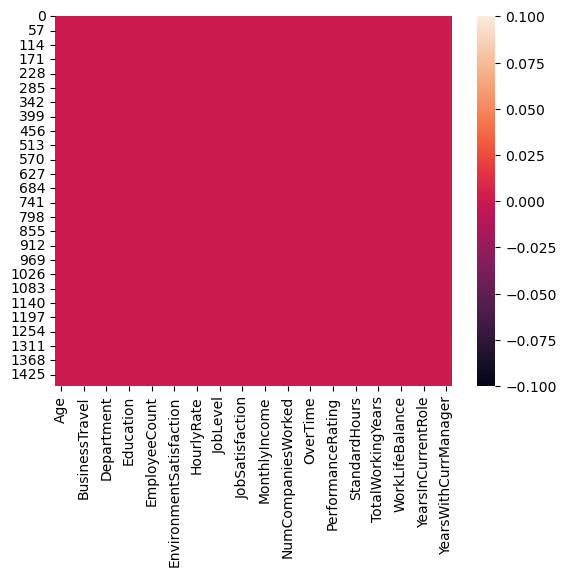

In [44]:
# Visualizing through heatmap:
sns.heatmap(dfhr.isnull())

In [45]:
dfhr.set_index("EmployeeNumber",inplace=True)
dfhr

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,2,...,1,80,0,8,0,1,6,4,0,5
2,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,3,...,4,80,1,10,3,3,10,7,1,7
4,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
5,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,4,...,3,80,0,8,3,3,8,7,3,0
7,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,1,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,3,...,3,80,1,17,3,3,5,2,0,3
2062,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,4,...,1,80,1,9,5,3,7,7,1,7
2064,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2,...,2,80,1,6,0,3,6,2,0,3


In [46]:
#separating numerical and categorical column:
categorical_col=[]
for i in dfhr.dtypes.index:
    if dfhr.dtypes[i]=="object":
        categorical_col.append(i)
print("categorical columns:",categorical_col)
print("\n")    

categorical columns: ['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'Over18', 'OverTime']




In [47]:
#numerical columns:
numerical_col=[]
for i in dfhr.dtypes.index:
    if dfhr.dtypes[i]!="object":
        numerical_col.append(i)
print("numerical columns:",numerical_col)        

numerical columns: ['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EmployeeCount', 'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']


In [48]:
dfhr.nunique()

Age                           43
Attrition                      2
BusinessTravel                 3
DailyRate                    886
Department                     3
DistanceFromHome              29
Education                      5
EducationField                 6
EmployeeCount                  1
EnvironmentSatisfaction        4
Gender                         2
HourlyRate                    71
JobInvolvement                 4
JobLevel                       5
JobRole                        9
JobSatisfaction                4
MaritalStatus                  3
MonthlyIncome               1349
MonthlyRate                 1427
NumCompaniesWorked            10
Over18                         1
OverTime                       2
PercentSalaryHike             15
PerformanceRating              2
RelationshipSatisfaction       4
StandardHours                  1
StockOptionLevel               4
TotalWorkingYears             40
TrainingTimesLastYear          7
WorkLifeBalance                4
YearsAtCom

In [49]:
dfhr['PerformanceRating'].value_counts()

3    1244
4     226
Name: PerformanceRating, dtype: int64

##### Here we can see the target Variable "Attrition" contains only 2 types of output.. 
###### so we can consider this model as binary classification problem

## Statistical Summery:


In [50]:
dfhr.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,2.721769,65.891156,2.729932,2.063946,2.728571,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,1.093082,20.329428,0.711561,1.106940,1.102846,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,30.000000,1.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,2.000000,48.000000,2.000000,1.000000,2.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,3.000000,66.000000,3.000000,2.000000,3.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,4.000000,83.750000,3.000000,3.000000,4.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,4.000000,100.000000,4.000000,5.000000,4.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


#### Observations:

1. Count of each colums is same, so there are no missing values
2. comparing the mean and meadian values we can check some features are positevely skewed and 
   some -vely skewed data present in the dataset
3. There is a markable difference between the 75% and the Max value, there are chances of Outliers present in the Dataset
4.Count of all the columns are same, so no null values present in the dataset

# Data Visualization

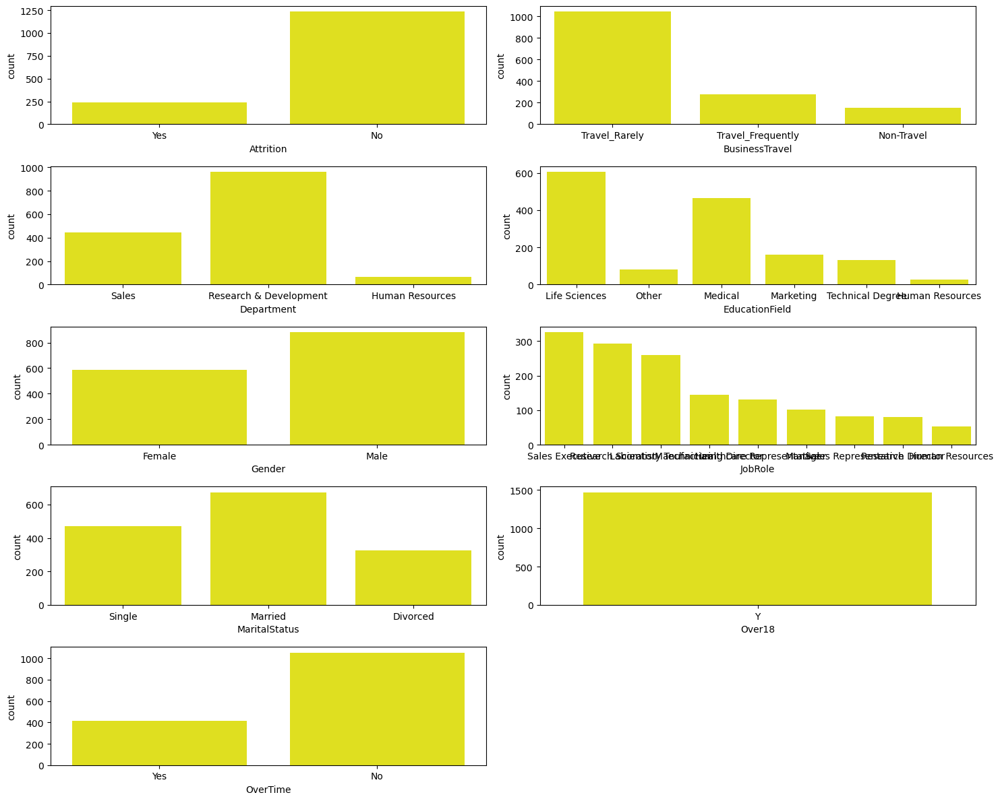

In [51]:
### Univariate Analysis:
plt.figure(figsize=(15,12),facecolor="white")
plotnumber=1
for i in categorical_col:
    if plotnumber<=10:
        p=plt.subplot(5,2,plotnumber)
        sns.countplot(dfhr[i],color="yellow")
        plt.xlabel(i,fontsize=10)
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()    
    
    

Observations:
1. "yes Attrition" rate is much lower than "No Attrtion".
2. In the company most of the employees travell rarely.
3. Number of Employees count is more in "Research and Developement Department", 
   in "HUman Resource" department least number of employee count.
4. The Age of all the employees in between 18 to 60 age group.
5. Most of the Employees are not preferring "Overtime"

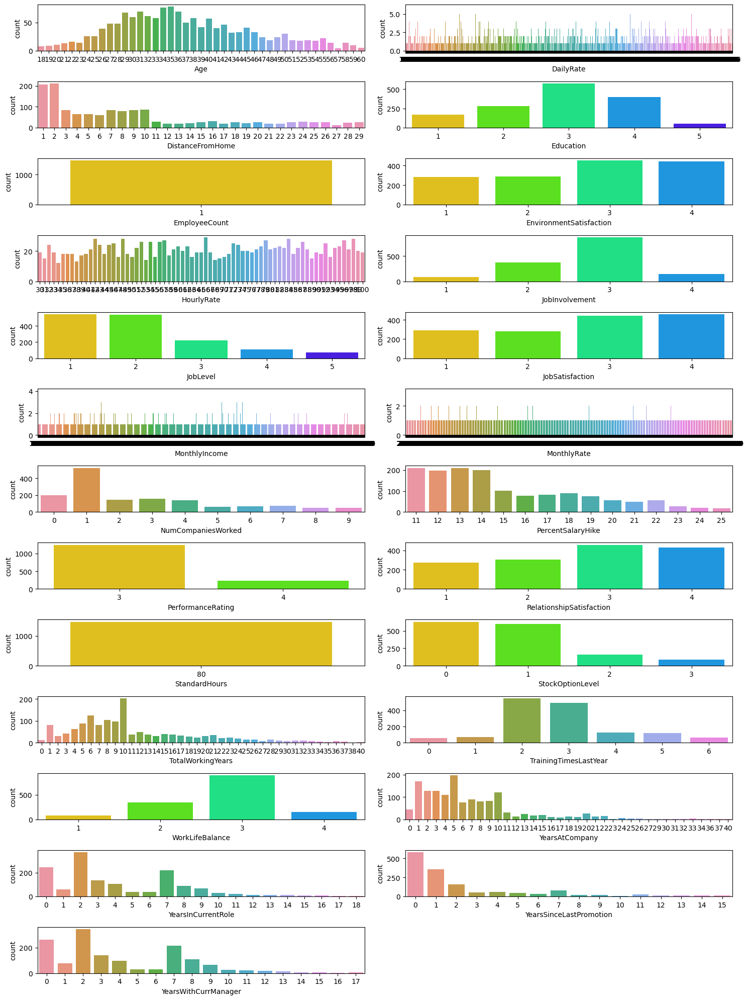

In [52]:
# visualization of data in numeric_columns:
sns.set_palette('hsv')
plt.figure(figsize=(15,20),facecolor="white")
plotnumber=1
for i in numerical_col:
    if plotnumber<=26:
        p=plt.subplot(13,2,plotnumber)
        sns.countplot(dfhr[i])
        plt.xlabel(i,fontsize=10)
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()    
    

### Bivariate Analysis:

In [53]:
dfhr.columns.tolist()

['Age',
 'Attrition',
 'BusinessTravel',
 'DailyRate',
 'Department',
 'DistanceFromHome',
 'Education',
 'EducationField',
 'EmployeeCount',
 'EnvironmentSatisfaction',
 'Gender',
 'HourlyRate',
 'JobInvolvement',
 'JobLevel',
 'JobRole',
 'JobSatisfaction',
 'MaritalStatus',
 'MonthlyIncome',
 'MonthlyRate',
 'NumCompaniesWorked',
 'Over18',
 'OverTime',
 'PercentSalaryHike',
 'PerformanceRating',
 'RelationshipSatisfaction',
 'StandardHours',
 'StockOptionLevel',
 'TotalWorkingYears',
 'TrainingTimesLastYear',
 'WorkLifeBalance',
 'YearsAtCompany',
 'YearsInCurrentRole',
 'YearsSinceLastPromotion',
 'YearsWithCurrManager']

<AxesSubplot:xlabel='Age', ylabel='count'>

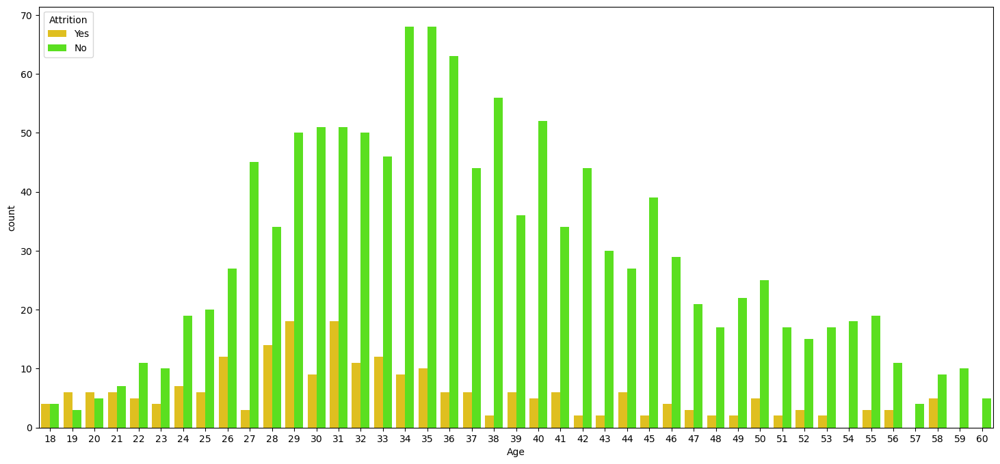

In [55]:
sns.set_palette('hsv')
plt.subplots(figsize=(18,8))
sns.countplot(x='Age', hue='Attrition', data=dfhr)

<AxesSubplot:xlabel='Department', ylabel='count'>

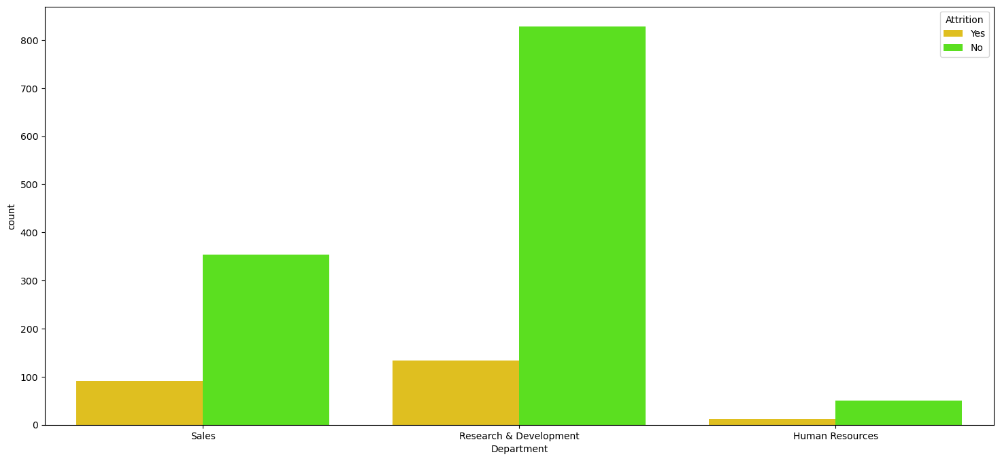

In [63]:
sns.set_palette('hsv')
plt.subplots(figsize=(18,8))
sns.countplot(x='Department', hue='Attrition', data=dfhr)

####  Observations:
1. Attrion in R&D department is high followed by Sale department. Hr department has very low Attrion rate

<AxesSubplot:xlabel='JobRole', ylabel='count'>

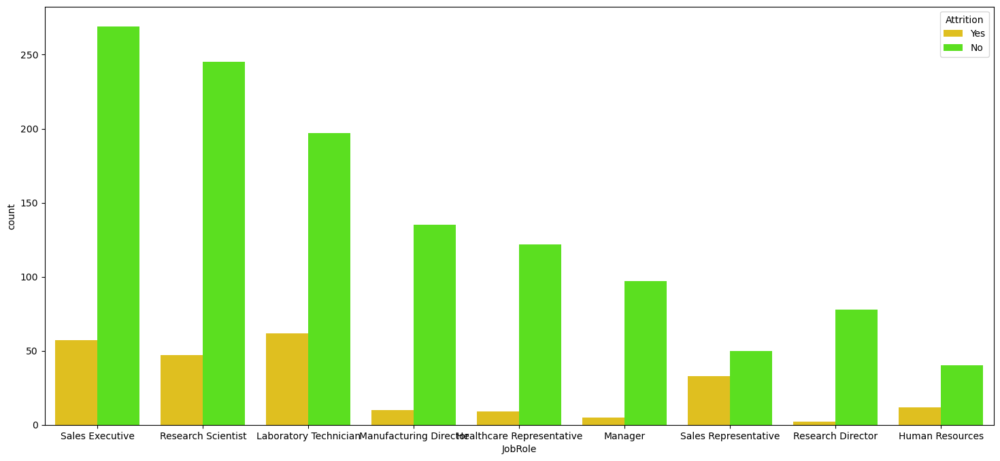

In [64]:
sns.set_palette('hsv')
plt.subplots(figsize=(18,8))
sns.countplot(x='JobRole', hue='Attrition', data=dfhr)

## observation:
1.Attrition in jobrole like "Sales Executive","Reserch Scientist","Laboratory technician" "Sales representative" are higher compared to other job roles

<AxesSubplot:xlabel='Education', ylabel='count'>

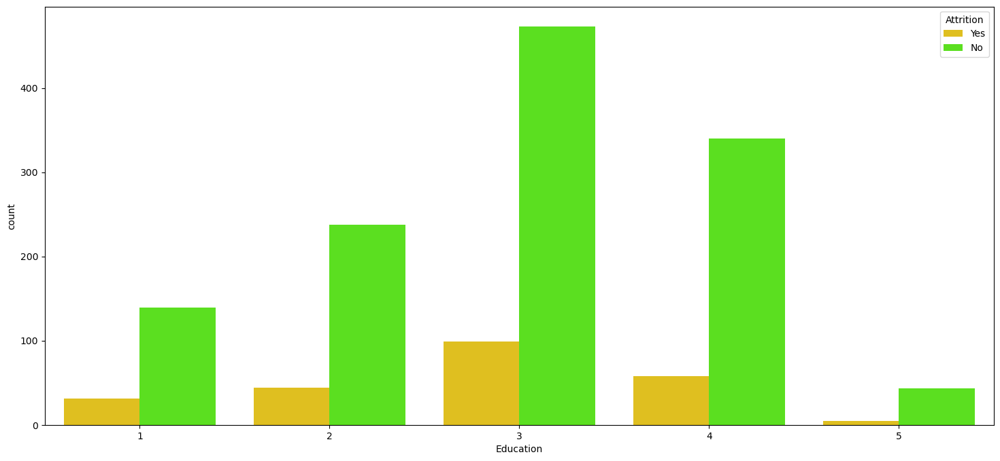

In [65]:
sns.set_palette('hsv')
plt.subplots(figsize=(18,8))
sns.countplot(x='Education', hue='Attrition', data=dfhr)

<AxesSubplot:xlabel='MaritalStatus', ylabel='count'>

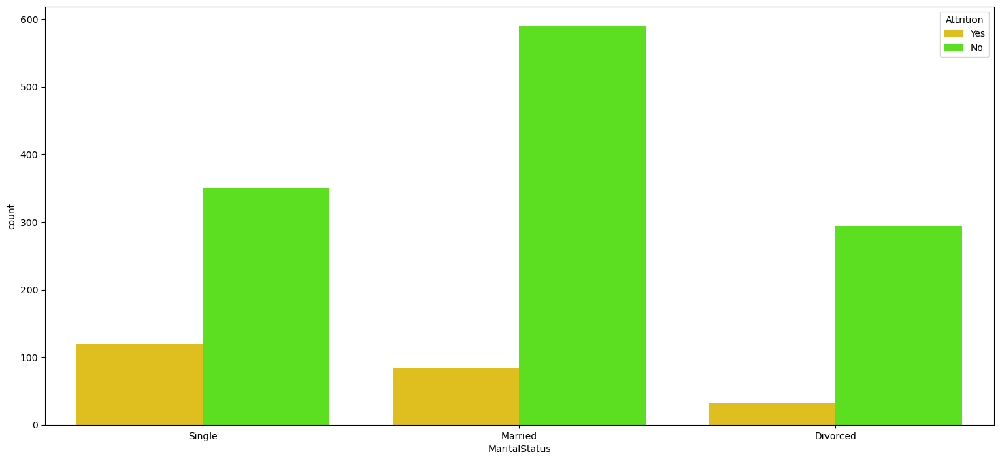

In [59]:
sns.set_palette('hsv')
plt.subplots(figsize=(18,8))
sns.countplot(x='MaritalStatus', hue='Attrition', data=dfhr)

## Observations:
1.ttrition is more in case of Marritial Staus-Single, Followed by Married Employees. in  Employees with "Divorced" Marrital status, Attrition is less

<AxesSubplot:xlabel='RelationshipSatisfaction', ylabel='count'>

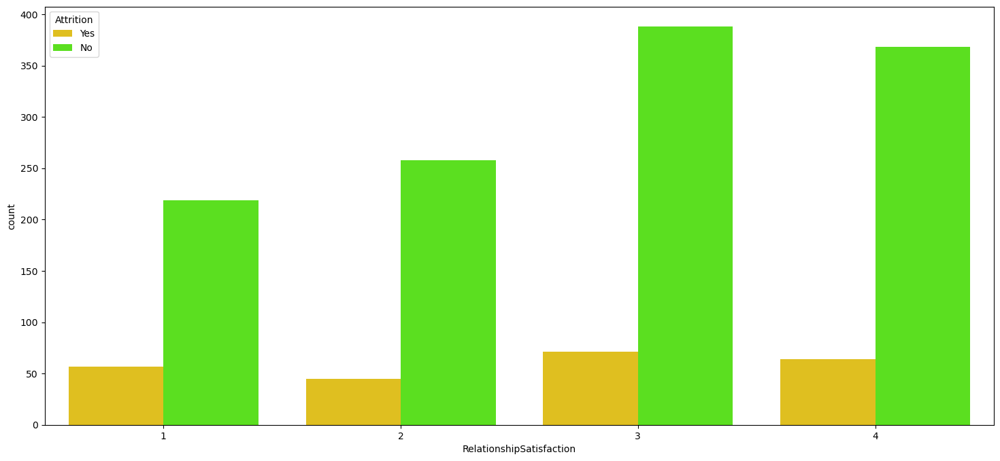

In [61]:
sns.set_palette('hsv')
plt.subplots(figsize=(18,8))
sns.countplot(x='RelationshipSatisfaction', hue='Attrition', data=dfhr)

## Observation:
From above we can see the "Relationship Satisfaction" factor is not impacting much toward "yes or No" Attrition".

<AxesSubplot:xlabel='PerformanceRating', ylabel='count'>

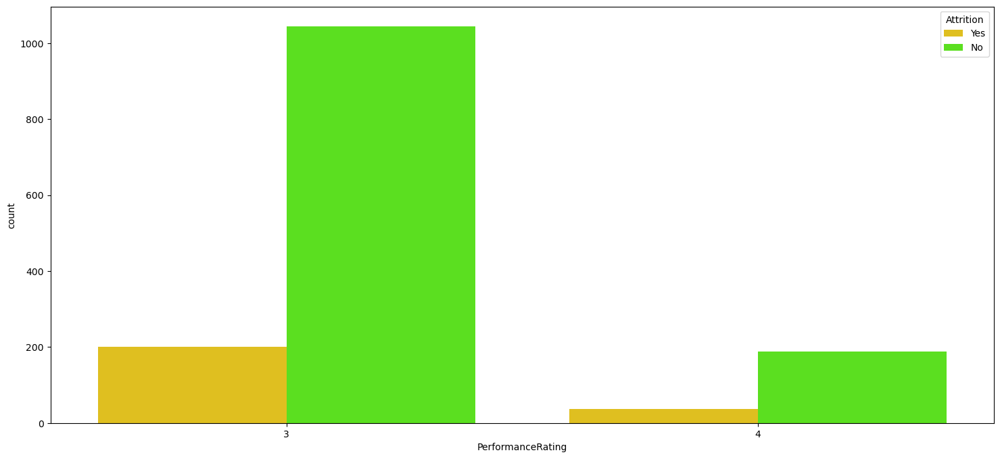

In [62]:
sns.set_palette('hsv')
plt.subplots(figsize=(18,8))
sns.countplot(x='PerformanceRating', hue='Attrition', data=dfhr)

# Observations:
1. Employees performance rate   "3" are more causing Attrition more... 

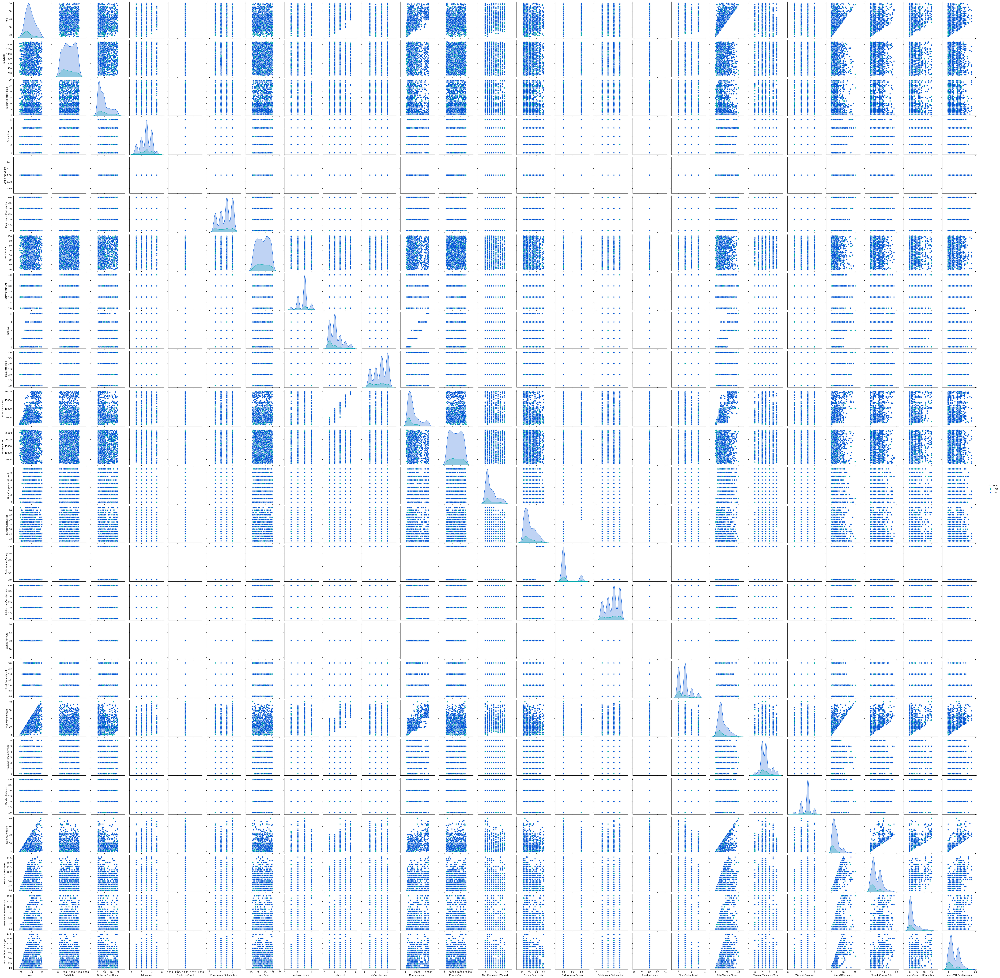

In [16]:
#### Multivariate Analysis:
sns.pairplot(dfhr,hue='Attrition',palette='winter_r')
plt.show()

In [518]:
# Encoding Categorical Columns:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in dfhr.columns:
    if dfhr[i].dtypes=="object":
        dfhr[i]=OE.fit_transform(dfhr[i].values.reshape(-1,1))    
dfhr       

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,1.0,2.0,1102,2.0,1,2,1.0,1,2,...,1,80,0,8,0,1,6,4,0,5
2,49,0.0,1.0,279,1.0,8,1,1.0,1,3,...,4,80,1,10,3,3,10,7,1,7
4,37,1.0,2.0,1373,1.0,2,2,4.0,1,4,...,2,80,0,7,3,3,0,0,0,0
5,33,0.0,1.0,1392,1.0,3,4,1.0,1,4,...,3,80,0,8,3,3,8,7,3,0
7,27,0.0,2.0,591,1.0,2,1,3.0,1,1,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,0.0,1.0,884,1.0,23,2,3.0,1,3,...,3,80,1,17,3,3,5,2,0,3
2062,39,0.0,2.0,613,1.0,6,1,3.0,1,4,...,1,80,1,9,5,3,7,7,1,7
2064,27,0.0,2.0,155,1.0,4,3,1.0,1,2,...,2,80,1,6,0,3,6,2,0,3


### Outlier Detection:

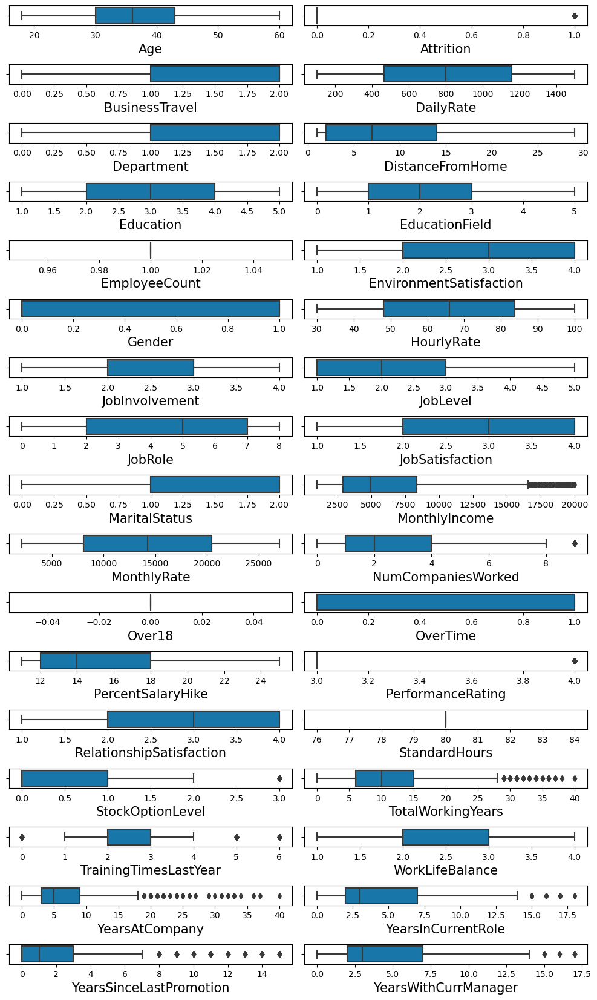

In [519]:
# checking for outliers
plt.figure(figsize=(10,20),facecolor="white")
plotnum=1
for i in dfhr.columns:
    if plotnum<=42:
        p=plt.subplot(21,2,plotnum)
        sns.boxplot(dfhr[i],palette='winter_r')
        plt.xlabel(i,fontsize=15)
        plt.yticks(rotation=0,fontsize=10)
        plotnum+=1
plt.tight_layout()    

# Outlier Detection:

In [520]:
#removing outliers:
#z-score method:
from scipy.stats import zscore
out_features=dfhr[['MonthlyIncome','NumCompaniesWorked','PerformanceRating','StockOptionLevel','TotalWorkingYears','YearsAtCompany','TrainingTimesLastYear','YearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager']]
z=np.abs(zscore(out_features))
z

,MonthlyIncome,NumCompaniesWorked,PerformanceRating,StockOptionLevel,TotalWorkingYears,YearsAtCompany,TrainingTimesLastYear,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
EmployeeNumber,,,,,,,,,,
1,0.108350,2.125136,0.426230,0.932014,0.421642,0.164613,2.171982,0.063296,0.679146,0.245834
2,0.291719,0.678049,2.346151,0.241988,0.164511,0.488508,0.155707,0.764998,0.368715,0.806541
4,0.937654,1.324226,0.426230,0.932014,0.550208,1.144294,0.155707,1.167687,0.679146,1.155935
5,0.763634,0.678049,0.426230,0.932014,0.421642,0.161947,0.155707,0.764998,0.252146,1.155935
7,0.644858,2.525591,0.426230,0.241988,0.678774,0.817734,0.155707,0.615492,0.058285,0.595227
...,...,...,...,...,...,...,...,...,...,...
2061,0.835451,0.523316,0.426230,0.241988,0.735447,0.327893,0.155707,0.615492,0.679146,0.314873
2062,0.741140,0.523316,0.426230,0.241988,0.293077,0.001333,1.707500,0.764998,0.368715,0.806541
2064,0.076690,0.678049,2.346151,0.241988,0.678774,0.164613,2.171982,0.615492,0.679146,0.314873


In [521]:
#threshold=3
np.where(z>3)

(array([  28,   45,   62,   62,   63,   64,   85,   98,   98,  110,  123,
         123,  123,  126,  126,  126,  153,  178,  187,  187,  190,  190,
         218,  231,  231,  237,  237,  270,  270,  281,  326,  386,  386,
         401,  411,  425,  425,  427,  445,  466,  473,  477,  535,  561,
         561,  584,  592,  595,  595,  595,  616,  624,  635,  653,  653,
         677,  686,  701,  716,  746,  749,  752,  799,  838,  861,  861,
         875,  875,  894,  914,  914,  918,  922,  926,  926,  937,  956,
         962,  976,  976, 1008, 1024, 1043, 1078, 1078, 1086, 1086, 1093,
        1111, 1116, 1116, 1135, 1138, 1138, 1156, 1184, 1221, 1223, 1242,
        1295, 1301, 1301, 1303, 1327, 1331, 1348, 1351, 1401, 1414, 1430],
       dtype=int64),
 array([9, 8, 5, 8, 7, 8, 4, 4, 5, 8, 7, 8, 9, 4, 5, 8, 9, 8, 4, 9, 5, 7,
        8, 7, 9, 5, 8, 4, 5, 7, 8, 8, 9, 4, 5, 5, 8, 8, 4, 7, 5, 5, 8, 5,
        9, 8, 5, 4, 5, 8, 9, 4, 9, 5, 8, 5, 9, 8, 7, 7, 5, 8, 8, 8, 5, 8,
        8, 9, 4,

In [522]:
# we have to removethese rows which have outliers:
dfhr1=dfhr[(z<3).all(axis=1)]
dfhr1.shape          # after removing outliers the data frame size

(1387, 34)

In [523]:
#originaldata frame size
dfhr.shape

(1470, 34)

In [524]:
#data loss percentage:
print("data loss percentage",((dfhr.shape[0]-dfhr1.shape[0])/dfhr.shape[0])*100)

data loss percentage 5.646258503401361


###### The Data loss percentage is afforable.. so we can proceed with it.

In [525]:
#checking for skewness present in the data:
dfhr1.skew()

Age                         0.472280
Attrition                   1.805983
BusinessTravel             -1.426774
DailyRate                  -0.017078
Department                  0.183919
DistanceFromHome            0.954752
Education                  -0.289024
EducationField              0.544868
EmployeeCount               0.000000
EnvironmentSatisfaction    -0.325285
Gender                     -0.417296
HourlyRate                 -0.030481
JobInvolvement             -0.501401
JobLevel                    1.126075
JobRole                    -0.386843
JobSatisfaction            -0.345612
MaritalStatus              -0.160952
MonthlyIncome               1.544770
MonthlyRate                 0.030596
NumCompaniesWorked          1.037715
Over18                      0.000000
OverTime                    0.954751
PercentSalaryHike           0.800592
PerformanceRating           1.931566
RelationshipSatisfaction   -0.295686
StandardHours               0.000000
StockOptionLevel            0.962332
T

In [526]:
dfhr1['JobLevel']=np.cbrt(dfhr1['JobLevel'])
dfhr1['MonthlyIncome']=np.cbrt(dfhr1['MonthlyIncome'])
dfhr1['NumCompaniesWorked']=np.cbrt(dfhr1['NumCompaniesWorked'])
dfhr1['PerformanceRating']=np.cbrt(dfhr1['PerformanceRating'])
dfhr1['TotalWorkingYears']=np.cbrt(dfhr1['TotalWorkingYears'])
dfhr1['YearsAtCompany']=np.cbrt(dfhr1['YearsAtCompany'])
dfhr1['YearsSinceLastPromotion']=np.cbrt(dfhr1['YearsSinceLastPromotion'])


In [527]:
dfhr1.skew()

Age                         0.472280
Attrition                   1.805983
BusinessTravel             -1.426774
DailyRate                  -0.017078
Department                  0.183919
DistanceFromHome            0.954752
Education                  -0.289024
EducationField              0.544868
EmployeeCount               0.000000
EnvironmentSatisfaction    -0.325285
Gender                     -0.417296
HourlyRate                 -0.030481
JobInvolvement             -0.501401
JobLevel                    0.508238
JobRole                    -0.386843
JobSatisfaction            -0.345612
MaritalStatus              -0.160952
MonthlyIncome               0.742985
MonthlyRate                 0.030596
NumCompaniesWorked         -0.689329
Over18                      0.000000
OverTime                    0.954751
PercentSalaryHike           0.800592
PerformanceRating           1.931566
RelationshipSatisfaction   -0.295686
StandardHours               0.000000
StockOptionLevel            0.962332
T

### Correlation Martix:

In [528]:
corr=dfhr1.corr()
corr

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,-0.159366,0.022340,0.021946,-0.038242,-0.011265,0.198502,-0.032676,NaN,0.014098,...,0.041744,NaN,0.054506,0.627064,-0.019008,-0.016913,0.177960,0.121508,0.101450,0.121747
Attrition,-0.159366,1.000000,-0.001041,-0.057220,0.063637,0.081788,-0.032703,0.023585,NaN,-0.112393,...,-0.052344,NaN,-0.136676,-0.228715,-0.057285,-0.062492,-0.203407,-0.171015,-0.052245,-0.162297
BusinessTravel,0.022340,-0.001041,1.000000,-0.004606,-0.003521,-0.032873,-0.010560,0.022576,NaN,0.001183,...,-0.029660,NaN,-0.015159,0.042392,0.010322,-0.014140,-0.008602,-0.029257,-0.027602,-0.044321
DailyRate,0.021946,-0.057220,-0.004606,1.000000,-0.005398,-0.008171,-0.018442,0.040645,NaN,0.033123,...,0.004516,NaN,0.048361,0.044422,0.005861,-0.044266,0.009147,0.022899,-0.037737,-0.011516
Department,-0.038242,0.063637,-0.003521,-0.005398,1.000000,0.023919,0.012846,0.013432,NaN,-0.014540,...,-0.037705,NaN,-0.003424,-0.007723,0.036092,0.026978,0.013848,0.065536,0.017221,0.034216
DistanceFromHome,-0.011265,0.081788,-0.032873,-0.008171,0.023919,1.000000,0.001084,0.005882,NaN,-0.019279,...,0.007885,NaN,0.049976,0.014243,-0.034386,-0.034398,0.017898,0.019039,0.007982,-0.000221
Education,0.198502,-0.032703,-0.010560,-0.018442,0.012846,0.001084,1.000000,-0.038017,NaN,-0.026223,...,-0.002393,NaN,0.028494,0.155944,-0.026879,0.007844,0.036109,0.058007,0.014855,0.031210
EducationField,-0.032676,0.023585,0.022576,0.040645,0.013432,0.005882,-0.038017,1.000000,NaN,0.047924,...,-0.013734,NaN,-0.015355,-0.004469,0.050502,0.034038,0.001351,-0.010614,0.021206,0.013437
EmployeeCount,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EnvironmentSatisfaction,0.014098,-0.112393,0.001183,0.033123,-0.014540,-0.019279,-0.026223,0.047924,NaN,1.000000,...,0.018414,NaN,0.013330,-0.018817,-0.019318,0.032492,0.010151,0.038837,0.041294,0.001606


In [529]:
dfhr1.drop(['Over18','StandardHours','EmployeeCount'],axis=1,inplace=True)
dfhr1

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,1.0,2.0,1102,2.0,1,2,1.0,2,0.0,...,1.442250,1,0,2.000000,0,1,1.817121,4,0.000000,5
2,49,0.0,1.0,279,1.0,8,1,1.0,3,1.0,...,1.587401,4,1,2.154435,3,3,2.154435,7,1.000000,7
4,37,1.0,2.0,1373,1.0,2,2,4.0,4,1.0,...,1.442250,2,0,1.912931,3,3,0.000000,0,0.000000,0
5,33,0.0,1.0,1392,1.0,3,4,1.0,4,0.0,...,1.442250,3,0,2.000000,3,3,2.000000,7,1.442250,0
7,27,0.0,2.0,591,1.0,2,1,3.0,1,1.0,...,1.442250,4,1,1.817121,3,3,1.259921,2,1.259921,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,0.0,1.0,884,1.0,23,2,3.0,3,1.0,...,1.442250,3,1,2.571282,3,3,1.709976,2,0.000000,3
2062,39,0.0,2.0,613,1.0,6,1,3.0,4,1.0,...,1.442250,1,1,2.080084,5,3,1.912931,7,1.000000,7
2064,27,0.0,2.0,155,1.0,4,3,1.0,2,1.0,...,1.587401,2,1,1.817121,0,3,1.817121,2,0.000000,3


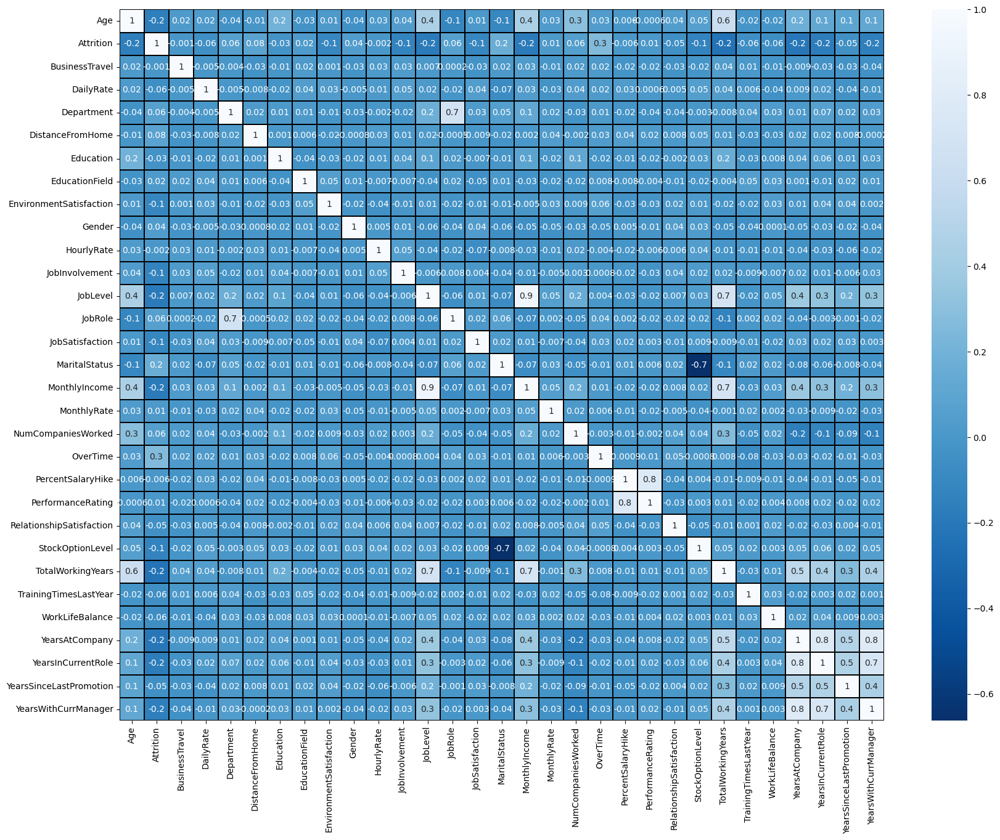

In [530]:
#visualizing the corelation matrix by using the heaatmap
plt.figure(figsize=(20,15))
sns.heatmap(dfhr1.corr(),linewidth=0.1,fmt='0.1g',linecolor="black",annot=True,cmap="Blues_r")
plt.yticks(rotation=0);
plt.show()

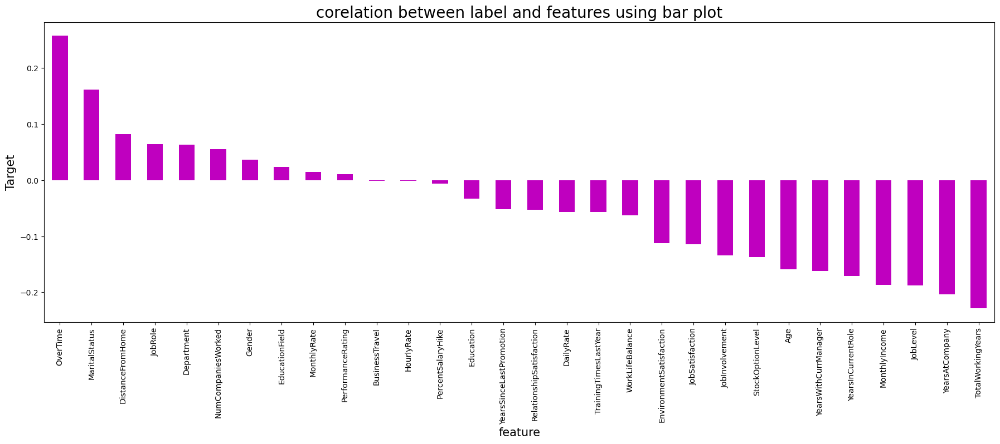

In [531]:
 #visualizing the corelation using barplot:
plt.figure(figsize=(22,7))
dfhr1.corr()['Attrition'].sort_values(ascending=False).drop(['Attrition']).plot(kind='bar',color="m")
plt.xlabel('feature',fontsize=15)
plt.ylabel('Target',fontsize=15)
plt.title("corelation between label and features using bar plot",fontsize=20)
plt.show()


In [532]:
# Variance Inflation Factor to check  multicolinearity:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif1= pd.DataFrame()
vif1['VIF']= [variance_inflation_factor(dfhr1.values,i) for i in range(dfhr1.shape[1])]
vif1['Features']= dfhr1.columns
vif1

,VIF,Features
0,32.906919,Age
1,1.566943,Attrition
2,6.885133,BusinessTravel
3,5.116784,DailyRate
4,14.187735,Department
5,2.347714,DistanceFromHome
6,9.509045,Education
7,3.928210,EducationField
8,7.553290,EnvironmentSatisfaction
9,2.573004,Gender


In [533]:
#separating target variable and input variable

x=dfhr1.drop('Attrition',axis=1)
y=dfhr1['Attrition']

In [534]:
# feature scaling using standard scalarization

from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,0.536681,0.593126,0.734325,1.405373,-1.011249,-0.876177,-0.940815,-0.665328,-1.229911,1.388670,...,-0.424765,-1.575817,-0.929427,-0.114048,-2.171420,-2.501172,0.252482,0.040903,-1.092503,0.368270
1,1.442111,-0.905354,-1.307769,-0.496337,-0.145521,-1.853858,-0.940815,0.251978,0.813067,-0.239091,...,2.354241,1.199034,0.238250,0.184647,0.151871,0.336558,0.878987,0.965895,0.294582,0.982200
2,0.083966,0.593126,1.406752,-0.496337,-0.887573,-0.876177,1.305159,1.169285,0.813067,1.290017,...,-0.424765,-0.650866,-0.929427,-0.282450,0.151871,0.336558,-3.122519,-1.192419,-1.092503,-1.166556
3,-0.368749,-0.905354,1.453896,-0.496337,-0.763898,1.079185,-0.940815,1.169285,-1.229911,-0.485721,...,-0.424765,0.274084,-0.929427,-0.114048,0.151871,0.336558,0.592150,0.965895,0.908019,-1.166556
4,-1.047821,0.593126,-0.533609,-0.496337,-0.887573,-1.853858,0.556501,-1.582635,0.813067,-1.274939,...,-0.424765,1.199034,0.238250,-0.467759,0.151871,0.336558,-0.782424,-0.575758,0.655114,-0.552626
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1382,-0.029213,-0.905354,0.193406,-0.496337,1.709609,-0.876177,0.556501,0.251978,0.813067,-1.225613,...,-0.424765,0.274084,0.238250,0.990880,0.151871,0.336558,0.053478,-0.575758,-1.092503,-0.245661
1383,0.310324,0.593126,-0.479021,-0.496337,-0.392872,-1.853858,0.556501,1.169285,0.813067,-1.176286,...,-0.424765,-1.575817,0.238250,0.040844,1.700732,0.336558,0.430434,0.965895,0.294582,0.982200
1384,-1.047821,0.593126,-1.615447,-0.496337,-0.640223,0.101504,-0.940815,-0.665328,0.813067,1.043387,...,2.354241,-0.650866,0.238250,-0.467759,-2.171420,0.336558,0.252482,-0.575758,-1.092503,-0.245661
1385,1.442111,-0.905354,0.538304,1.405373,-0.887573,0.101504,0.556501,1.169285,0.813067,-0.140439,...,-0.424765,1.199034,-0.929427,0.990880,0.151871,-1.082307,0.740892,0.657565,-1.092503,1.289165


In [535]:
y.value_counts()

0.0    1158
1.0     229
Name: Attrition, dtype: int64

In [348]:
!pip install -U imbalanced-learn

Defaulting to user installation because normal site-packages is not writeable


In [536]:
# to balance the target variable data over sampling is performed:
from imblearn.over_sampling import SMOTE
sm=SMOTE()
x1,y1=sm.fit_resample(x,y)

In [537]:
y1.value_counts()

1.0    1158
0.0    1158
Name: Attrition, dtype: int64

## modeling

from the target variable we can observe that the given problem statement is a binary classification problem.. so we can apply Naive Bayes classifier, logistic regression knn descission tree.. 

In [538]:
#finding the best random state:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
from sklearn.model_selection import cross_val_score


In [539]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score
maxAcc=0
maxRs=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x1,y1,test_size=.25,random_state=i)
    LR=LogisticRegression()
    LR.fit(x_train,y_train)
    pred=LR.predict(x_test)
    acc=accuracy_score(y_test,pred)
    if acc> maxAcc:
        maxAcc=acc
        maxRs=i
print("maximum acc_score is",maxAcc, "on random_state",maxRs)        

maximum acc_score is 0.8221070811744386 on random_state 150


In [540]:
# creating train test split:
x_train,x_test,y_train,y_test=train_test_split(x1,y1,test_size=0.25,random_state=maxRs)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(1737, 30)
(1737,)
(579, 30)
(579,)


In [541]:
#Logistic regression model:
logR=LogisticRegression()
logR.fit(x_train,y_train)
pred_train=logR.predict(x_train)
pred_Lgr=logR.predict(x_test)
print("predicted accuracy",accuracy_score(y_test,pred_Lgr))
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(confusion_matrix(y_test,pred_Lgr))
print(classification_report(y_test,pred_Lgr))


predicted accuracy 0.8221070811744386
accuracy score of original y_test data 0.7875647668393783
[[232  64]
 [ 39 244]]
              precision    recall  f1-score   support

         0.0       0.86      0.78      0.82       296
         1.0       0.79      0.86      0.83       283

    accuracy                           0.82       579
   macro avg       0.82      0.82      0.82       579
weighted avg       0.82      0.82      0.82       579



In [542]:
#DecissionTreeClassifier:
from sklearn.tree import DecisionTreeClassifier
dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
pred_dtc=dtc.predict(x_test)
pred_train=dtc.predict(x_train)
print("accuracy score of original y_test data",accuracy_score(y_train,pred_train))
print(accuracy_score(y_test,pred_dtc))
print(confusion_matrix(y_test,pred_dtc))
print(classification_report(y_test,pred_dtc))

accuracy score of original y_test data 1.0
0.8618307426597582
[[245  51]
 [ 29 254]]
              precision    recall  f1-score   support

         0.0       0.89      0.83      0.86       296
         1.0       0.83      0.90      0.86       283

    accuracy                           0.86       579
   macro avg       0.86      0.86      0.86       579
weighted avg       0.86      0.86      0.86       579



In [543]:
#RandomForestClassifier:
RFC=RandomForestClassifier()
RFC.fit(x_train,y_train)
pred_RFC=RFC.predict(x_test)
print(accuracy_score(y_test,pred_RFC))
print(confusion_matrix(y_test,pred_RFC))
print(classification_report(y_test,pred_RFC))


0.9430051813471503
[[282  14]
 [ 19 264]]
              precision    recall  f1-score   support

         0.0       0.94      0.95      0.94       296
         1.0       0.95      0.93      0.94       283

    accuracy                           0.94       579
   macro avg       0.94      0.94      0.94       579
weighted avg       0.94      0.94      0.94       579



In [544]:
#KNeighborsClassifier:
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
print(accuracy_score(y_test,pred_knn))
print(confusion_matrix(y_test,pred_knn))
print(classification_report(y_test,pred_knn))


0.7823834196891192
[[171 125]
 [  1 282]]
              precision    recall  f1-score   support

         0.0       0.99      0.58      0.73       296
         1.0       0.69      1.00      0.82       283

    accuracy                           0.78       579
   macro avg       0.84      0.79      0.77       579
weighted avg       0.85      0.78      0.77       579



In [545]:
#GaussianNB:
gnb = GaussianNB()
gnb.fit(x_train,y_train)
pred_gnb=gnb.predict(x_test)
print(accuracy_score(y_test,pred_gnb))
print(confusion_matrix(y_test,pred_gnb))
print(classification_report(y_test,pred_gnb))


0.7288428324697754
[[202  94]
 [ 63 220]]
              precision    recall  f1-score   support

         0.0       0.76      0.68      0.72       296
         1.0       0.70      0.78      0.74       283

    accuracy                           0.73       579
   macro avg       0.73      0.73      0.73       579
weighted avg       0.73      0.73      0.73       579



## Cross Validating the Models:


In [546]:
score_LR=cross_val_score(logR,x1,y1)             # cross validation score for logistic regression
print(score_LR)
print(score_LR.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_Lgr)-(score_LR.mean()))

[0.7737069  0.77321814 0.77969762 0.77537797 0.81425486]
0.7832510985328069
diff b/w accuracy score and cross validation score is: 0.0388559826416317


In [547]:
score_dtc=cross_val_score(dtc,x1,y1)           #cross validation score of dtc
print(score_dtc)
print(score_dtc.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_dtc)-(score_dtc.mean()))

[0.71982759 0.8812095  0.86393089 0.89416847 0.91144708]
0.854116705146347
diff b/w accuracy score and cross validation score is: 0.007714037513411265


In [548]:
score_RFC=cross_val_score(RFC,x1,y1)                           #cross validation score of RandomForest
print(score_RFC)
print(score_RFC.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_RFC)-(score_RFC.mean()))

[0.76508621 0.96544276 0.96760259 0.96976242 0.97408207]
0.9283952111417294
diff b/w accuracy score and cross validation score is: 0.014609970205420875


In [549]:
score_knn=cross_val_score(knn,x1,y1)                           #cross validation score of knn
print(score_knn)
print(score_knn.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_knn)-(score_knn.mean()))

[0.77155172 0.82721382 0.80345572 0.78401728 0.78833693]
0.7949150964474565
diff b/w accuracy score and cross validation score is: -0.012531676758337329


In [550]:
score_gnb=cross_val_score(gnb,x1,y1)                           #cross validation score of GaussianNB
print(score_gnb)
print(score_gnb.mean())
print("diff b/w accuracy score and cross validation score is:",accuracy_score(y_test,pred_gnb)-(score_gnb.mean()))

[0.67456897 0.73650108 0.71274298 0.72354212 0.7300216 ]
0.7154753481790422
diff b/w accuracy score and cross validation score is: 0.0133674842907332


######  By varifying the accuracy score and the Cross validation score we can conclude that the RandomForest Classifier model gived pest performance for the given problem statement for HR Attrition data prediction

# HyperParameter Tuning For Random Forest Classifier:


In [483]:
from sklearn.model_selection import GridSearchCV

In [484]:
parameter = {  'bootstrap': [True], 'max_depth': [5, 10,20,40,50, None], 
              'max_features': ['auto', 'log2'], 
              'criterion':['gini','entropy'],
              'n_estimators': [5, 10, 15 ,25,50,100]}

In [551]:
GCV = GridSearchCV(RandomForestClassifier(),parameter,cv=5,n_jobs = -1,verbose=3)
GCV.fit(x_train,y_train)

Fitting 5 folds for each of 144 candidates, totalling 720 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'bootstrap': [True], 'criterion': ['gini', 'entropy'],
                         'max_depth': [5, 10, 20, 40, 50, None],
                         'max_features': ['auto', 'log2'],
                         'n_estimators': [5, 10, 15, 25, 50, 100]},
             verbose=3)

In [552]:
GCV.best_params_

{'bootstrap': True,
 'criterion': 'entropy',
 'max_depth': None,
 'max_features': 'log2',
 'n_estimators': 100}

In [553]:
modelHR=RandomForestClassifier(bootstrap=True,criterion='entropy', max_depth= None, max_features='log2',n_estimators= 100)

# Final Model

In [554]:
#  Final Model:
modelHR.fit(x_train,y_train)
pred=modelHR.predict(x_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

93.95509499136442


### The final Model is Providing 93.26% accuracy

In [555]:
import joblib
joblib.dump(modelHR,'HR Attrition Analysis')


['HR Attrition Analysis']

In [556]:
RFC_HR=joblib.load('HR Attrition Analysis')
predictionM=RFC_HR.predict(x_test)
predictionM

array([1., 0., 0., 1., 1., 1., 0., 0., 0., 1., 1., 1., 0., 1., 0., 1., 0.,
       0., 0., 0., 1., 1., 0., 0., 1., 1., 0., 0., 0., 1., 0., 0., 1., 1.,
       0., 0., 0., 0., 1., 0., 0., 1., 0., 1., 1., 0., 0., 0., 1., 0., 0.,
       1., 0., 1., 0., 0., 0., 0., 1., 1., 0., 1., 1., 1., 0., 0., 1., 0.,
       1., 0., 0., 0., 0., 1., 1., 0., 1., 0., 0., 1., 1., 0., 0., 1., 0.,
       0., 1., 1., 1., 0., 0., 1., 1., 0., 1., 1., 1., 1., 1., 1., 0., 1.,
       0., 1., 1., 0., 1., 0., 0., 1., 0., 0., 0., 0., 1., 1., 1., 1., 0.,
       0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 0., 1., 1.,
       0., 1., 0., 0., 0., 0., 0., 1., 1., 0., 1., 1., 0., 1., 0., 0., 1.,
       0., 0., 1., 1., 1., 1., 1., 0., 0., 1., 1., 0., 1., 0., 0., 0., 1.,
       0., 1., 0., 0., 0., 0., 0., 1., 1., 0., 0., 1., 1., 1., 0., 0., 1.,
       0., 1., 1., 0., 0., 0., 1., 0., 1., 1., 1., 1., 0., 0., 1., 1., 1.,
       0., 1., 0., 1., 1., 0., 0., 0., 1., 1., 1., 0., 0., 0., 0., 1., 0.,
       0., 1., 1., 0., 1.

In [557]:
a=np.array(y_test)
DF_Attrition=pd.DataFrame()
DF_Attrition['predicted']=predictionM
DF_Attrition['original']=a
DF_Attrition

,predicted,original
0,1.0,1.0
1,0.0,0.0
2,0.0,0.0
3,1.0,1.0
4,1.0,1.0
...,...,...
574,0.0,0.0
575,1.0,1.0
576,1.0,1.0
577,0.0,0.0
